# Imports

In [2]:
import os
import glob
import shutil
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import json
import librosa
import librosa.display
import h5py
from sklearn.model_selection import train_test_split
from keras.models import Sequential
from keras.layers import (
    Dense,
    Flatten,
    Dropout,
    Conv2D,
    MaxPooling2D,
    BatchNormalization,
    GlobalAveragePooling2D,
)
from keras.regularizers import l2
from keras.utils import to_categorical
from tensorflow.keras import callbacks
from scikeras.wrappers import KerasClassifier
from sklearn.model_selection import GridSearchCV
from keras.models import load_model
import IPython.display as ipd

In [3]:
# %conda install -c conda-forge librosa
# %conda install -c conda-forge libsndfile
# % conda install -c conda-forge pytables
%pip show librosa

Name: librosa
Version: 0.10.1
Summary: Python module for audio and music processing
Home-page: https://librosa.org
Author: Brian McFee, librosa development team
Author-email: brian.mcfee@nyu.edu
License: ISC
Location: c:\users\kynes\appdata\roaming\python\python310\site-packages
Requires: audioread, decorator, joblib, lazy-loader, msgpack, numba, numpy, pooch, scikit-learn, scipy, soundfile, soxr, typing-extensions
Required-by: 
Note: you may need to restart the kernel to use updated packages.


In [4]:
from fonctions_rol import *

In [5]:
import jupyter_black
jupyter_black.load()

# Enoncé
Vous devez télécharger et utiliser le jeu de données suivant : UrbanSound8K.tar.gz (source : UrbanSound8K).  
https://ionissupinfo.sharepoint.com/sites/Resources/5DEEP/UrbanSound8K.tar.gz  
Il s'agit d'un problème de classification de sons avec 10 classes :   

    Air Conditioner
    Car Horn
    Children Playing
    Dog bark
    Drilling
    Engine Idling
    Gun shot
    Jackhammer
    Siren
    Street Music

Vous devrez développer "from scratch" vos propres réseaux de neurones pour résoudre ce problème.

Ce projet vous demandera des recherches personnelles sur diverses notions théoriques relatives aux traitement des sons.

Votre rendu se fera sous la forme d'un archive au format .zip contenant un notebook Jupyter (code source et export au format PDF ou HTML) ainsi qu'une sauvegarde de votre modèle final.

Toutes les étapes de votre projet devront être commentées et justifiées. Tous les résultats devront être interprétés. La qualité de la rédaction (style, grammaire et orthographe) sera prise en compte. Un rendu professionnel est attendu.

L'usage de Python et de la librairie Keras est obligatoire. On devra également utiliser une librairie de traitement des sons. Il est recommandé d'utiliser librosa pour cela.

    Explorer l'ensemble des données. On lira en particulier le fichier “README“ et on consultera le lien figurant au début de ce sujet.
    Installer la librairie librosa et étudier ses principales fonctionnalités.
    Se documenter sur le format WAV et sur ses en-têtes de fichier.
    Définir les termes suivants pour un son : fréquence, amplitude, nombre de canaux, fréquence d'échantillonnage.
    Choisir un échantillon de quelques sons de chaque classe et représenter chacun d'eux sous la forme d'un graphique avec le temps en abscisse et l'amplitude en ordonnée. Commenter les résultats obtenus. Se demander en particulier s'il y a une différence notable entre les classes. Ce genre de modélisation est-il suffisant pour résoudre notre problème ?
    Calculer le nombre de sons dans chaque classe. Le dataset est-il équilibré ?
    Etudier la distribution du nombre de canaux de chaque son.
    Etudier la distribution de la fréquence d'échantillonnage de chaque son.
    Il convient de normaliser les variables étudiées aux deux questions précédentes. Comment la librairie librosa va-t-elle régler ce problème ?
    Etudier les concepts théoriques de “Mel-spectogram“ et “Mel-frequency cepstral coefficients“. Une présentation détaillée et précise est attendue (s'approprier les concepts et ne pas céder au c/c).
    Construire un dataframe panda qui contiendra les MFCCs et les labels de chaque son.
    Séparer les données en un jeu d'entraînement/validation et un jeu de test.
    Construire un premier réseau de neurones complètement connecté pour résoudre ce problème de classification.
    Entraîner le modèle construit à la question 13 et mesurer sa performance.
    Construire maintenant un réseau de neurones convolutif pour résoudre ce problème de classification. Il devra contenir au minimum les éléments suivants : couches de convolution, couche de "pooling", "dropout", couches cachées complètement connectées. Vous êtes libres d'ajouter d'autres éléments. Attention au format des données en entrée.
    Entraîner le modèle construit à la question 15 et mesurer sa performance.
    Répéter les étapes 15 et 16 avec différentes structures et différentes valeurs des hyperparamètres. Au moins trois nouveaux modèles sont demandés.
    Sauvegarder votre meilleur modèle.
    Utiliser votre meilleur modèle avec vos propres sons et avec des sons téléchargés. 
    (Bonus) Se poser la question de l'augmentation de données : quels procédés auraient du sens ? Comment les implémenter ? Le faire concrètement avec votre meilleur modèle et regarder si cela améliore ses performances.


# Librosa
https://librosa.org/  
https://librosa.org/doc/latest/index.html  
https://librosa.org/doc/latest/tutorial.html



"librosa is a python package for music and audio analysis. It provides the building blocks necessary to create music information retrieval systems."
- permet de charger les fichiers audios dans un format numérique utilisable pour des traitements.  
- permet d'extraire les caractéritiques des fichiers (fréquences, spectres, etc..)
- fonction de visualisations
- filtrages, normalisations

# Metadata

## Analyse du dataset :

This dataset contains 8732 labeled sound excerpts (<=4s) of urban sounds from 10 classes.  
In addition to the sound excerpts, a CSV file containing metadata about each excerpt is also provided: UrbanSound8k.csv  

This file contains meta-data information about every audio file in the dataset. This includes:

* slice_file_name: 
The name of the audio file. The name takes the following format: [fsID]-[classID]-[occurrenceID]-[sliceID].wav, where:
[fsID] = the Freesound ID of the recording from which this excerpt (slice) is taken
[classID] = a numeric identifier of the sound class (see description of classID below for further details)
[occurrenceID] = a numeric identifier to distinguish different occurrences of the sound within the original recording
[sliceID] = a numeric identifier to distinguish different slices taken from the same occurrence

* fsID : The Freesound ID of the recording from which this excerpt (slice) is taken

* start : The start time of the slice in the original Freesound recording

* end: The end time of slice in the original Freesound recording

* salience: A (subjective) salience rating of the sound. 1 = foreground, 2 = background.

* fold: The fold number (1-10) to which this file has been allocated.

* classID:
A numeric identifier of the sound class:
0 = air_conditioner
1 = car_horn
2 = children_playing
3 = dog_bark
4 = drilling
5 = engine_idling
6 = gun_shot
7 = jackhammer
8 = siren
9 = street_music

* class:
The class name: air_conditioner, car_horn, children_playing, dog_bark, drilling, engine_idling, gun_shot, jackhammer, siren, street_music.

In [6]:
metadata = pd.read_csv("datas/metadata/UrbanSound8k.csv")
metadata.info()
display(metadata)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8732 entries, 0 to 8731
Data columns (total 8 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   slice_file_name  8732 non-null   object 
 1   fsID             8732 non-null   int64  
 2   start            8732 non-null   float64
 3   end              8732 non-null   float64
 4   salience         8732 non-null   int64  
 5   fold             8732 non-null   int64  
 6   classID          8732 non-null   int64  
 7   class            8732 non-null   object 
dtypes: float64(2), int64(4), object(2)
memory usage: 545.9+ KB


,slice_file_name,fsID,start,end,salience,fold,classID,class
0,100032-3-0-0.wav,100032,0.000000,0.317551,1,5,3,dog_bark
1,100263-2-0-117.wav,100263,58.500000,62.500000,1,5,2,children_playing
2,100263-2-0-121.wav,100263,60.500000,64.500000,1,5,2,children_playing
3,100263-2-0-126.wav,100263,63.000000,67.000000,1,5,2,children_playing
4,100263-2-0-137.wav,100263,68.500000,72.500000,1,5,2,children_playing
...,...,...,...,...,...,...,...,...
8727,99812-1-2-0.wav,99812,159.522205,163.522205,2,7,1,car_horn
8728,99812-1-3-0.wav,99812,181.142431,183.284976,2,7,1,car_horn
8729,99812-1-4-0.wav,99812,242.691902,246.197885,2,7,1,car_horn
8730,99812-1-5-0.wav,99812,253.209850,255.741948,2,7,1,car_horn


In [7]:
df_info(metadata)


    Longueur du dataset : 8732 enregistrements
    Nombre de colonnes : 8
    Nombre de colonnes numériques : 6
    Nombre de colonnes catégorielles : 2
    Nombre de valeurs manquantes : 0
    


,type,Echantillon,Nbr V manquantes,% de V manquantes,Nbr L dupliquées,Nbr V unique,Mode,Nbr Outliers,% Outliers,Moyenne,...,Maximum,Écart type,Variance,Asymétrie (skew),Aplatissement (kurt),.25 quartile,.50 quartile,.75 quartile,.1 percentile,.9 percentile
slice_file_name,object,"['100032-3-0-0.wav', '100263-2-0-117.wav', '10...",0,0.0,0,8732,100032-3-0-0.wav,0,0.00,N/A,...,N/A,N/A,N/A,N/A,N/A,N/A,N/A,N/A,N/A,N/A
fsID,int64,"[100032, 100263, 100263, 100263, 100263]",0,0.0,0,1297,24347.0,0,0.00,116033.493816,...,209992.0,57991.017218,3362958078.018649,-0.211591,-1.20865,69942.25,118279.0,166942.0,30204.0,188813.0
start,float64,"[0.0, 58.5, 60.5, 63.0, 68.5]",0,0.0,0,4878,0.0,1052,12.05,38.645409,...,600.125356,74.292126,5519.320031,3.410723,13.40983,3.0,10.376492,35.131372,0.754654,112.756602
end,float64,"[0.317551, 62.5, 64.5, 67.0, 72.5]",0,0.0,0,5020,4.0,1051,12.04,42.253312,...,604.125356,74.369669,5530.847719,3.404513,13.36232,6.839398,14.0,38.866979,4.5,116.538683
salience,int64,"[1, 1, 1, 1, 1]",0,0.0,0,2,1.0,0,0.00,1.347,...,2.0,0.476043,0.226617,0.642948,-1.586981,1.0,1.0,2.0,1.0,2.0
fold,int64,"[5, 5, 5, 5, 5]",0,0.0,0,10,4.0,0,0.00,5.385937,...,10.0,2.84682,8.104386,0.076825,-1.194213,3.0,5.0,8.0,2.0,9.0
classID,int64,"[3, 2, 2, 2, 2]",0,0.0,0,10,0.0,0,0.00,4.592877,...,9.0,2.894544,8.378385,-0.005029,-1.195684,2.0,4.0,7.0,0.0,9.0
class,object,"['dog_bark', 'children_playing', 'children_pla...",0,0.0,0,10,air_conditioner,0,0.00,N/A,...,N/A,N/A,N/A,N/A,N/A,N/A,N/A,N/A,N/A,N/A


Le dataset n'a pas de valeurs manquantes.  
* slice_file_name :Il y a bien 8732 fichiers ".wav" décris.  
* fsID, start, end : ne sont pas intéressants pour ce projet.  
* salience : la "salience" se réfère à la mesure dans laquelle un son est perçu comme étant au premier plan (foreground) ou en arrière-plan (background) dans un enregistrement audio, il n'y a bien que deux valeurs 1 ou 2.  
* fold : indique dans quel dossier trouver le son.  
* classID et class : seront la cible du projet.  
On peut s'intéresser à visualiser la distribution de la cible :

### Distribution de la cible

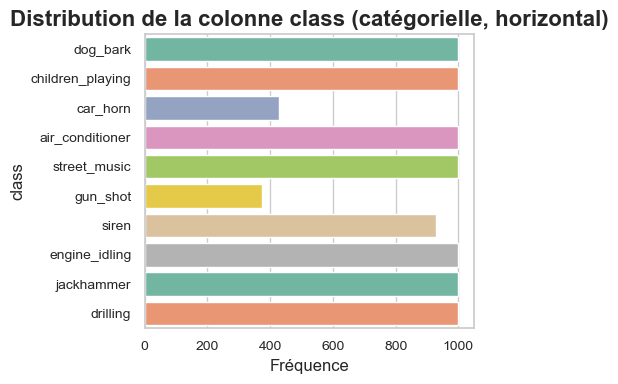

In [8]:
distribution(metadata, "class", "horizontal")

Il y a deux catégories sensiblement moins représentées que les autres :  
    children_playing, street_music

In [9]:
class_cat = metadata["class"].unique().tolist()
class_cat

['dog_bark',
 'children_playing',
 'car_horn',
 'air_conditioner',
 'street_music',
 'gun_shot',
 'siren',
 'engine_idling',
 'jackhammer',
 'drilling']

In [10]:
df = metadata.sort_values(by="classID")
class_dict = dict(zip(df["classID"], df["class"]))
class_dict

{0: 'air_conditioner',
 1: 'car_horn',
 2: 'children_playing',
 3: 'dog_bark',
 4: 'drilling',
 5: 'engine_idling',
 6: 'gun_shot',
 7: 'jackhammer',
 8: 'siren',
 9: 'street_music'}

In [11]:
all_salience = df[["classID", "class", "salience"]].drop_duplicates()
frequences = (
    df.groupby(["classID", "class", "salience"]).size().reset_index(name="frequence")
)
all_salience = all_salience.merge(
    frequences, on=["classID", "class", "salience"], how="left"
)
all_salience = all_salience.sort_values(["classID", "salience"])
all_salience["class_salience"] = all_salience["class"].astype(str) + all_salience[
    "salience"
].astype(str)
all_salience

,classID,class,salience,frequence,class_salience
1,0,air_conditioner,1,569,air_conditioner1
0,0,air_conditioner,2,431,air_conditioner2
2,1,car_horn,1,153,car_horn1
3,1,car_horn,2,276,car_horn2
4,2,children_playing,1,588,children_playing1
5,2,children_playing,2,412,children_playing2
6,3,dog_bark,1,645,dog_bark1
7,3,dog_bark,2,355,dog_bark2
8,4,drilling,1,902,drilling1
9,4,drilling,2,98,drilling2


In [12]:
sns_plot(
    all_salience, initial_columns=["class_salience", "frequence"], graph_types=["Barre"]
)

Output()

Chaque type de son est identifié foreground ou background, avec cependant des disparités de fréquences entre chaque types.   
On peut présupposer que la qualité d'un son background pourra être moindre que pour un son foreground et induire des différences.

Il serait judicieux de tenir compte de cette distribution lors de la segmentation des données pour l'entraînement et la validation, en veillant à ce que le modèle soit exposé de manière équilibrée à toutes les variantes de chaque classe.

# .Wav

Présentation du format WAV
https://web.maths.unsw.edu.au/~lafaye/CCM/audio/wav.htm

Le format WAV (contraction de « WAVEform audio format ») est un standard de stockage de données audio numérique défini par Microsoft et IBM.

Il s'agit probablement du format de stockage audio le plus répandu, étant donné qu'il s'agit du format natif des sons du système d'exploitation Microsoft Windows.

Le format WAV n'est pas en réalité un format de codage mais un format de conteneur audio. Ainsi, un fichier WAV est structuré selon le standard RIFF (Resource Interchange File Format), définissant une structure permettant d'encapsuler des données multimédias.

Structure
Le format WAV définit une structure de données permettant d'accueillir des données audio sous forme de morceaux (en anglais chunks). Il s'agit de structures de données imbriquées, à la manière de poupées russes.

<p align="justify">La structure globale du fichier est la suivante&nbsp;:
<table border="2" cellspacing="0" width="619">
<tbody>
  <tr valign="top"><td width="13%">Adresse (octet)</td>
  <td width="7%">Nom</td>
  <td width="15%">Taille (oct.)</td>
  <td width="62%">Description</td></tr>
  <tr valign="top"><td>00h</td>
  <td>rID</td>
  <td>4h</td>
  <td>Mot &laquo;RIFF&raquo;</td></tr>
  <tr valign="top"><td>04h</td>
  <td>rLen</td>
  <td>4h</td>
  <td>Taille du morceau de donn&eacute;es (chunk)</td></tr>
<tr valign="top"><td>08h</td>
  <td>rData</td>
  <td>rLen</td>
  <td>Morceau de données (chunk)</td></tr>
</tbody>
</table>

<p align="justify">La section rData contient le chunk, cod&eacute; sous la forme suivante&nbsp;:
<table border="2" cellspacing="0" width="619">
<tbody><tr valign="top"><td width="13%">Adresse (octet)</td>
  <td width="20%">Nom</td>
  <td width="16%">Taille (octet)</td>
  <td width="49%">Description</td></tr>
<tr valign="top"><td>00h</td>
  <td>wID</td>
  <td>4</td>
  <td>Terme “WAVE”</td></tr>
<tr valign="top"><td>04h</td>
  <td>Format Chunk</td>
  <td>18</td>
  <td>Format utilis&eacute;</td></tr>
<tr valign="top"><td>1Ch</td>
  <td>WAVE Data Chunk</td>
  <td>?</td>
  <td>Données</td></tr>
</tbody></table>

Format Chunk&nbsp;:
<table border="2" cellspacing="0" width="619">
<tbody><tr valign="top"><td width="13%">D&eacute;calage (octet)</td>
  <td width="20%">Nom</td>
  <td width="16%">Taille (octet)</td>
  <td width="49%">Description</td></tr>
<tr valign="top"><td>00h</td>
  <td>fId</td>
  <td>4</td>
  <td>Terme &laquo;fmt &raquo; (l'espace est n&eacute;cessaire)</td></tr>
<tr valign="top"><td>04h</td>
  <td>fLen</td>
  <td>4</td>
  <td>??</td></tr>
<tr valign="top"><td>08h</td>
  <td><i>wFormatTag</i></td>
  <td>2</td>
  <td>Format (en g&eacute;n&eacute;ral 1 pour le format Microsoft Pulse Code Modulation)</td></tr>
<tr valign="top"><td>0Ah</td>
  <td>nChannels</td>
  <td>2</td>
  <td>Nombre de canaux (1=mono, 2=stéréo)</td></tr>
<tr valign="top"><td>0Ch</td>
  <td>nSamplesPerSec</td>
  <td>4</td>
  <td>Fréquence d’échantillonage (en Hz)</td></tr>
<tr valign="top"><td>10h</td>
  <td><i>nAvgBytesPerSec</i></td>
  <td>4</td>
  <td>nChannels * nSamplesPerSec * (nBitsPerSample/8)
  <br/>Permet d'estimer la taille du tampon n&eacute;cessaire</td></tr>
<tr valign="top"><td>14h</td>
  <td><i>nBlockAlign</i></td>
  <td>2</td>
  <td>nChannels * (nBitsPerSample / 8)
  <br/>Permet l’alignement du tampon</td></tr>
<tr valign="top"><td>16h</td>
  <td><i>FormatSpecific</i></td>
  <td>2</td>
  <td>Longueur d’un échantillon en bits (8 ou 16)</td></tr>
</tbody></table>

Le WAVE Data Chunk&nbsp;:
<table border="2" cellspacing="0" width="619">
<tbody><tr valign="top"><td width="13%">Adresse (octet)</td>
  <td width="20%">Nom</td>
  <td width="16%">Taille (octet)</td>
  <td width="49%">Description</td></tr>
<tr valign="top">
  <td>00h</td>
  <td>dId</td>
  <td>4</td>
  <td>Terme &laquo;data&raquo;</td>
</tr>
<tr>
  <td>04h</td>
  <td>dLen</td>
  <td>4</td>
  <td>Longueur du champ dData (en octets)</td>
</tr>
<tr>
  <td>08h</td>
  <td><i>dData</i></td>
  <td>dLen</td>
  <td>Données du son échantillonné</td>
</tr>
</tbody></table>

<p>Le champ dData est formatt&eacute; comme suit&nbsp;:
<ul>
<li>En mono 8 bits: chaque octet représente un échantillon,</li>
<li>En stéréo 8 bits:&nbsp;2 octets pour chaque échantillon (canal gauche, canal droit),</li>
<li>En mono 16bits chaque mot (octet faible, octet fort) représente un échantillon</li>
<li>En stéréo 16 bits: 2 mots pour chaque échantillon (gauche faible, gauche fort, droit faible, droit fort)</li>
</ul>


# Définitions de termes

* Fréquence : La fréquence d'un son se réfère au nombre de cycles d'ondes sonores qui se produisent en une seconde. Elle est mesurée en hertz (Hz) et détermine la hauteur du son. Des fréquences plus élevées correspondent à des sons plus aigus, tandis que des fréquences plus basses produisent des sons plus graves.

* Amplitude : L'amplitude d'une onde sonore indique sa force ou sa pression et est souvent perçue comme le volume ou l'intensité du son. Plus l'amplitude est élevée, plus le son semble fort.

* Nombre de canaux : Le nombre de canaux dans un enregistrement audio se réfère au nombre de signaux audio indépendants qui sont enregistrés. Par exemple, un enregistrement mono a un canal, tandis qu'un enregistrement stéréo a deux canaux. Chaque canal représente une perspective audio différente, souvent utilisée pour créer un effet spatial dans la musique ou les enregistrements sonores.

* Fréquence d'échantillonnage : La fréquence d'échantillonnage est le nombre de fois par seconde qu'un signal audio est mesuré (échantillonné) lors de son enregistrement numérique. Elle est mesurée en hertz (Hz). Une fréquence d'échantillonnage plus élevée permet une représentation plus précise du son original, avec une limite définie par le théorème de Nyquist-Shannon.

# Echantillons de sons

    Choisir un échantillon de quelques sons de chaque classe et représenter chacun d'eux sous la forme d'un graphique avec le temps en abscisse et l'amplitude en ordonnée.

In [13]:
def creer_liste_exemples(df):
    exemples = []
    combinaisons_vues = set()

    for _, row in df.iterrows():
        combinaison = (row["classID"], row["salience"])
        if combinaison not in combinaisons_vues:
            folder_number = row["fold"]
            exemples.append(
                (row["slice_file_name"], row["class"], row["salience"], folder_number)
            )
            combinaisons_vues.add(combinaison)

    return exemples

In [14]:
exemples = creer_liste_exemples(df)
exemples

[('178686-0-0-66.wav', 'air_conditioner', 2, 5),
 ('121286-0-0-7.wav', 'air_conditioner', 1, 5),
 ('175845-1-0-0.wav', 'car_horn', 1, 1),
 ('155283-1-1-0.wav', 'car_horn', 2, 8),
 ('178521-2-0-93.wav', 'children_playing', 1, 2),
 ('160011-2-0-7.wav', 'children_playing', 2, 2),
 ('166421-3-0-5.wav', 'dog_bark', 1, 2),
 ('177620-3-0-8.wav', 'dog_bark', 2, 9),
 ('63095-4-1-27.wav', 'drilling', 1, 3),
 ('185800-4-2-1.wav', 'drilling', 2, 2),
 ('146186-5-0-6.wav', 'engine_idling', 1, 1),
 ('94632-5-0-0.wav', 'engine_idling', 2, 6),
 ('34708-6-3-0.wav', 'gun_shot', 1, 3),
 ('36403-6-0-0.wav', 'gun_shot', 2, 6),
 ('104998-7-15-9.wav', 'jackhammer', 1, 5),
 ('132016-7-0-4.wav', 'jackhammer', 2, 4),
 ('74364-8-1-15.wav', 'siren', 2, 10),
 ('157867-8-0-7.wav', 'siren', 1, 1),
 ('172314-9-0-51.wav', 'street_music', 2, 1),
 ('139951-9-0-33.wav', 'street_music', 1, 1)]

In [19]:
def afficher_graphiques_et_lire_sons(exemples, base_path):
    for filename, class_name, salience, folder_number in exemples:
        file_path = f"{base_path}/fold{folder_number}/{filename}"
        y, sr = librosa.load(file_path)

        # Afficher le graphique
        plt.figure(figsize=(10, 4))
        librosa.display.waveshow(y, sr=sr)
        plt.title(f"Classe: {class_name}, Salience: {salience}")
        plt.xlabel("Temps (s)")
        plt.ylabel("Amplitude")
        plt.show()

        # Jouer l'audio
        display(ipd.Audio(file_path))

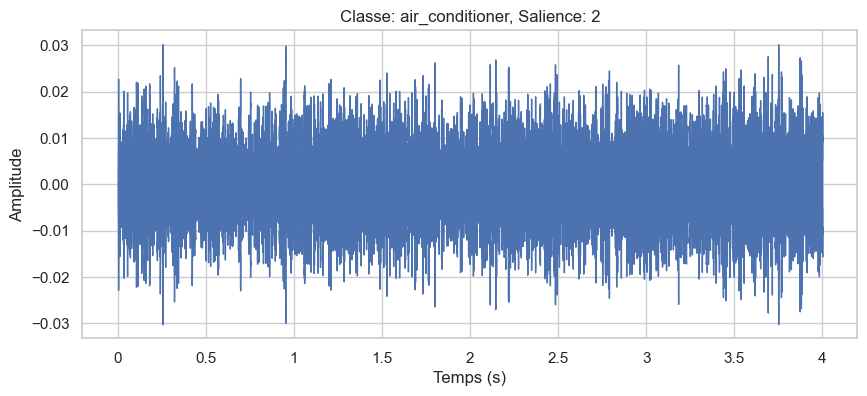

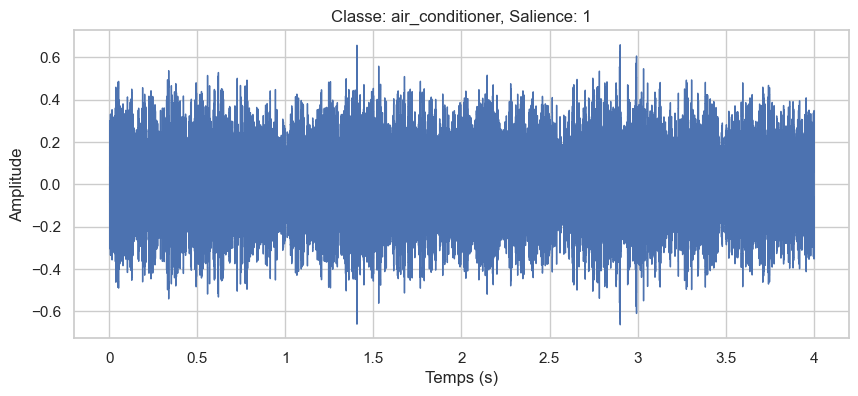

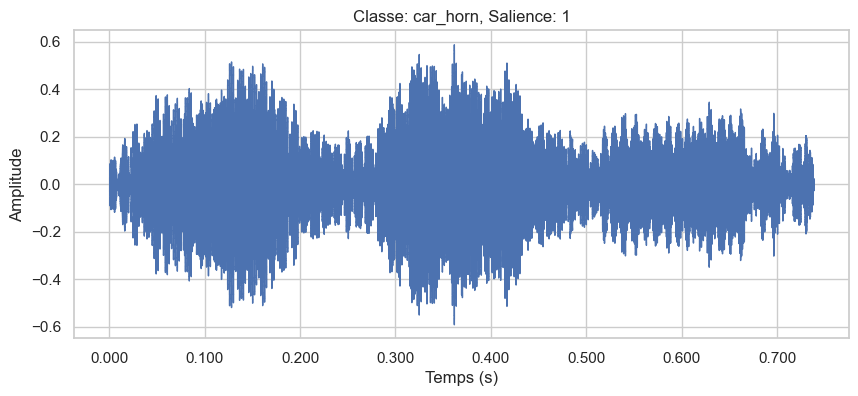

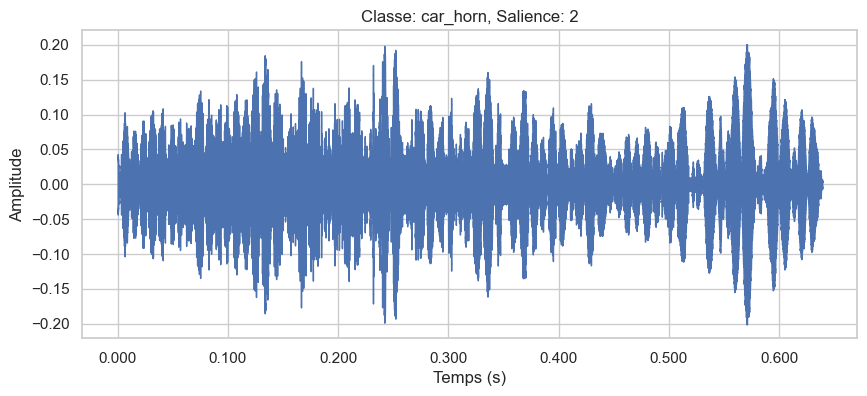

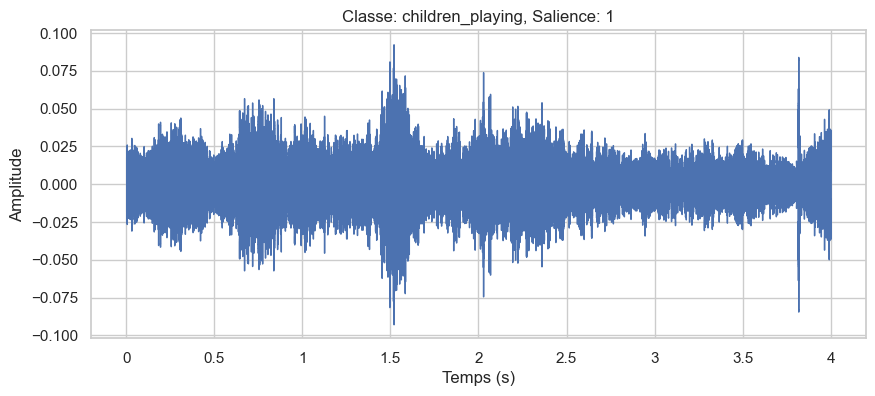

...

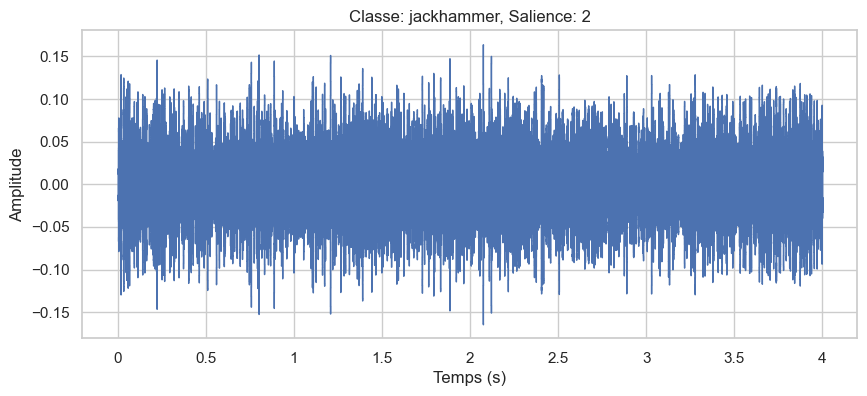

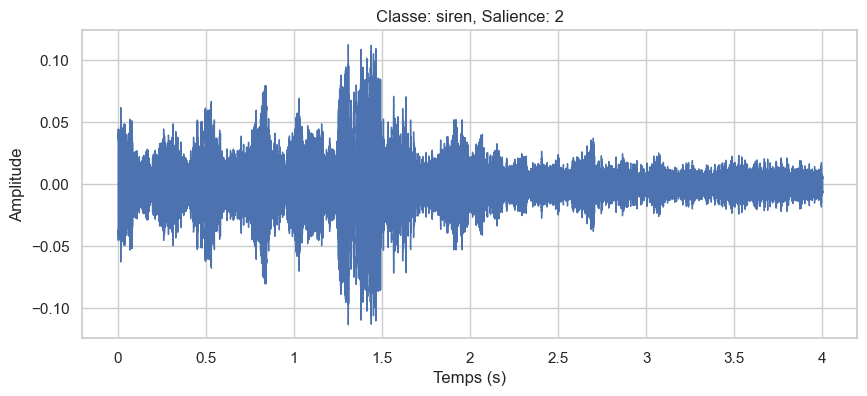

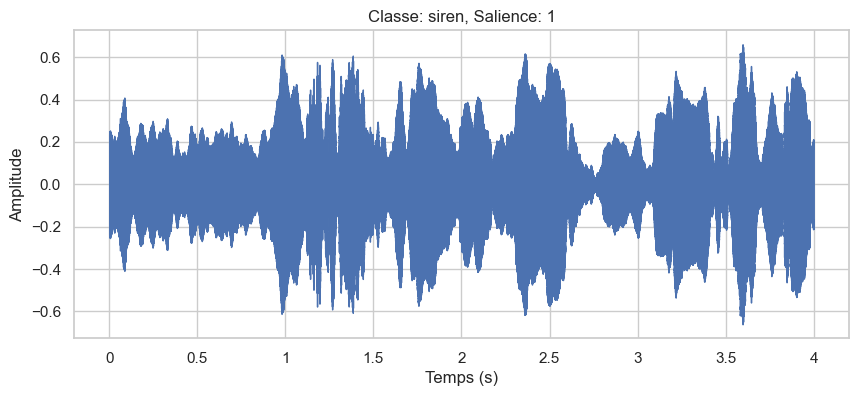

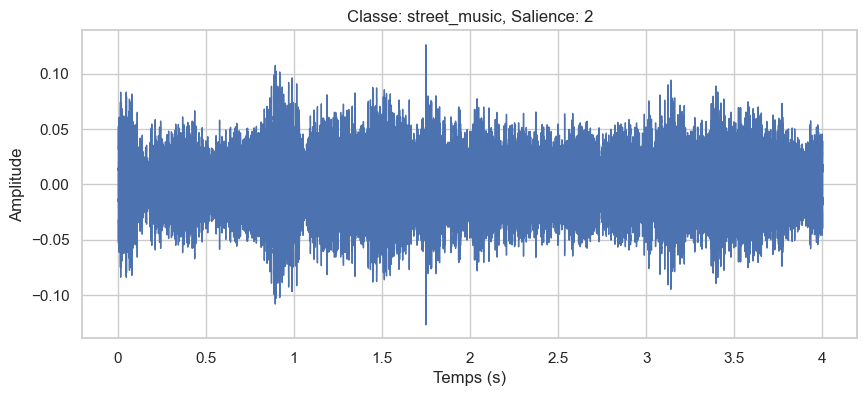

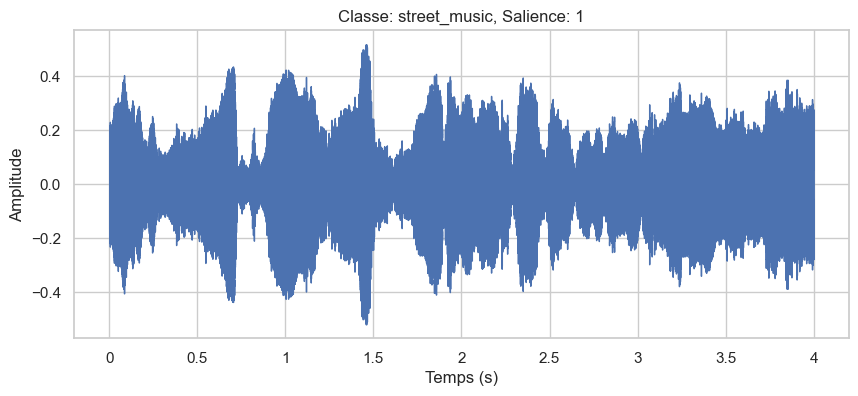

In [20]:
afficher_graphiques_et_lire_sons(exemples, "datas/audio")

On observe des variations d'amplitudes différentes selon les classes.  
Des classes comme "dog_bark" ou "gun_shot" montrent d'importants pics espacés ou uniques, tandisque que "street_music" ou "engine" ont des pics plus uniformes et plus constants.  
On remarque généralement d'avantage de bruit, c'est à dire des pics moins nets, lorsqu'il s'agit de sons de "background".  
Cependant, il ne parait pas évident de pouvoir différencier certaines catégories, telles que "street_music" et "siren" : l'allure globable des deux exemples ci-dessus est assez proche.   
Ces graphiques ne semblent donc pas capturer toutes les nuances nécessaires pour une classification précise, car ils ne capturent pas les caractéristiques fines des sons (timbre, les harmoniques, modulations de fréquence).  

# Vérifier le nombre de canaux

In [16]:
def verifier_nombre_canaux(base_folder):
    canaux_distribution = {"mono": 0, "stereo": 0, "autres": 0}

    for root, dirs, files in os.walk(base_folder):
        for filename in files:
            if filename.endswith(".wav"):
                path = os.path.join(root, filename)
                y, sr = librosa.load(path, mono=False)
                if y.ndim == 1:
                    canaux_distribution["mono"] += 1
                elif y.ndim == 2:
                    canaux_distribution["stereo"] += 1
                else:
                    canaux_distribution["autres"] += 1

    return canaux_distribution

In [17]:
base_folder = "datas/audio/"
# canaux_distribution = verifier_nombre_canaux(base_folder)  # 2m40
# with open("outputs/canaux_distribution.json", "w") as file:
#     json.dump(canaux_distribution, file)
with open("outputs/canaux_distribution.json", "r") as file:
    canaux_distribution = json.load(file)
canaux_distribution

{'mono': 739, 'stereo': 7993, 'autres': 0}

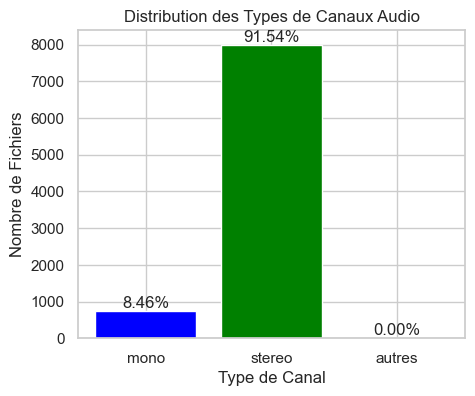

In [18]:
noms = list(canaux_distribution.keys())
valeurs = list(canaux_distribution.values())
plt.figure(figsize=(5, 4))
bars = plt.bar(noms, valeurs, color=["blue", "green"])
total = sum(valeurs)
for bar in bars:
    yval = bar.get_height()
    plt.text(
        bar.get_x() + bar.get_width() / 2,
        yval,
        f"{yval/total:.2%}",
        va="bottom",
        ha="center",
    )
plt.xlabel("Type de Canal")
plt.ylabel("Nombre de Fichiers")
plt.title("Distribution des Types de Canaux Audio")
plt.show()

Il n'y a pas de fichiers plus complexes que stéréo.  
La proportion de fichiers stéréo est plus importante que mono.  
La stéréo peut fournir une dimension spatiale supplémentaire par rapport au mono.  
Cette distribution signifie qu'il faudra peut être traiter différemment les fichiers mono et stéréo, ou les convertir tous dans un format commun pour la cohérence lors de l'utilisation dans des modèles.

# Etudier la distribution de la fréquence d'échantillonnage de chaque son

In [19]:
def verifier_frequences_echantillonnage(base_folder):
    freq_echantillonnage_distribution = {}

    for root, dirs, files in os.walk(base_folder):
        for filename in files:
            if filename.endswith(".wav"):
                path = os.path.join(root, filename)
                y, sr = librosa.load(
                    path, sr=None
                )  # Charger avec la fréquence d'échantillonnage native
                if sr not in freq_echantillonnage_distribution:
                    freq_echantillonnage_distribution[sr] = 1
                else:
                    freq_echantillonnage_distribution[sr] += 1

    return freq_echantillonnage_distribution

In [20]:
# freq_echantillonnage_distribution = verifier_frequences_echantillonnage(
#     base_folder
# )  # 2m50
# with open("outputs/freq_echantillonnage_distribution.json", "w") as file:
#     json.dump(freq_echantillonnage_distribution, file)
with open("outputs/freq_echantillonnage_distribution.json", "r") as file:
    freq_echantillonnage_distribution = json.load(file)
freq_echantillonnage_distribution

{'48000': 2502,
 '44100': 5370,
 '96000': 610,
 '11025': 39,
 '24000': 82,
 '8000': 12,
 '16000': 45,
 '22050': 44,
 '32000': 4,
 '192000': 17,
 '11024': 7}

In [21]:
def graph_freq_echantillonnage_distribution(freq_echantillonnage_distribution):
    noms = sorted(freq_echantillonnage_distribution.keys())
    valeurs = [freq_echantillonnage_distribution[nom] for nom in noms]
    plt.figure(figsize=(12, 8))
    bars = plt.bar(range(len(noms)), valeurs, color="teal")
    total = sum(valeurs)
    for i, bar in enumerate(bars):
        yval = bar.get_height()
        plt.text(
            bar.get_x() + bar.get_width() / 2,
            yval,
            f"{yval/total:.2%}",
            va="bottom",
            ha="center",
        )
        plt.text(
            bar.get_x() + bar.get_width() / 2,
            -0.05 * max(valeurs),
            str(noms[i]),
            va="top",
            ha="center",
            rotation=45,
        )
    plt.xlabel("Fréquence d'Échantillonnage (Hz)")
    plt.ylabel("Nombre de Fichiers")
    plt.title("Distribution de la Fréquence d'Échantillonnage des Fichiers Audio")
    plt.xticks([])
    plt.tight_layout()
    plt.show()

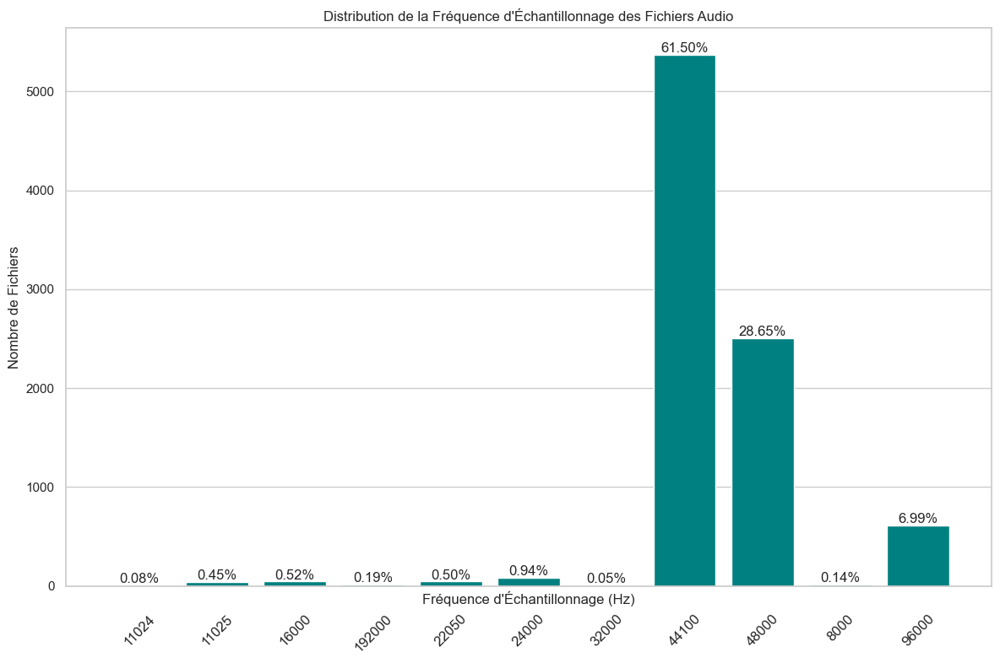

In [22]:
graph_freq_echantillonnage_distribution(freq_echantillonnage_distribution)

Les fréquences de 44100 Hz et 48000 Hz sont les plus courantes, ce sont des enregistrements audio de haute qualité.  
Des fréquences d'échantillonnage plus élevées comme 96000 Hz et 192000 Hz sont également présentes.  
Les fréquences basses sont peu représentées et comme il s'agit de sons de moins bonne qualité il pourrait être intéressant de les retirer du jeu d'entrainement.  
Pour un traitement cohérent et une analyse précise, il pourrait être nécessaire de normaliser les fichiers audio à une fréquence d'échantillonnage commune.  

# Normaliser
Il convient de normaliser les variables étudiées aux deux questions précédentes. 
Comment la librairie librosa va-t-elle régler ce problème ?

* Fréquence d'Échantillonnage :   
librosa.load permet de spécifier une fréquence d'échantillonnage (sr) lors du chargement des fichiers audio.   
Si sr est définie sur une valeur spécifique (par exemple, 44100 Hz), tous les fichiers audio seront automatiquement rééchantillonnés à cette fréquence lors du chargement, assurant une fréquence d'échantillonnage uniforme pour l'ensemble du dataset.

* Conversion Mono/Stéréo :   
librosa.load a un paramètre mono.   
Si mono=True, tous les fichiers audio seront convertis en mono, indépendamment de leur format d'origine. Cela garantit une uniformité dans le nombre de canaux.



# MFCC
    Etudier les concepts théoriques de “Mel-spectogram“ et “Mel-frequency cepstral coefficients“. 

Il faudra calculer les MFCC :  
https://medium.com/@derutycsl/intuitive-understanding-of-mfccs-836d36a1f779  
https://fr.wiktionary.org/wiki/cepstre  

* cepstre :  
Le cepstre a tout d’abord été défini en 1963 comme étant le résultat de la transformée de Fourier appliquée au logarithme naturel de la transformée de Fourier du signal dont la phase est ignorée. Une autre définition apparue depuis est la transformée de Fourier inverse appliquée au logarithme de la transformée de Fourier du signal.   
*Étymologie: (1963) Inversion de la syllabe initiale de "spectre".*


Les Mel-Frequency Cepstral Coefficients (MFCCs) sont des caractéristiques largement utilisées dans le traitement automatique de la parole et de l'audio. Ils sont particulièrement populaires dans les domaines de la reconnaissance vocale et de la classification sonore.   

Les MFCCs sont basés sur la perception humaine de la fréquence du son. Ils représentent le court-terme de puissance du spectre d'un son sur une échelle de fréquence non linéaire (l'échelle de Mel). 

Cette échelle imite de plus près la façon dont l'oreille humaine perçoit les sons, notamment la manière dont elle distingue les changements dans les fréquences basses mieux que dans les hautes fréquences.

Processus de calcul:

* Transformation de Fourier: Le son est d'abord divisé en courts segments temporels et la transformation de Fourier est appliquée pour obtenir le spectre de puissance pour chaque segment. 
* Application du filtre de Mel: Le spectre de puissance est ensuite passé à travers une série de filtres de banc de Mel. Chaque filtre dans le banc est conçu pour laisser passer une certaine bande de fréquences. Cela permet de capturer l'information importante tout en réduisant la dimensionnalité des données.
* Logarithme des énergies: Le logarithme des énergies de chaque filtre est pris, car cela correspond mieux à la perception de l'intensité sonore par l'oreille humaine.
* Transformation en cosinus discrète (DCT): Enfin, une DCT est appliquée aux log-énergies pour obtenir les MFCCs. La DCT aide à décorréler les coefficients et à mettre l'accent sur les coefficients de basse fréquence qui sont plus importants pour la perception humaine.

* Transformation de Fourier  
https://glq2200.clberube.org/chapitres/docs/signal-fourier  
La transformée de Fourier est un outil qui permet de décomposer un signal en ses différentes composantes.

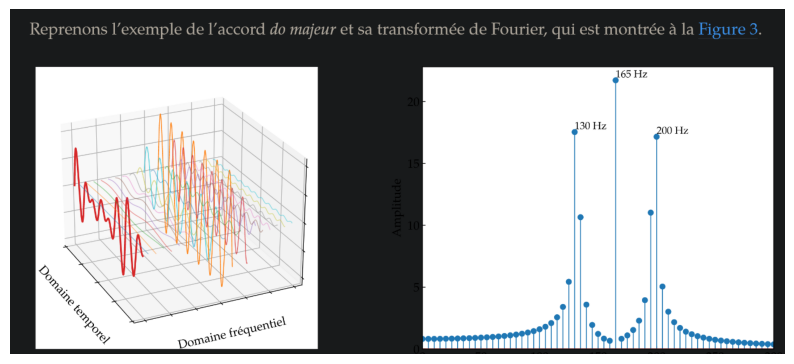

In [23]:
image = mpimg.imread("img/cap2.png")
plt.figure(figsize=(10, 6))
plt.imshow(image)
plt.axis("off")
plt.show()

* Principe MFCC :  
Un spectre de puissance logarithmique est évalué à partir de l'entrée audio.  
Le spectre de puissance est rééchantillonné sur l'échelle Mel.  
La sortie MFCC est la transformée en cosinus discrète du spectre rééchantillonné.   
Une réduction significative de la dimensionnalité provient du rééchantillonnage vers le banc de filtres Mel à 16 bandes. 

=> On passe donc d'unités de temps, aux fréquences, avant de revenir au temps.  
C'est en quelquesorte un spectre de spectre.  
À partir du nombre élevé de valeurs log(abs(FT)) initiales (la moitié du nombre de valeurs du signal d'origine), le sous-échantillonnage donne 16 valeurs.   
Les MFCC d'un fichier audio peuvent être interprétés comme l'autocorrélation du fichier filtré passe-haut, la hauteur musicale supprimée et est robuste à la réduction de la bande passante. C'est à dire que :

**les MFCC quantifient l’auto-similarité du signal filtré passe-haut à différentes échelles de temps (ton musical supprimé, et robuste à la réduction de la bande passante)**

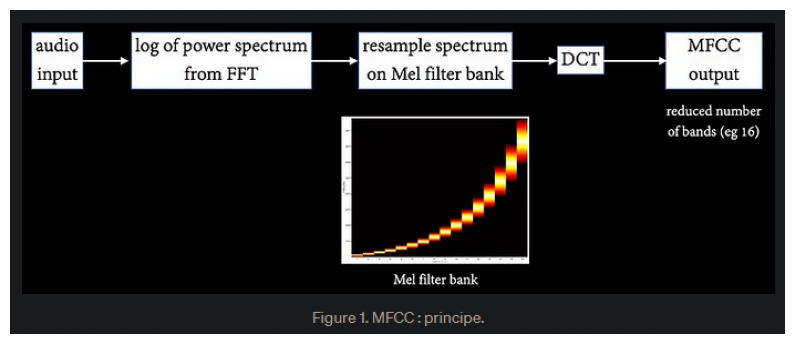

In [24]:
image = mpimg.imread("img/cap3.png")
plt.figure(figsize=(10, 6))
plt.imshow(image)
plt.axis("off")
plt.show()

Utilisation dans le traitement audio:

    Les MFCCs sont souvent utilisés comme caractéristiques d'entrée pour les systèmes de reconnaissance de la parole et de classification des sons. Ils sont efficaces pour capturer les propriétés du timbre et de la forme des sons.

Avantages:

    Ils sont robustes et relativement insensibles au bruit, ce qui les rend utiles dans diverses conditions d'enregistrement.
    Ils offrent une représentation compacte et informatique des signaux audio.

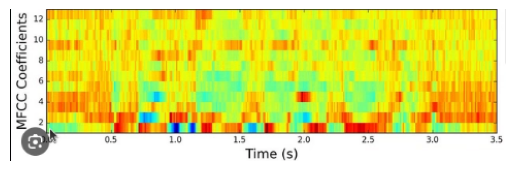

In [25]:
image = mpimg.imread("img/cap1.png")
plt.imshow(image)
plt.axis("off")
plt.show()

# Dataframe MFCCs
     Construire un dataframe panda qui contiendra les MFCCs et les labels de chaque son.

In [26]:
# Retirer les fichiers dont la fréquence est inférieure à 44100
def recupérer_fichiers_basse_frequence(base_folder, freq_max=44100):
    fichiers_basse_freq = []

    for root, dirs, files in os.walk(base_folder):
        for filename in files:
            if filename.endswith(".wav"):
                path = os.path.join(root, filename)
                y, sr = librosa.load(path, sr=None)
                if sr < freq_max:
                    fichiers_basse_freq.append(filename)

    return fichiers_basse_freq

In [27]:
# fichiers_basse_freq = recupérer_fichiers_basse_frequence(base_folder)  # 2m50
# with open("outputs/fichiers_basse_freq.json", "w") as file:
#     json.dump(fichiers_basse_freq, file)
with open("outputs/fichiers_basse_freq.json", "r") as file:
    fichiers_basse_freq = json.load(file)
len(fichiers_basse_freq)

233

In [28]:
# Filtrer df : retirer les fichiers à basse fréquence
df = df[~df["slice_file_name"].isin(fichiers_basse_freq)]

In [29]:
# Chargement des MFCC en normalisant ("sr = 44100" et "mono")
# Deux daframes créés :
# mfcc_mean : information réduite à la moyenne pour réseau de neurone dense
# mfcc_full : information complète pour réseau de neurone convolutif ou récurent
def creer_dataframes_mfcc(df, base_folder):
    mfcc_data_mean = []
    mfcc_data_full = []

    for _, row in df.iterrows():
        file_path = f'{base_folder}/fold{row["fold"]}/{row["slice_file_name"]}'
        y, sr = librosa.load(file_path, sr=44100, mono=True)
        mfcc = librosa.feature.mfcc(y=y, sr=sr)
        # Calcul de la moyenne des MFCCs
        mean = np.mean(mfcc, axis=1)
        mfcc_data_mean.append([mean, row["classID"]])
        mfcc_data_full.append([mfcc, row["classID"]])
    mfcc_mean = pd.DataFrame(mfcc_data_mean, columns=["MFCC", "Label"])
    mfcc_full = pd.DataFrame(mfcc_data_full, columns=["MFCC", "Label"])

    return mfcc_mean, mfcc_full

In [30]:
# mfcc_mean, mfcc_full = creer_dataframes_mfcc(df, base_folder)  # 5M
# mfcc_mean.to_hdf("mfcc_mean.h5", key="mfcc_mean", mode="w")
# mfcc_full.to_hdf("mfcc_full.h5", key="mfcc_full", mode="w")
mfcc_mean = pd.read_hdf("mfcc_mean.h5", "mfcc_mean")
mfcc_full = pd.read_hdf("mfcc_full.h5", "mfcc_full")

mfcc_mean.info()
display(mfcc_mean)
mfcc_full.info()
display(mfcc_full)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8499 entries, 0 to 8498
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   MFCC    8499 non-null   object
 1   Label   8499 non-null   int64 
dtypes: int64(1), object(1)
memory usage: 199.2+ KB


,MFCC,Label
0,"[-500.9545, 190.54257, 46.127026, 7.4562488, 3...",0
1,"[-147.88918, 183.2797, -30.574148, 1.571805, -...",0
2,"[-147.97693, 183.35007, -30.182623, 1.1327511,...",0
3,"[-148.28789, 183.22981, -30.618694, 0.66219383...",0
4,"[-148.18037, 182.73634, -31.318472, -0.368641,...",0
...,...,...
8494,"[-370.21683, 130.49971, -25.79012, 21.193764, ...",9
8495,"[-372.72867, 148.95917, -23.644089, 10.784164,...",9
8496,"[-314.6411, 108.237816, -53.042583, 24.76845, ...",9
8497,"[-355.32645, 123.43896, -17.917383, -0.0932770...",9


<class 'pandas.core.frame.DataFrame'>
Int64Index: 8499 entries, 0 to 8498
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   MFCC    8499 non-null   object
 1   Label   8499 non-null   int64 
dtypes: int64(1), object(1)
memory usage: 199.2+ KB


,MFCC,Label
0,"[[-517.14264, -507.47202, -511.59097, -507.107...",0
1,"[[-164.91602, -144.31561, -148.48773, -143.537...",0
2,"[[-121.660614, -130.61635, -150.00882, -152.88...",0
3,"[[-161.76065, -139.39134, -144.06302, -151.117...",0
4,"[[-156.78795, -140.5994, -145.32002, -146.5045...",0
...,...,...
8494,"[[-309.70383, -341.10236, -402.45795, -403.122...",9
8495,"[[-284.1633, -325.12186, -394.43558, -404.0852...",9
8496,"[[-294.7232, -310.682, -340.48944, -337.46527,...",9
8497,"[[-236.3347, -276.62915, -364.8199, -360.4295,...",9


In [31]:
mfcc_full.iloc[0][0]

array([[-5.1714264e+02, -5.0747202e+02, -5.1159097e+02, ...,
        -4.9827054e+02, -4.9891690e+02, -4.7455112e+02],
       [ 1.7233189e+02,  1.8144458e+02,  1.8583548e+02, ...,
         2.0174667e+02,  1.9813367e+02,  1.7547993e+02],
       [ 4.4038826e+01,  4.7289192e+01,  5.2972443e+01, ...,
         5.6824493e+01,  6.0473518e+01,  4.6560432e+01],
       ...,
       [-3.0177424e+00, -1.6872299e+00,  1.9619119e-01, ...,
         8.0118484e+00,  1.1769598e+01,  3.5176656e+00],
       [-1.6471438e+00,  2.5823367e-01,  2.8234403e+00, ...,
         1.1180283e+00,  4.6718254e+00,  3.4865007e+00],
       [ 8.1893845e+00,  1.0203734e+01,  8.4962730e+00, ...,
         1.2997122e+00, -1.8646836e+00,  2.9493079e+00]], dtype=float32)

In [32]:
len(mfcc_full.iloc[0][0])

20

In [33]:
mfcc_full.iloc[0][0][0]

array([-517.14264, -507.47202, -511.59097, -507.1076 , -507.37003,
       -504.02905, -506.49875, -513.7089 , -506.11548, -504.8385 ,
       -507.74402, -506.44278, -504.4714 , -502.38132, -500.639  ,
       -503.1307 , -509.18848, -508.32846, -507.3534 , -508.0541 ,
       -506.38788, -506.5038 , -503.97998, -505.78253, -507.6296 ,
       -511.862  , -507.8368 , -503.38303, -509.49478, -508.1998 ,
       -507.96683, -510.09622, -510.07712, -507.5493 , -510.3097 ,
       -513.08704, -506.69327, -506.75098, -511.20004, -516.06683,
       -511.1515 , -510.23636, -510.73953, -507.96002, -506.2017 ,
       -502.17993, -505.3397 , -500.815  , -502.35645, -501.89337,
       -502.3184 , -502.8862 , -512.86523, -510.7191 , -505.5221 ,
       -505.13565, -505.5755 , -512.1398 , -512.62463, -508.09415,
       -506.2476 , -511.6042 , -516.74005, -509.3306 , -500.33557,
       -504.5798 , -508.83456, -505.7796 , -505.60608, -505.84146,
       -504.11343, -504.0222 , -499.18842, -483.80307, -482.88

In [34]:
len(mfcc_full.iloc[0][0][0])

345

In [35]:
mfcc_mean.iloc[0][0]

array([-500.9545   ,  190.54257  ,   46.127026 ,    7.4562488,
          3.7697396,    5.450421 ,   -1.9461907,    3.760009 ,
          1.1263124,    4.032455 ,    3.0818126,    3.853021 ,
         -1.653859 ,    3.4811544,    3.9512773,    5.599159 ,
          1.6607606,    6.499405 ,    3.9898274,    4.8843155],
      dtype=float32)

In [36]:
len(mfcc_mean.iloc[0][0])

20

In [37]:
mfcc_mean.iloc[0][0][0]

-500.9545

 On constate bien la moyenne appliquée au dataset mfcc_mean.  
 Tandisque que pour chaque valeur moyennée le dataset mfcc_full contient : 345 valeurs.

# Heatmaps coefficients MFCC

In [38]:
def afficher_mfccs_pour_chaque_label(df, class_dict):
    for label in df["Label"].unique():
        exemple = df[df["Label"] == label].iloc[0]
        mfcc = exemple["MFCC"]
        label_text = class_dict[label]
        # Graphique
        plt.figure(figsize=(10, 4))
        librosa.display.specshow(mfcc, x_axis="time", cmap="magma")
        plt.colorbar(format="%+2.0f dB")
        plt.title(f"MFCC - Label: {label_text}")
        plt.ylabel("Coefficient MFCC")
        plt.xlabel("Temps (s)")
        plt.show()

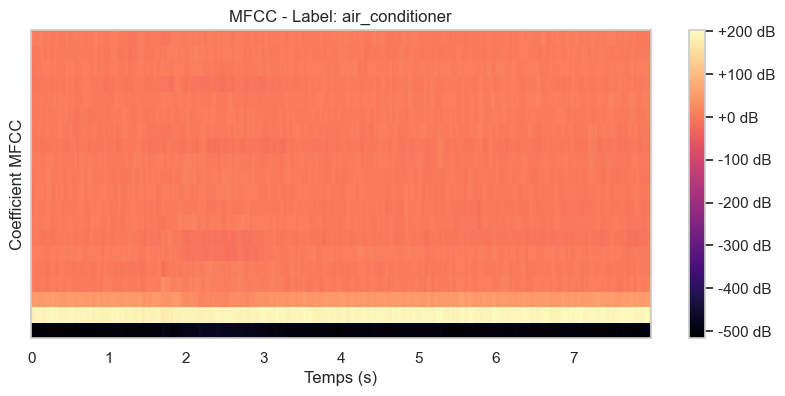

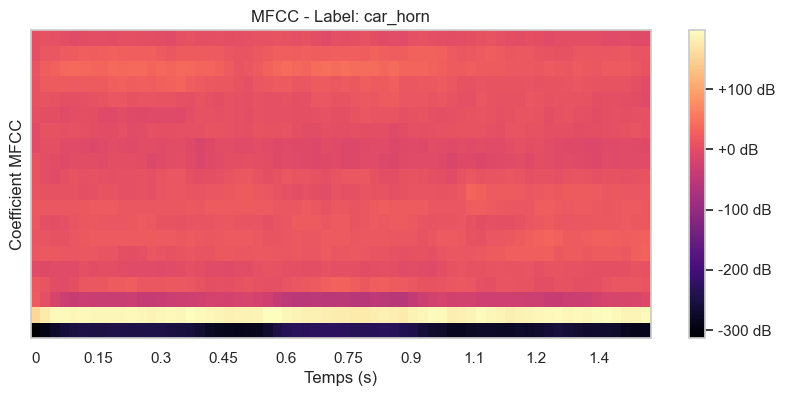

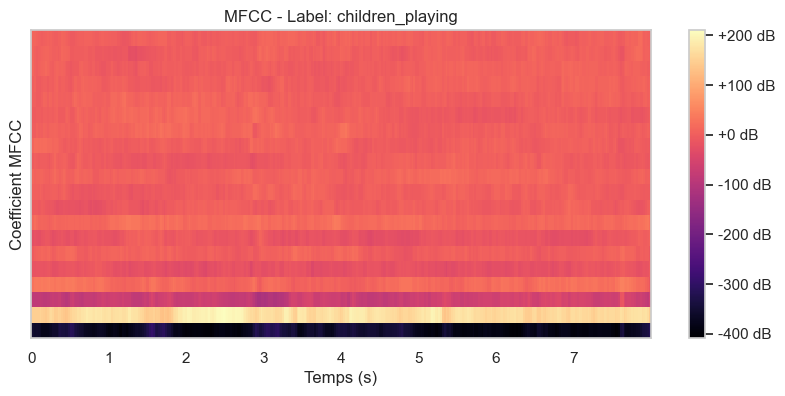

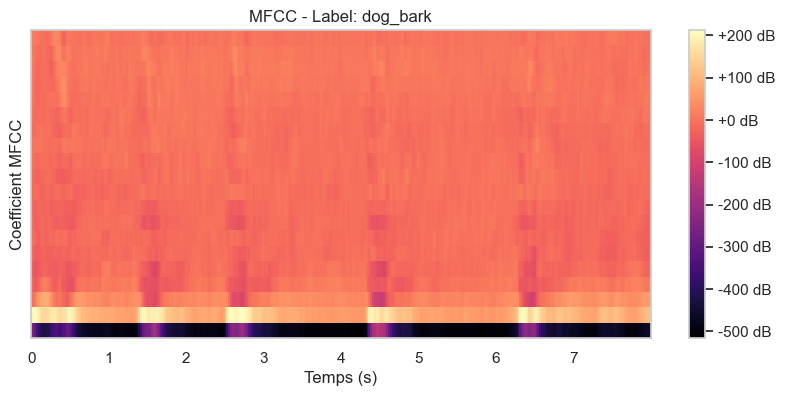

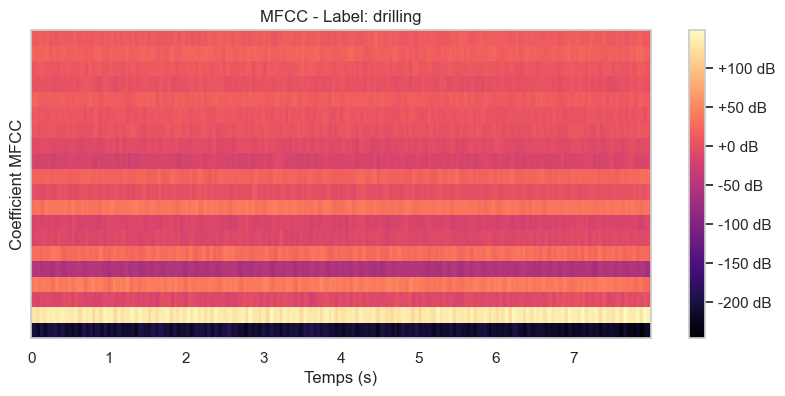

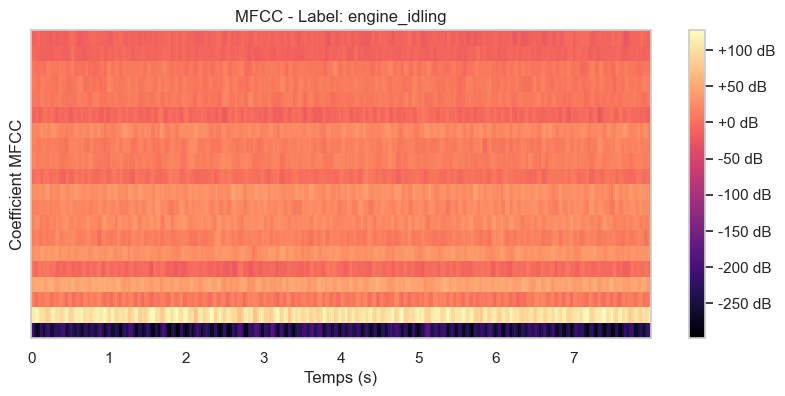

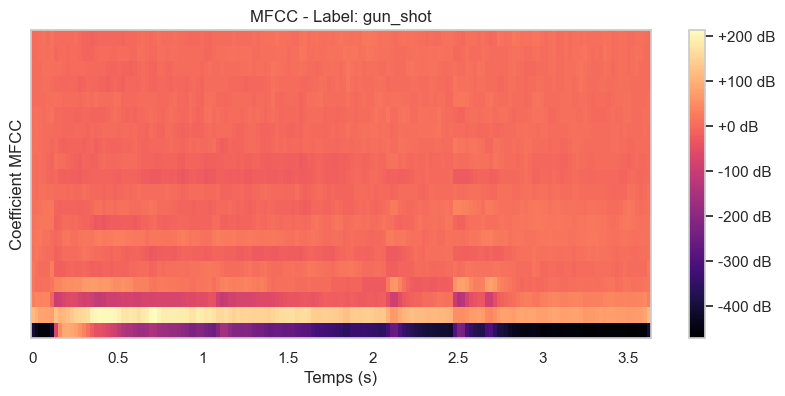

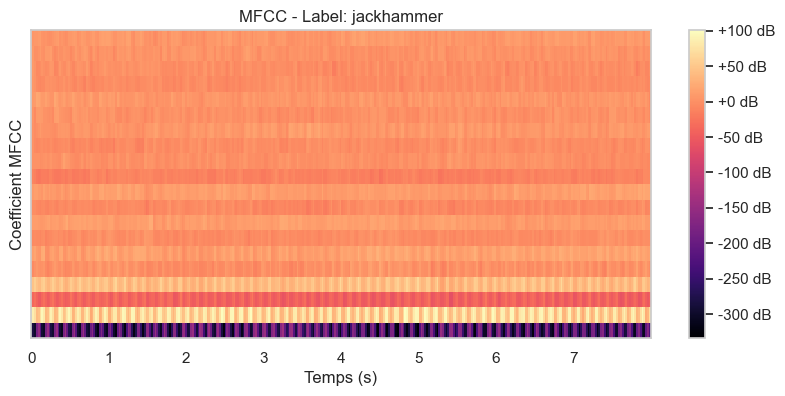

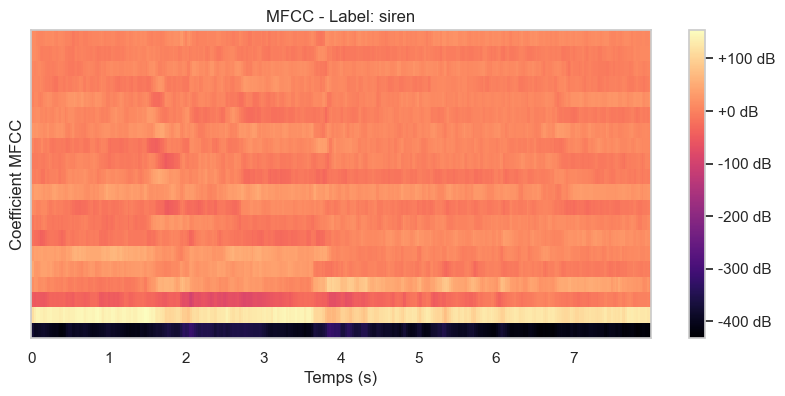

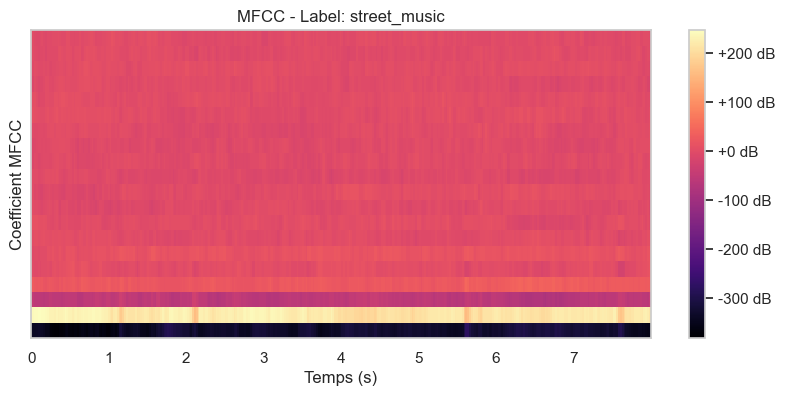

In [39]:
afficher_mfccs_pour_chaque_label(mfcc_full, class_dict)

Chaque ligne horizontale représente un coefficient MFCC.   
Les premiers coefficients (les premières lignes en bas du graphique) capturent généralement des informations de bas niveau sur le spectre, tandis que les coefficients supérieurs capturent des informations de plus haut niveau.  
Les premiers coefficients MFCC sont souvent les plus significatifs pour la reconnaissance sonore. Ils tendent à représenter des aspects généraux du spectre sonore, comme le timbre.  
On remarque sur la majorité des graphiques : un contraste élevé dans les premiers coefficients, qui peut indiquer des caractéristiques distinctives du son qui sont capturées dans ces coefficients bas.  
Les variations dans les lignes supérieures peuvent fournir des informations supplémentaires, mais elles sont souvent moins critiques pour la classification ou la reconnaissance sonore.  
=> Il semble pouvoir être envisageable de travailler avec uniquement les premiers coefficients pour réduire la complexité du modèle.

# train_test_split
    Séparer les données en un jeu d'entraînement/validation et un jeu de test.

In [40]:
def split(df):
    X = df["MFCC"]
    y = df["Label"]
    X_train_val, X_test, y_train_val, y_test = train_test_split(
        X, y, test_size=0.2, random_state=42
    )
    X_train, X_val, y_train, y_val = train_test_split(
        X_train_val, y_train_val, test_size=0.25, random_state=42
    )
    print(X_train.shape)
    print(X_test.shape)
    print(X_val.shape)
    print(y_train.shape)
    print(y_test.shape)
    print(y_val.shape)
    return X_train, X_test, X_val, y_train, y_test, y_val

In [41]:
X_train, X_test, X_val, y_train, y_test, y_val = split(mfcc_mean)

(5099,)
(1700,)
(1700,)
(5099,)
(1700,)
(1700,)


In [42]:
X_train[0]

array([-500.9545   ,  190.54257  ,   46.127026 ,    7.4562488,
          3.7697396,    5.450421 ,   -1.9461907,    3.760009 ,
          1.1263124,    4.032455 ,    3.0818126,    3.853021 ,
         -1.653859 ,    3.4811544,    3.9512773,    5.599159 ,
          1.6607606,    6.499405 ,    3.9898274,    4.8843155],
      dtype=float32)

In [43]:
# Conversion des labels en format one-hot
y_train = to_categorical(y_train)
y_val = to_categorical(y_val)
y_test = to_categorical(y_test)

In [44]:
X_train = np.array([x for x in X_train])
X_val = np.array([x for x in X_val])
X_test = np.array([x for x in X_test])

# RN Dense
    Construire un premier réseau de neurones complètement connecté pour résoudre ce problème de classification.

 ## Itération 1

In [45]:
def model_dense(X_train):
    model = Sequential()
    input_shape = X_train[0].shape
    # Input
    model.add(Flatten(input_shape=input_shape))
    model.add(Dense(256, activation="relu"))

    model.add(Dense(128, activation="relu"))
    # Output
    model.add(
        Dense(10, activation="softmax")  # softmax pour la classification à 10 classes
    )
    # Compilation
    model.compile(
        optimizer="rmsprop",
        loss="categorical_crossentropy",
        metrics=["categorical_accuracy"],
    )
    return model

In [46]:
model_dense = model_dense(X_train)
# Résumé du modèle
model_dense.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten (Flatten)           (None, 20)                0         
                                                                 
 dense (Dense)               (None, 256)               5376      
                                                                 
 dense_1 (Dense)             (None, 128)               32896     
                                                                 
 dense_2 (Dense)             (None, 10)                1290      
                                                                 
Total params: 39562 (154.54 KB)
Trainable params: 39562 (154.54 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


    Entraîner le modèle construit à la question 13 et mesurer sa performance.

In [47]:
nb_epochs = 100
batch_size = 128

In [48]:
# EarlyStopping: Arrête l'entraînement quand une métrique surveillée cesse de s'améliorer. patience=3 signifie qu'il attend 3 époques sans amélioration avant d'arrêter.
# ModelCheckpoint: Sauvegarde le modèle à chaque époque. filepath définit le chemin et le format du nom de fichier. Le modèle est sauvegardé avec le numéro d'époque et la perte de validation dans le nom du fichier.
# TensorBoard: Outil de visualisation pour TensorFlow. histogram_freq=1 indique de créer des histogrammes chaque époque. Le dossier logs est utilisé pour stocker les logs.

In [49]:
cb = [
    # callbacks.EarlyStopping(patience=10),
    # callbacks.ModelCheckpoint(filepath="modelsav/model.{epoch:02d}-{val_loss:.2f}.h5"),
    # callbacks.TensorBoard("logs", histogram_freq=1),
]

In [50]:
history = model_dense.fit(
    X_train,
    y_train,
    epochs=nb_epochs,
    batch_size=batch_size,
    validation_data=(X_val, y_val),
    callbacks=cb,
)

Epoch 1/100
40/40 [==============================] - 1s 10ms/step - loss: 8.6023 - categorical_accuracy: 0.2544 - val_loss: 5.2468 - val_categorical_accuracy: 0.3182
Epoch 2/100
40/40 [==============================] - 0s 4ms/step - loss: 4.1040 - categorical_accuracy: 0.4075 - val_loss: 3.1731 - val_categorical_accuracy: 0.4000
Epoch 3/100
40/40 [==============================] - 0s 4ms/step - loss: 3.3806 - categorical_accuracy: 0.4452 - val_loss: 3.5350 - val_categorical_accuracy: 0.4035
Epoch 4/100
40/40 [==============================] - 0s 4ms/step - loss: 2.7804 - categorical_accuracy: 0.4742 - val_loss: 1.9468 - val_categorical_accuracy: 0.5471
Epoch 5/100
40/40 [==============================] - 0s 4ms/step - loss: 2.2827 - categorical_accuracy: 0.5225 - val_loss: 1.9739 - val_categorical_accuracy: 0.5676
Epoch 6/100
40/40 [==============================] - 0s 4ms/step - loss: 2.0089 - categorical_accuracy: 0.5385 - val_loss: 1.6241 - val_categorical_accuracy: 0.5700
Epoch 7/1

In [51]:
def plot_history(history, metrics):
    fig, axes = plt.subplots(1, 2, figsize=(15, 5))

    # Plot pour la perte
    axes[0].plot(
        history.history["loss"], label="Train Loss", color="blue", linestyle="-"
    )
    axes[0].plot(
        history.history["val_loss"], label="Val Loss", color="orange", linestyle="--"
    )
    axes[0].set_title("Training and Validation Loss")
    axes[0].set_xlabel("Epochs")
    axes[0].set_ylabel("Loss")
    axes[0].legend()

    # Plot pour la précision
    axes[1].plot(
        history.history[metrics],
        label=f"Train {metrics.capitalize()}",
        color="blue",
        linestyle="-",
    )
    axes[1].plot(
        history.history[f"val_{metrics}"],
        label=f"Val {metrics.capitalize()}",
        color="orange",
        linestyle="--",
    )
    axes[1].set_title(f"Training and Validation {metrics.capitalize()}")
    axes[1].set_xlabel("Epochs")
    axes[1].set_ylabel(metrics.capitalize())
    axes[1].legend()

    plt.show()

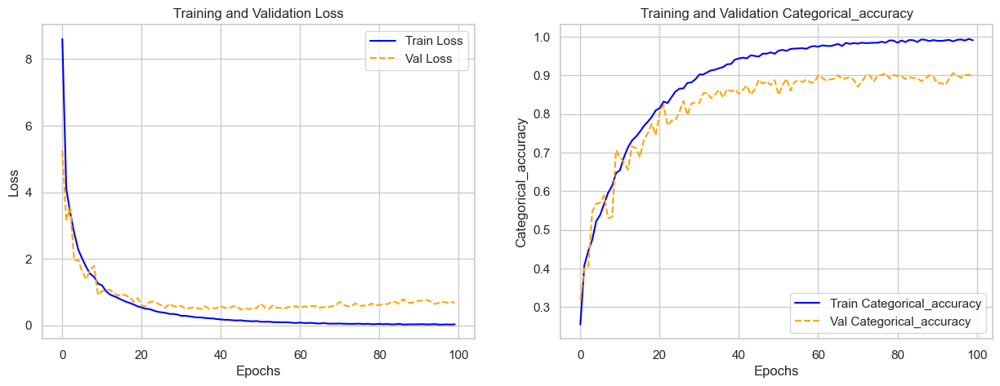

In [52]:
plot_history(history, "categorical_accuracy")

In [53]:
model_dense.evaluate(X_test, y_test)

 1/54 [..............................] - ETA: 1s - loss: 0.9414 - categorical_accuracy: 0.9062

54/54 [==============================] - 0s 2ms/step - loss: 0.8119 - categorical_accuracy: 0.8806


[0.8118611574172974, 0.8805882334709167]

In [54]:
y_pred = model_dense.predict(X_test)

54/54 [==============================] - 0s 2ms/step


In [55]:
y_pred[0]

array([1.3862238e-09, 9.1011159e-08, 7.0963061e-04, 1.3958104e-06,
       2.3979715e-10, 7.0695756e-09, 8.5038874e-09, 2.3592234e-10,
       9.9917090e-01, 1.1804532e-04], dtype=float32)

In [56]:
np.argmax(y_pred[0])

8

### Résultats itération 1

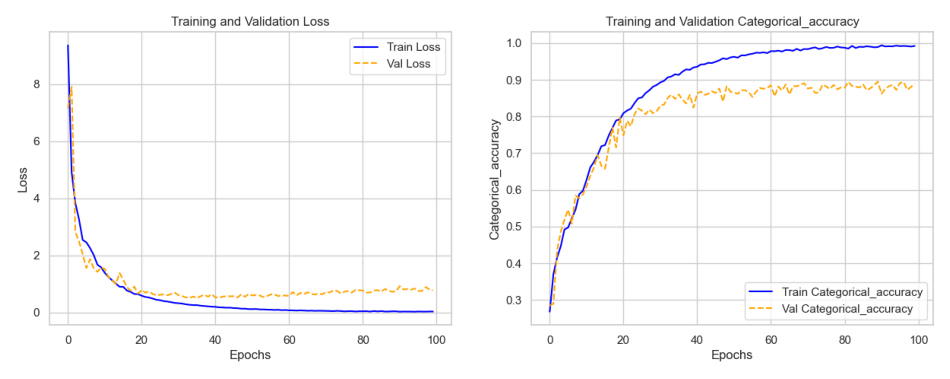

In [57]:
image = mpimg.imread("outputs/dense_01.png")
plt.figure(figsize=(12, 6))
plt.imshow(image)
plt.axis("off")
plt.show()

L'évaluation du modèle dense sur le jeu de test donne :
* une perte de 0.6798
* une précision (categorical_accuracy) de 88.24%

Le modèle semble donc capable de classer correctement les échantillons sonores.  
Le fait que la perte commence élevée et diminue nettement montre que le modèle améliore sa capacité de prédiction pendant l'entraînement.  
Le plateau autour de 0.68 peut indiquer une tendance à l'overfitting.  
Cette tendance est confirmée par le minimum atteinds vers 30 epochs pour la courbe de perte de validation tandisque la courbe d'entrainement continue à diminuer.  

## Itération 2
Ajout d'une couche de dropout pour éviter l'overfitting

In [58]:
# Ajout d'une couche de dropout pour éviter l'overfitting
def model_dense(X_train):
    model = Sequential()
    input_shape = X_train[0].shape
    # Input
    model.add(Flatten(input_shape=input_shape))
    model.add(Dense(256, activation="relu"))
    model.add(Dropout(0.5))  #### <= ajout ici
    model.add(Dense(128, activation="relu"))
    # Output
    model.add(Dense(10, activation="softmax"))
    # Compilation
    model.compile(
        optimizer="adam",
        loss="categorical_crossentropy",
        metrics=["categorical_accuracy"],
    )
    return model

In [59]:
model_dense = model_dense(X_train)
# Résumé du modèle
model_dense.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten_1 (Flatten)         (None, 20)                0         
                                                                 


 dense_3 (Dense)             (None, 256)               5376      
                                                                 
 dropout (Dropout)           (None, 256)               0         
                                                                 
 dense_4 (Dense)             (None, 128)               32896     
                                                                 
 dense_5 (Dense)             (None, 10)                1290      
                                                                 
Total params: 39562 (154.54 KB)
Trainable params: 39562 (154.54 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [60]:
nb_epochs = 200
batch_size = 128

In [61]:
cb = [
    # callbacks.EarlyStopping(patience=10),
    # callbacks.ModelCheckpoint(filepath="modelsav/model.{epoch:02d}-{val_loss:.2f}.h5"),
    # callbacks.TensorBoard("logs", histogram_freq=1),
]

In [62]:
history = model_dense.fit(
    X_train,
    y_train,
    epochs=nb_epochs,
    batch_size=batch_size,
    validation_data=(X_val, y_val),
    callbacks=cb,
)

Epoch 1/200
40/40 [==============================] - 1s 11ms/step - loss: 18.7139 - categorical_accuracy: 0.1861 - val_loss: 3.8665 - val_categorical_accuracy: 0.3471
Epoch 2/200
40/40 [==============================] - 0s 5ms/step - loss: 7.0804 - categorical_accuracy: 0.2410 - val_loss: 2.3015 - val_categorical_accuracy: 0.3582
Epoch 3/200
40/40 [==============================] - 0s 5ms/step - loss: 4.2623 - categorical_accuracy: 0.2826 - val_loss: 1.8278 - val_categorical_accuracy: 0.3676
Epoch 4/200
40/40 [==============================] - 0s 5ms/step - loss: 2.9938 - categorical_accuracy: 0.3187 - val_loss: 1.7874 - val_categorical_accuracy: 0.3759
Epoch 5/200
40/40 [==============================] - 0s 4ms/step - loss: 2.4322 - categorical_accuracy: 0.3269 - val_loss: 1.7342 - val_categorical_accuracy: 0.4059
Epoch 6/200
40/40 [==============================] - 0s 5ms/step - loss: 2.1131 - categorical_accuracy: 0.3475 - val_loss: 1.6801 - val_categorical_accuracy: 0.4135
Epoch 7/

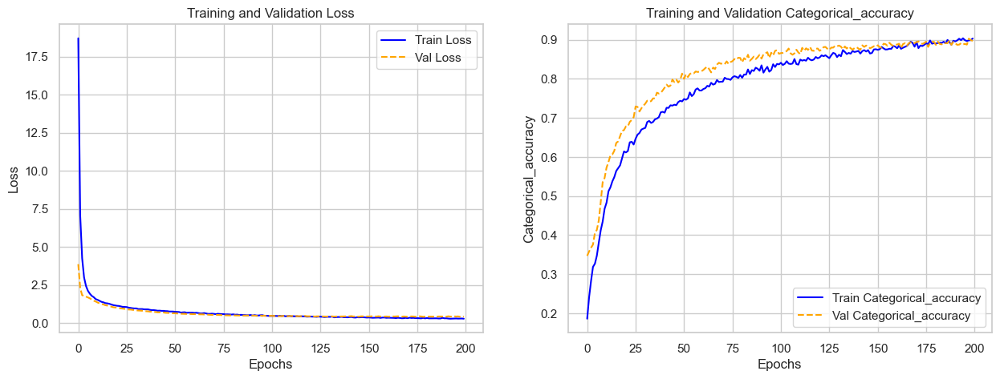

In [63]:
plot_history(history, "categorical_accuracy")

In [64]:
model_dense.evaluate(X_test, y_test)

54/54 [==============================] - 0s 2ms/step - loss: 0.4442 - categorical_accuracy: 0.8918


[0.4442180097103119, 0.8917647004127502]

In [65]:
# %load_ext tensorboard

In [66]:
# %tensorboard --logdir "logs"

### Résultats itération 2

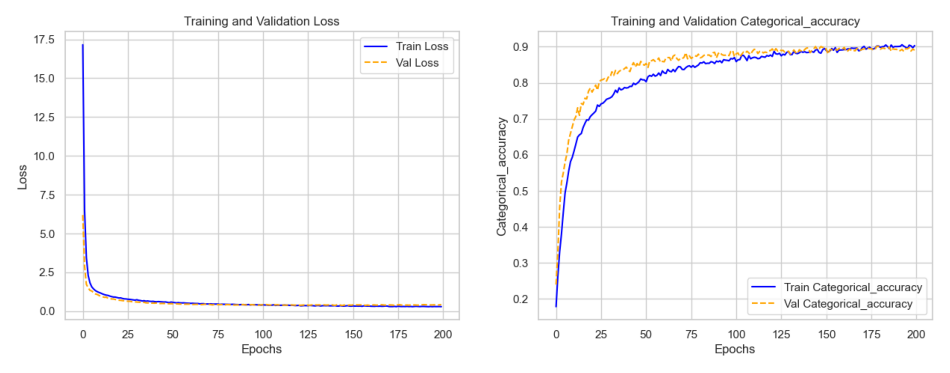

In [67]:
image = mpimg.imread("outputs/dense_02.png")
plt.figure(figsize=(12, 6))
plt.imshow(image)
plt.axis("off")
plt.show()

En ajoutant la couche de dropout, les deux courbes de perte se suivent parfaitement jusqu'à la 100ième epoch jusque au score d'environ 0.45.
Les deux courbes de la categorical accuracy se suivent avec la validation légèrement au dessus du train.

L'ajout du Dropout a eu un effet positif sur la capacité du modèle à généraliser.  
Si les courbes de perte et de précision pour les ensembles d'entraînement et de validation se suivent étroitement, cela indique que le modèle ne surajuste pas significativement.   
Le fait que la précision de validation soit légèrement supérieure à celle d'entraînement est généralement positif, indiquant que le modèle performe bien sur des données non vues.  

La perte a bien été réduite : avec 0.43 sur l'évaluation ce qui est le signe d'un bon équilibre entre la capacité d'apprentissage et la généralisation.   

Il a donc été possible d'augmenter le nombre d'epochs du fait que le modèle continuait à apprendre.
Avec 200 epochs le modèle arrive sur sur les deux jeux à un score de précision de : 0.90 % et se maintient à 0.88% sur l le test.  

Le modèle semble avoir atteint ses limites, d'autres approches de prétraitement seraient à envisager.

# RN Convolutif
    Construire maintenant un réseau de neurones convolutif pour résoudre ce problème de classification. Il devra contenir au minimum les éléments suivants : couches de convolution, couche de "pooling", "dropout", couches cachées complètement connectées. Vous êtes libres d'ajouter d'autres éléments. Attention au format des données en entrée.
    Entraîner le modèle construit à la question 15 et mesurer sa performance.
    Répéter les étapes 15 et 16 avec différentes structures et différentes valeurs des hyperparamètres. Au moins trois nouveaux modèles sont demandés.
    Sauvegarder votre meilleur modèle.

Cette fois nous allons utiliser le dataset avec l'ensemble des données MFCC.

In [68]:
def split(df):
    X = df["MFCC"]
    y = df["Label"]
    X_train_val, X_test, y_train_val, y_test = train_test_split(
        X, y, test_size=0.2, random_state=42
    )
    X_train, X_val, y_train, y_val = train_test_split(
        X_train_val, y_train_val, test_size=0.25, random_state=42
    )
    print(X_train.shape)
    print(X_test.shape)
    print(X_val.shape)
    print(y_train.shape)
    print(y_test.shape)
    print(y_val.shape)
    return X_train, X_test, X_val, y_train, y_test, y_val

In [69]:
X_train, X_test, X_val, y_train, y_test, y_val = split(mfcc_full)

(5099,)
(1700,)
(1700,)
(5099,)
(1700,)
(1700,)


In [70]:
# Conversion des labels en format one-hot
y_train = to_categorical(y_train)
y_val = to_categorical(y_val)
y_test = to_categorical(y_test)

La couche Conv2D attend des données d'entrée avec 4 dimensions, mais elle aura ici des données avec seulement 3 dimensions.   
Les données d'entrée pour un réseau convolutif doivent avoir 4 dimensions : (nombre d'échantillons, hauteur, largeur, canaux).  
Pour les MFCCs, sont des données 2D (coefficients MFCC sur l'axe des temps),il faut donc ajouter une dimension supplémentaire pour simuler les canaux.

In [71]:
# Padding des MFCCs pour qu'ils aient tous la même longueur
def X_padded(X):
    max_length = max(mfcc.shape[1] for mfcc in X)
    X_padded = np.array(
        [
            np.pad(mfcc, ((0, 0), (0, max_length - mfcc.shape[1])), mode="constant")
            for mfcc in X
        ]
    )
    X_padded = np.expand_dims(X_padded, axis=-1)
    return X_padded

In [72]:
X_train_padded = X_padded(X_train)
X_test_padded = X_padded(X_test)
X_val_padded = X_padded(X_val)

## Itération 1

In [73]:
def model_convolutif(X_train):
    model = Sequential()
    input_shape = X_train[0].shape
    model.add(Conv2D(32, (3, 3), activation="relu", input_shape=input_shape))
    model.add(MaxPooling2D((3, 3)))
    model.add(Dropout(0.25))

    model.add(Conv2D(64, (3, 3), activation="sigmoid"))
    model.add(MaxPooling2D((3, 3)))
    model.add(Dropout(0.25))

    model.add(Flatten())
    model.add(Dense(128, activation="relu"))
    model.add(Dropout(0.5))
    model.add(Dense(10, activation="softmax"))  # 10 classes

    model.compile(
        optimizer="RMSprop",
        loss="categorical_crossentropy",
        metrics=["categorical_accuracy"],
    )
    return model

In [74]:
model_convolutif = model_convolutif(X_train_padded)
# Résumé du modèle
model_convolutif.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 18, 343, 32)       320       
                                                                 
 max_pooling2d (MaxPooling2  (None, 6, 114, 32)        0         
 D)                                                              
                                                                 
 dropout_1 (Dropout)         (None, 6, 114, 32)        0         
                                                                 
 conv2d_1 (Conv2D)           (None, 4, 112, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 1, 37, 64)         0         
 g2D)                                                            
                                                                 
 dropout_2 (Dropout)         (None, 1, 37, 64)        

In [75]:
nb_epochs = 100
batch_size = 128

In [76]:
cb = [
    callbacks.EarlyStopping(
        monitor="val_loss",  # Métrique à surveiller
        patience=10,
        mode="min",  # La surveillance s'attend à une diminution de la métrique
        verbose=1,
    ),
    callbacks.ModelCheckpoint(
        filepath="modelsav/conv/model.{epoch:02d}-{val_loss:.2f}",
        monitor="val_loss",
        verbose=1,
        save_best_only=True,
        mode="min",  # 'min' pour minimiser la métrique, 'max' pour maximiser
    ),
    # callbacks.TensorBoard("logs", histogram_freq=1),
]

In [77]:
history = model_convolutif.fit(
    X_train_padded,
    y_train,
    epochs=nb_epochs,
    batch_size=batch_size,
    validation_data=(X_val_padded, y_val),
    callbacks=cb,
)

Epoch 1/100
40/40 [==============================] - ETA: 0s - loss: 2.5786 - categorical_accuracy: 0.1510
Epoch 1: val_loss improved from inf to 2.05190, saving model to modelsav/conv\model.01-2.05
INFO:tensorflow:Assets written to: modelsav/conv\model.01-2.05\assets


INFO:tensorflow:Assets written to: modelsav/conv\model.01-2.05\assets


40/40 [==============================] - 11s 266ms/step - loss: 2.5786 - categorical_accuracy: 0.1510 - val_loss: 2.0519 - val_categorical_accuracy: 0.2806
Epoch 2/100
40/40 [==============================] - ETA: 0s - loss: 2.0812 - categorical_accuracy: 0.2257
Epoch 2: val_loss improved from 2.05190 to 1.90011, saving model to modelsav/conv\model.02-1.90
INFO:tensorflow:Assets written to: modelsav/conv\model.02-1.90\assets


INFO:tensorflow:Assets written to: modelsav/conv\model.02-1.90\assets


40/40 [==============================] - 10s 258ms/step - loss: 2.0812 - categorical_accuracy: 0.2257 - val_loss: 1.9001 - val_categorical_accuracy: 0.3441
Epoch 3/100
40/40 [==============================] - ETA: 0s - loss: 1.9498 - categorical_accuracy: 0.2828
Epoch 3: val_loss improved from 1.90011 to 1.86053, saving model to modelsav/conv\model.03-1.86
INFO:tensorflow:Assets written to: modelsav/conv\model.03-1.86\assets


INFO:tensorflow:Assets written to: modelsav/conv\model.03-1.86\assets


40/40 [==============================] - 10s 248ms/step - loss: 1.9498 - categorical_accuracy: 0.2828 - val_loss: 1.8605 - val_categorical_accuracy: 0.3859
Epoch 4/100
40/40 [==============================] - ETA: 0s - loss: 1.8371 - categorical_accuracy: 0.3361
Epoch 4: val_loss improved from 1.86053 to 1.71786, saving model to modelsav/conv\model.04-1.72
INFO:tensorflow:Assets written to: modelsav/conv\model.04-1.72\assets


INFO:tensorflow:Assets written to: modelsav/conv\model.04-1.72\assets


40/40 [==============================] - 10s 251ms/step - loss: 1.8371 - categorical_accuracy: 0.3361 - val_loss: 1.7179 - val_categorical_accuracy: 0.3929
Epoch 5/100
40/40 [==============================] - ETA: 0s - loss: 1.7365 - categorical_accuracy: 0.3675
Epoch 5: val_loss did not improve from 1.71786
40/40 [==============================] - 9s 226ms/step - loss: 1.7365 - categorical_accuracy: 0.3675 - val_loss: 1.7527 - val_categorical_accuracy: 0.3324
Epoch 6/100
40/40 [==============================] - ETA: 0s - loss: 1.6720 - categorical_accuracy: 0.3999
Epoch 6: val_loss improved from 1.71786 to 1.52925, saving model to modelsav/conv\model.06-1.53
INFO:tensorflow:Assets written to: modelsav/conv\model.06-1.53\assets


INFO:tensorflow:Assets written to: modelsav/conv\model.06-1.53\assets


40/40 [==============================] - 10s 247ms/step - loss: 1.6720 - categorical_accuracy: 0.3999 - val_loss: 1.5293 - val_categorical_accuracy: 0.4547
Epoch 7/100
40/40 [==============================] - ETA: 0s - loss: 1.6339 - categorical_accuracy: 0.4022
Epoch 7: val_loss improved from 1.52925 to 1.45154, saving model to modelsav/conv\model.07-1.45
INFO:tensorflow:Assets written to: modelsav/conv\model.07-1.45\assets


INFO:tensorflow:Assets written to: modelsav/conv\model.07-1.45\assets


40/40 [==============================] - 10s 251ms/step - loss: 1.6339 - categorical_accuracy: 0.4022 - val_loss: 1.4515 - val_categorical_accuracy: 0.5006
Epoch 8/100
40/40 [==============================] - ETA: 0s - loss: 1.5935 - categorical_accuracy: 0.4266
Epoch 8: val_loss did not improve from 1.45154
40/40 [==============================] - 9s 215ms/step - loss: 1.5935 - categorical_accuracy: 0.4266 - val_loss: 1.4731 - val_categorical_accuracy: 0.5065
Epoch 9/100
40/40 [==============================] - ETA: 0s - loss: 1.5338 - categorical_accuracy: 0.4422
Epoch 9: val_loss did not improve from 1.45154
40/40 [==============================] - 9s 220ms/step - loss: 1.5338 - categorical_accuracy: 0.4422 - val_loss: 1.5369 - val_categorical_accuracy: 0.4759
Epoch 10/100
40/40 [==============================] - ETA: 0s - loss: 1.4880 - categorical_accuracy: 0.4691
Epoch 10: val_loss improved from 1.45154 to 1.32560, saving model to modelsav/conv\model.10-1.33
INFO:tensorflow:Asset

INFO:tensorflow:Assets written to: modelsav/conv\model.10-1.33\assets


40/40 [==============================] - 11s 267ms/step - loss: 1.4880 - categorical_accuracy: 0.4691 - val_loss: 1.3256 - val_categorical_accuracy: 0.5588
Epoch 11/100
40/40 [==============================] - ETA: 0s - loss: 1.4488 - categorical_accuracy: 0.4775
Epoch 11: val_loss improved from 1.32560 to 1.31480, saving model to modelsav/conv\model.11-1.31
INFO:tensorflow:Assets written to: modelsav/conv\model.11-1.31\assets


INFO:tensorflow:Assets written to: modelsav/conv\model.11-1.31\assets


40/40 [==============================] - 11s 276ms/step - loss: 1.4488 - categorical_accuracy: 0.4775 - val_loss: 1.3148 - val_categorical_accuracy: 0.5335
Epoch 12/100
40/40 [==============================] - ETA: 0s - loss: 1.4071 - categorical_accuracy: 0.5050
Epoch 12: val_loss improved from 1.31480 to 1.28978, saving model to modelsav/conv\model.12-1.29
INFO:tensorflow:Assets written to: modelsav/conv\model.12-1.29\assets


INFO:tensorflow:Assets written to: modelsav/conv\model.12-1.29\assets


40/40 [==============================] - 11s 273ms/step - loss: 1.4071 - categorical_accuracy: 0.5050 - val_loss: 1.2898 - val_categorical_accuracy: 0.5424
Epoch 13/100
40/40 [==============================] - ETA: 0s - loss: 1.3743 - categorical_accuracy: 0.5228
Epoch 13: val_loss improved from 1.28978 to 1.27654, saving model to modelsav/conv\model.13-1.28
INFO:tensorflow:Assets written to: modelsav/conv\model.13-1.28\assets


INFO:tensorflow:Assets written to: modelsav/conv\model.13-1.28\assets


40/40 [==============================] - 10s 261ms/step - loss: 1.3743 - categorical_accuracy: 0.5228 - val_loss: 1.2765 - val_categorical_accuracy: 0.5424
Epoch 14/100
40/40 [==============================] - ETA: 0s - loss: 1.3717 - categorical_accuracy: 0.5130
Epoch 14: val_loss improved from 1.27654 to 1.25815, saving model to modelsav/conv\model.14-1.26
INFO:tensorflow:Assets written to: modelsav/conv\model.14-1.26\assets


INFO:tensorflow:Assets written to: modelsav/conv\model.14-1.26\assets


40/40 [==============================] - 11s 264ms/step - loss: 1.3717 - categorical_accuracy: 0.5130 - val_loss: 1.2582 - val_categorical_accuracy: 0.5594
Epoch 15/100
40/40 [==============================] - ETA: 0s - loss: 1.2953 - categorical_accuracy: 0.5456
Epoch 15: val_loss improved from 1.25815 to 1.18848, saving model to modelsav/conv\model.15-1.19
INFO:tensorflow:Assets written to: modelsav/conv\model.15-1.19\assets


INFO:tensorflow:Assets written to: modelsav/conv\model.15-1.19\assets


40/40 [==============================] - 11s 270ms/step - loss: 1.2953 - categorical_accuracy: 0.5456 - val_loss: 1.1885 - val_categorical_accuracy: 0.5806
Epoch 16/100
40/40 [==============================] - ETA: 0s - loss: 1.2822 - categorical_accuracy: 0.5411
Epoch 16: val_loss improved from 1.18848 to 1.15621, saving model to modelsav/conv\model.16-1.16
INFO:tensorflow:Assets written to: modelsav/conv\model.16-1.16\assets


INFO:tensorflow:Assets written to: modelsav/conv\model.16-1.16\assets


40/40 [==============================] - 10s 255ms/step - loss: 1.2822 - categorical_accuracy: 0.5411 - val_loss: 1.1562 - val_categorical_accuracy: 0.5835
Epoch 17/100
40/40 [==============================] - ETA: 0s - loss: 1.2401 - categorical_accuracy: 0.5607
Epoch 17: val_loss improved from 1.15621 to 1.13217, saving model to modelsav/conv\model.17-1.13
INFO:tensorflow:Assets written to: modelsav/conv\model.17-1.13\assets


INFO:tensorflow:Assets written to: modelsav/conv\model.17-1.13\assets


40/40 [==============================] - 10s 256ms/step - loss: 1.2401 - categorical_accuracy: 0.5607 - val_loss: 1.1322 - val_categorical_accuracy: 0.6188
Epoch 18/100
40/40 [==============================] - ETA: 0s - loss: 1.2200 - categorical_accuracy: 0.5644
Epoch 18: val_loss did not improve from 1.13217
40/40 [==============================] - 10s 249ms/step - loss: 1.2200 - categorical_accuracy: 0.5644 - val_loss: 1.1538 - val_categorical_accuracy: 0.5918
Epoch 19/100
40/40 [==============================] - ETA: 0s - loss: 1.1946 - categorical_accuracy: 0.5760
Epoch 19: val_loss improved from 1.13217 to 1.12969, saving model to modelsav/conv\model.19-1.13
INFO:tensorflow:Assets written to: modelsav/conv\model.19-1.13\assets


INFO:tensorflow:Assets written to: modelsav/conv\model.19-1.13\assets


40/40 [==============================] - 11s 273ms/step - loss: 1.1946 - categorical_accuracy: 0.5760 - val_loss: 1.1297 - val_categorical_accuracy: 0.5976
Epoch 20/100
40/40 [==============================] - ETA: 0s - loss: 1.1696 - categorical_accuracy: 0.5876
Epoch 20: val_loss did not improve from 1.12969
40/40 [==============================] - 9s 226ms/step - loss: 1.1696 - categorical_accuracy: 0.5876 - val_loss: 1.1370 - val_categorical_accuracy: 0.6118
Epoch 21/100
40/40 [==============================] - ETA: 0s - loss: 1.1696 - categorical_accuracy: 0.5909
Epoch 21: val_loss improved from 1.12969 to 1.05656, saving model to modelsav/conv\model.21-1.06
INFO:tensorflow:Assets written to: modelsav/conv\model.21-1.06\assets


INFO:tensorflow:Assets written to: modelsav/conv\model.21-1.06\assets


40/40 [==============================] - 11s 266ms/step - loss: 1.1696 - categorical_accuracy: 0.5909 - val_loss: 1.0566 - val_categorical_accuracy: 0.6353
Epoch 22/100
40/40 [==============================] - ETA: 0s - loss: 1.1384 - categorical_accuracy: 0.5999
Epoch 22: val_loss improved from 1.05656 to 1.02783, saving model to modelsav/conv\model.22-1.03
INFO:tensorflow:Assets written to: modelsav/conv\model.22-1.03\assets


INFO:tensorflow:Assets written to: modelsav/conv\model.22-1.03\assets


40/40 [==============================] - 10s 261ms/step - loss: 1.1384 - categorical_accuracy: 0.5999 - val_loss: 1.0278 - val_categorical_accuracy: 0.6494
Epoch 23/100
40/40 [==============================] - ETA: 0s - loss: 1.0919 - categorical_accuracy: 0.6117
Epoch 23: val_loss did not improve from 1.02783
40/40 [==============================] - 9s 228ms/step - loss: 1.0919 - categorical_accuracy: 0.6117 - val_loss: 1.1740 - val_categorical_accuracy: 0.6000
Epoch 24/100
40/40 [==============================] - ETA: 0s - loss: 1.0931 - categorical_accuracy: 0.6242
Epoch 24: val_loss improved from 1.02783 to 1.01511, saving model to modelsav/conv\model.24-1.02
INFO:tensorflow:Assets written to: modelsav/conv\model.24-1.02\assets


INFO:tensorflow:Assets written to: modelsav/conv\model.24-1.02\assets


40/40 [==============================] - 10s 252ms/step - loss: 1.0931 - categorical_accuracy: 0.6242 - val_loss: 1.0151 - val_categorical_accuracy: 0.6582
Epoch 25/100
40/40 [==============================] - ETA: 0s - loss: 1.0789 - categorical_accuracy: 0.6252
Epoch 25: val_loss improved from 1.01511 to 0.98669, saving model to modelsav/conv\model.25-0.99
INFO:tensorflow:Assets written to: modelsav/conv\model.25-0.99\assets


INFO:tensorflow:Assets written to: modelsav/conv\model.25-0.99\assets


40/40 [==============================] - 10s 254ms/step - loss: 1.0789 - categorical_accuracy: 0.6252 - val_loss: 0.9867 - val_categorical_accuracy: 0.6682
Epoch 26/100
40/40 [==============================] - ETA: 0s - loss: 1.0546 - categorical_accuracy: 0.6266
Epoch 26: val_loss improved from 0.98669 to 0.96429, saving model to modelsav/conv\model.26-0.96
INFO:tensorflow:Assets written to: modelsav/conv\model.26-0.96\assets


INFO:tensorflow:Assets written to: modelsav/conv\model.26-0.96\assets


40/40 [==============================] - 10s 260ms/step - loss: 1.0546 - categorical_accuracy: 0.6266 - val_loss: 0.9643 - val_categorical_accuracy: 0.6788
Epoch 27/100
40/40 [==============================] - ETA: 0s - loss: 1.0378 - categorical_accuracy: 0.6389
Epoch 27: val_loss improved from 0.96429 to 0.94177, saving model to modelsav/conv\model.27-0.94
INFO:tensorflow:Assets written to: modelsav/conv\model.27-0.94\assets


INFO:tensorflow:Assets written to: modelsav/conv\model.27-0.94\assets


40/40 [==============================] - 10s 260ms/step - loss: 1.0378 - categorical_accuracy: 0.6389 - val_loss: 0.9418 - val_categorical_accuracy: 0.6876
Epoch 28/100
40/40 [==============================] - ETA: 0s - loss: 1.0169 - categorical_accuracy: 0.6444
Epoch 28: val_loss did not improve from 0.94177
40/40 [==============================] - 9s 221ms/step - loss: 1.0169 - categorical_accuracy: 0.6444 - val_loss: 1.0282 - val_categorical_accuracy: 0.6482
Epoch 29/100
40/40 [==============================] - ETA: 0s - loss: 1.0097 - categorical_accuracy: 0.6525
Epoch 29: val_loss improved from 0.94177 to 0.92133, saving model to modelsav/conv\model.29-0.92
INFO:tensorflow:Assets written to: modelsav/conv\model.29-0.92\assets


INFO:tensorflow:Assets written to: modelsav/conv\model.29-0.92\assets


40/40 [==============================] - 10s 253ms/step - loss: 1.0097 - categorical_accuracy: 0.6525 - val_loss: 0.9213 - val_categorical_accuracy: 0.6906
Epoch 30/100
40/40 [==============================] - ETA: 0s - loss: 0.9750 - categorical_accuracy: 0.6591
Epoch 30: val_loss did not improve from 0.92133
40/40 [==============================] - 9s 221ms/step - loss: 0.9750 - categorical_accuracy: 0.6591 - val_loss: 0.9902 - val_categorical_accuracy: 0.6700
Epoch 31/100
40/40 [==============================] - ETA: 0s - loss: 0.9757 - categorical_accuracy: 0.6625
Epoch 31: val_loss did not improve from 0.92133
40/40 [==============================] - 9s 221ms/step - loss: 0.9757 - categorical_accuracy: 0.6625 - val_loss: 0.9419 - val_categorical_accuracy: 0.6694
Epoch 32/100
40/40 [==============================] - ETA: 0s - loss: 0.9586 - categorical_accuracy: 0.6580
Epoch 32: val_loss improved from 0.92133 to 0.86174, saving model to modelsav/conv\model.32-0.86
INFO:tensorflow:A

INFO:tensorflow:Assets written to: modelsav/conv\model.32-0.86\assets


40/40 [==============================] - 10s 260ms/step - loss: 0.9586 - categorical_accuracy: 0.6580 - val_loss: 0.8617 - val_categorical_accuracy: 0.7200
Epoch 33/100
40/40 [==============================] - ETA: 0s - loss: 0.9483 - categorical_accuracy: 0.6670
Epoch 33: val_loss did not improve from 0.86174
40/40 [==============================] - 9s 227ms/step - loss: 0.9483 - categorical_accuracy: 0.6670 - val_loss: 0.9482 - val_categorical_accuracy: 0.6806
Epoch 34/100
40/40 [==============================] - ETA: 0s - loss: 0.9426 - categorical_accuracy: 0.6746
Epoch 34: val_loss did not improve from 0.86174
40/40 [==============================] - 9s 223ms/step - loss: 0.9426 - categorical_accuracy: 0.6746 - val_loss: 0.9319 - val_categorical_accuracy: 0.6806
Epoch 35/100
40/40 [==============================] - ETA: 0s - loss: 0.9166 - categorical_accuracy: 0.6817
Epoch 35: val_loss did not improve from 0.86174
40/40 [==============================] - 9s 219ms/step - loss: 0.9

INFO:tensorflow:Assets written to: modelsav/conv\model.37-0.82\assets


40/40 [==============================] - 11s 279ms/step - loss: 0.8778 - categorical_accuracy: 0.6966 - val_loss: 0.8234 - val_categorical_accuracy: 0.7035
Epoch 38/100
40/40 [==============================] - ETA: 0s - loss: 0.8721 - categorical_accuracy: 0.6937
Epoch 38: val_loss did not improve from 0.82339
40/40 [==============================] - 9s 232ms/step - loss: 0.8721 - categorical_accuracy: 0.6937 - val_loss: 0.8771 - val_categorical_accuracy: 0.7024
Epoch 39/100
40/40 [==============================] - ETA: 0s - loss: 0.8588 - categorical_accuracy: 0.7027
Epoch 39: val_loss did not improve from 0.82339
40/40 [==============================] - 9s 222ms/step - loss: 0.8588 - categorical_accuracy: 0.7027 - val_loss: 0.8706 - val_categorical_accuracy: 0.6947
Epoch 40/100
40/40 [==============================] - ETA: 0s - loss: 0.8371 - categorical_accuracy: 0.7086
Epoch 40: val_loss did not improve from 0.82339
40/40 [==============================] - 9s 219ms/step - loss: 0.8

INFO:tensorflow:Assets written to: modelsav/conv\model.41-0.81\assets


40/40 [==============================] - 10s 254ms/step - loss: 0.8618 - categorical_accuracy: 0.6943 - val_loss: 0.8070 - val_categorical_accuracy: 0.7171
Epoch 42/100
40/40 [==============================] - ETA: 0s - loss: 0.8184 - categorical_accuracy: 0.7109
Epoch 42: val_loss did not improve from 0.80704
40/40 [==============================] - 9s 225ms/step - loss: 0.8184 - categorical_accuracy: 0.7109 - val_loss: 0.8583 - val_categorical_accuracy: 0.6959
Epoch 43/100
40/40 [==============================] - ETA: 0s - loss: 0.8128 - categorical_accuracy: 0.7172
Epoch 43: val_loss did not improve from 0.80704
40/40 [==============================] - 9s 230ms/step - loss: 0.8128 - categorical_accuracy: 0.7172 - val_loss: 0.8918 - val_categorical_accuracy: 0.7035
Epoch 44/100
40/40 [==============================] - ETA: 0s - loss: 0.8069 - categorical_accuracy: 0.7197
Epoch 44: val_loss improved from 0.80704 to 0.79740, saving model to modelsav/conv\model.44-0.80
INFO:tensorflow:A

INFO:tensorflow:Assets written to: modelsav/conv\model.44-0.80\assets


40/40 [==============================] - 12s 290ms/step - loss: 0.8069 - categorical_accuracy: 0.7197 - val_loss: 0.7974 - val_categorical_accuracy: 0.7282
Epoch 45/100
40/40 [==============================] - ETA: 0s - loss: 0.7908 - categorical_accuracy: 0.7233
Epoch 45: val_loss improved from 0.79740 to 0.77984, saving model to modelsav/conv\model.45-0.78
INFO:tensorflow:Assets written to: modelsav/conv\model.45-0.78\assets


INFO:tensorflow:Assets written to: modelsav/conv\model.45-0.78\assets


40/40 [==============================] - 11s 271ms/step - loss: 0.7908 - categorical_accuracy: 0.7233 - val_loss: 0.7798 - val_categorical_accuracy: 0.7394
Epoch 46/100
40/40 [==============================] - ETA: 0s - loss: 0.7741 - categorical_accuracy: 0.7294
Epoch 46: val_loss did not improve from 0.77984
40/40 [==============================] - 9s 238ms/step - loss: 0.7741 - categorical_accuracy: 0.7294 - val_loss: 0.8626 - val_categorical_accuracy: 0.7112
Epoch 47/100
40/40 [==============================] - ETA: 0s - loss: 0.7741 - categorical_accuracy: 0.7309
Epoch 47: val_loss did not improve from 0.77984
40/40 [==============================] - 9s 232ms/step - loss: 0.7741 - categorical_accuracy: 0.7309 - val_loss: 0.7925 - val_categorical_accuracy: 0.7347
Epoch 48/100
40/40 [==============================] - ETA: 0s - loss: 0.7583 - categorical_accuracy: 0.7370
Epoch 48: val_loss did not improve from 0.77984
40/40 [==============================] - 10s 242ms/step - loss: 0.

INFO:tensorflow:Assets written to: modelsav/conv\model.51-0.75\assets


40/40 [==============================] - 10s 258ms/step - loss: 0.7427 - categorical_accuracy: 0.7368 - val_loss: 0.7506 - val_categorical_accuracy: 0.7518
Epoch 52/100
40/40 [==============================] - ETA: 0s - loss: 0.7361 - categorical_accuracy: 0.7421
Epoch 52: val_loss did not improve from 0.75064
40/40 [==============================] - 9s 231ms/step - loss: 0.7361 - categorical_accuracy: 0.7421 - val_loss: 0.7785 - val_categorical_accuracy: 0.7341
Epoch 53/100
40/40 [==============================] - ETA: 0s - loss: 0.7210 - categorical_accuracy: 0.7470
Epoch 53: val_loss did not improve from 0.75064
40/40 [==============================] - 9s 224ms/step - loss: 0.7210 - categorical_accuracy: 0.7470 - val_loss: 0.8294 - val_categorical_accuracy: 0.7088
Epoch 54/100
40/40 [==============================] - ETA: 0s - loss: 0.7066 - categorical_accuracy: 0.7498
Epoch 54: val_loss improved from 0.75064 to 0.75049, saving model to modelsav/conv\model.54-0.75
INFO:tensorflow:A

INFO:tensorflow:Assets written to: modelsav/conv\model.54-0.75\assets


40/40 [==============================] - 10s 248ms/step - loss: 0.7066 - categorical_accuracy: 0.7498 - val_loss: 0.7505 - val_categorical_accuracy: 0.7335
Epoch 55/100
40/40 [==============================] - ETA: 0s - loss: 0.6915 - categorical_accuracy: 0.7527
Epoch 55: val_loss did not improve from 0.75049
40/40 [==============================] - 9s 223ms/step - loss: 0.6915 - categorical_accuracy: 0.7527 - val_loss: 0.7986 - val_categorical_accuracy: 0.7253
Epoch 56/100
40/40 [==============================] - ETA: 0s - loss: 0.6854 - categorical_accuracy: 0.7576
Epoch 56: val_loss did not improve from 0.75049
40/40 [==============================] - 9s 222ms/step - loss: 0.6854 - categorical_accuracy: 0.7576 - val_loss: 0.7689 - val_categorical_accuracy: 0.7347
Epoch 57/100
40/40 [==============================] - ETA: 0s - loss: 0.7015 - categorical_accuracy: 0.7521
Epoch 57: val_loss did not improve from 0.75049
40/40 [==============================] - 9s 220ms/step - loss: 0.7

INFO:tensorflow:Assets written to: modelsav/conv\model.59-0.73\assets


40/40 [==============================] - 10s 250ms/step - loss: 0.6592 - categorical_accuracy: 0.7651 - val_loss: 0.7278 - val_categorical_accuracy: 0.7565
Epoch 60/100
40/40 [==============================] - ETA: 0s - loss: 0.6559 - categorical_accuracy: 0.7705
Epoch 60: val_loss improved from 0.72781 to 0.71559, saving model to modelsav/conv\model.60-0.72
INFO:tensorflow:Assets written to: modelsav/conv\model.60-0.72\assets


INFO:tensorflow:Assets written to: modelsav/conv\model.60-0.72\assets


40/40 [==============================] - 11s 279ms/step - loss: 0.6559 - categorical_accuracy: 0.7705 - val_loss: 0.7156 - val_categorical_accuracy: 0.7535
Epoch 61/100
40/40 [==============================] - ETA: 0s - loss: 0.6660 - categorical_accuracy: 0.7615
Epoch 61: val_loss did not improve from 0.71559
40/40 [==============================] - 10s 247ms/step - loss: 0.6660 - categorical_accuracy: 0.7615 - val_loss: 0.8791 - val_categorical_accuracy: 0.7147
Epoch 62/100
40/40 [==============================] - ETA: 0s - loss: 0.6507 - categorical_accuracy: 0.7707
Epoch 62: val_loss improved from 0.71559 to 0.70198, saving model to modelsav/conv\model.62-0.70
INFO:tensorflow:Assets written to: modelsav/conv\model.62-0.70\assets


INFO:tensorflow:Assets written to: modelsav/conv\model.62-0.70\assets


40/40 [==============================] - 11s 286ms/step - loss: 0.6507 - categorical_accuracy: 0.7707 - val_loss: 0.7020 - val_categorical_accuracy: 0.7618
Epoch 63/100
40/40 [==============================] - ETA: 0s - loss: 0.6608 - categorical_accuracy: 0.7654
Epoch 63: val_loss did not improve from 0.70198
40/40 [==============================] - 11s 275ms/step - loss: 0.6608 - categorical_accuracy: 0.7654 - val_loss: 0.7528 - val_categorical_accuracy: 0.7324
Epoch 64/100
40/40 [==============================] - ETA: 0s - loss: 0.6540 - categorical_accuracy: 0.7735
Epoch 64: val_loss did not improve from 0.70198
40/40 [==============================] - 9s 235ms/step - loss: 0.6540 - categorical_accuracy: 0.7735 - val_loss: 0.7075 - val_categorical_accuracy: 0.7512
Epoch 65/100
40/40 [==============================] - ETA: 0s - loss: 0.6376 - categorical_accuracy: 0.7790
Epoch 65: val_loss improved from 0.70198 to 0.67603, saving model to modelsav/conv\model.65-0.68
INFO:tensorflow:

INFO:tensorflow:Assets written to: modelsav/conv\model.65-0.68\assets


40/40 [==============================] - 11s 276ms/step - loss: 0.6376 - categorical_accuracy: 0.7790 - val_loss: 0.6760 - val_categorical_accuracy: 0.7676
Epoch 66/100
40/40 [==============================] - ETA: 0s - loss: 0.6166 - categorical_accuracy: 0.7817
Epoch 66: val_loss did not improve from 0.67603
40/40 [==============================] - 9s 237ms/step - loss: 0.6166 - categorical_accuracy: 0.7817 - val_loss: 0.7110 - val_categorical_accuracy: 0.7688
Epoch 67/100
40/40 [==============================] - ETA: 0s - loss: 0.6181 - categorical_accuracy: 0.7827
Epoch 67: val_loss did not improve from 0.67603
40/40 [==============================] - 10s 243ms/step - loss: 0.6181 - categorical_accuracy: 0.7827 - val_loss: 0.7391 - val_categorical_accuracy: 0.7571
Epoch 68/100
40/40 [==============================] - ETA: 0s - loss: 0.6068 - categorical_accuracy: 0.7800
Epoch 68: val_loss did not improve from 0.67603
40/40 [==============================] - 10s 257ms/step - loss: 0

INFO:tensorflow:Assets written to: modelsav/conv\model.73-0.66\assets


40/40 [==============================] - 11s 276ms/step - loss: 0.5817 - categorical_accuracy: 0.7980 - val_loss: 0.6598 - val_categorical_accuracy: 0.7718
Epoch 74/100
40/40 [==============================] - ETA: 0s - loss: 0.5692 - categorical_accuracy: 0.8019
Epoch 74: val_loss did not improve from 0.65977
40/40 [==============================] - 10s 239ms/step - loss: 0.5692 - categorical_accuracy: 0.8019 - val_loss: 0.6660 - val_categorical_accuracy: 0.7753
Epoch 75/100
40/40 [==============================] - ETA: 0s - loss: 0.5723 - categorical_accuracy: 0.7945
Epoch 75: val_loss did not improve from 0.65977
40/40 [==============================] - 9s 225ms/step - loss: 0.5723 - categorical_accuracy: 0.7945 - val_loss: 0.7486 - val_categorical_accuracy: 0.7482
Epoch 76/100
40/40 [==============================] - ETA: 0s - loss: 0.5659 - categorical_accuracy: 0.7939
Epoch 76: val_loss did not improve from 0.65977
40/40 [==============================] - 10s 241ms/step - loss: 0

In [78]:
# Supprimer les modèles à part le dernier.
def clean_models(path):
    model_dirs = [d for d in glob.glob(path + "*/") if os.path.isdir(d)]
    model_dirs.sort(key=os.path.getmtime)
    for dir in model_dirs[:-1]:  # Garde le dernier dossier
        shutil.rmtree(dir)
        print(f"Supprimé : {dir}")

In [79]:
clean_models("modelsav/conv/")

Supprimé : modelsav/conv\model.45-1.05\
Supprimé : modelsav/conv\model.01-2.26\
Supprimé : modelsav/conv\model.02-2.08\
Supprimé : modelsav/conv\model.03-1.97\
Supprimé : modelsav/conv\model.06-1.74\
Supprimé : modelsav/conv\model.07-1.65\
Supprimé : modelsav/conv\model.10-1.61\
Supprimé : modelsav/conv\model.12-1.54\
Supprimé : modelsav/conv\model.13-1.46\
Supprimé : modelsav/conv\model.16-1.45\
Supprimé : modelsav/conv\model.19-1.40\
Supprimé : modelsav/conv\model.20-1.39\
Supprimé : modelsav/conv\model.22-1.34\
Supprimé : modelsav/conv\model.23-1.34\
Supprimé : modelsav/conv\model.29-1.32\
Supprimé : modelsav/conv\model.01-2.05\
Supprimé : modelsav/conv\model.02-1.90\
Supprimé : modelsav/conv\model.03-1.86\
Supprimé : modelsav/conv\model.04-1.72\
Supprimé : modelsav/conv\model.06-1.53\
Supprimé : modelsav/conv\model.07-1.45\
Supprimé : modelsav/conv\model.10-1.33\
Supprimé : modelsav/conv\model.11-1.31\
Supprimé : modelsav/conv\model.12-1.29\
Supprimé : modelsav/conv\model.13-1.28\


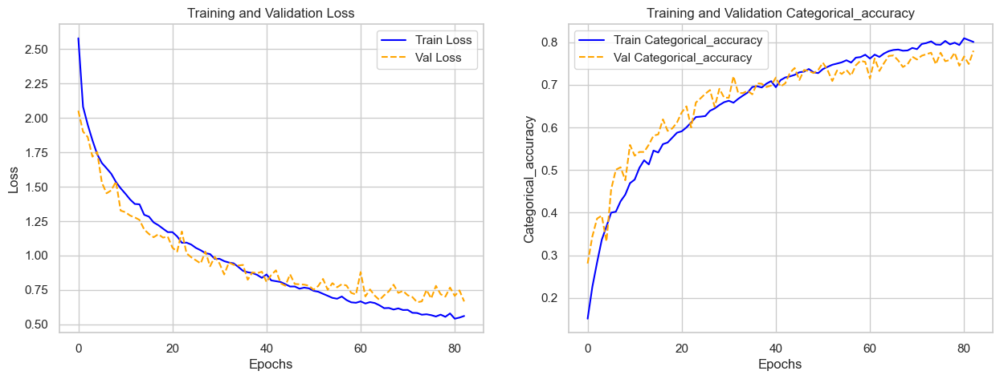

In [80]:
plot_history(history, "categorical_accuracy")

In [81]:
model_convolutif.evaluate(X_test_padded, y_test)

54/54 [==============================] - 1s 18ms/step - loss: 0.7140 - categorical_accuracy: 0.7535


[0.713976263999939, 0.75352942943573]

### Résultats itération 1

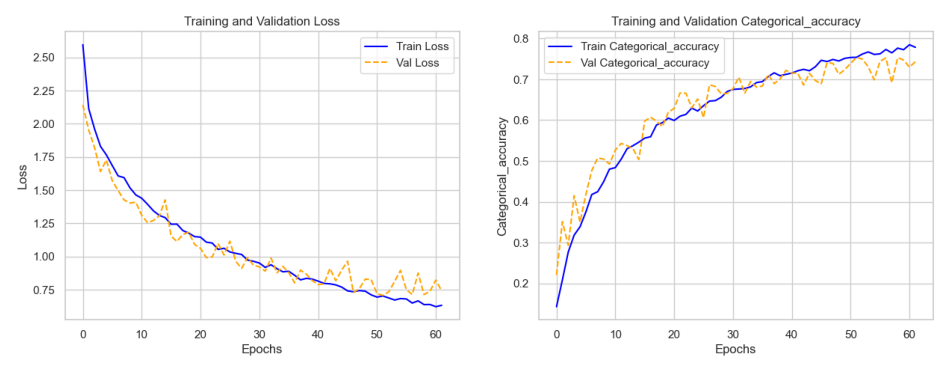

In [82]:
image = mpimg.imread("outputs/conv_01.png")
plt.figure(figsize=(12, 6))
plt.imshow(image)
plt.axis("off")
plt.show()

Le modèle semble arriver à apprendre jusqu'à un certain point.   
Mais l'amélioration du modèle sur les dernières épochs est assez lente, mais ne semble pas terminée, il pourrait être envisagée d'augmenter le nombre d'epochs.  
Le score de précision sur le jeu de test est à 75%.  

# Itération 2 :
Architecture à Plusieurs Couches Convolutives  
Plusieurs couches Conv2D avec un nombre croissant de filtres (par exemple, 32, 64, 128).  
=> Plus de couches peuvent capter des caractéristiques plus complexes. Augmenter le nombre de filtres permet d'élargir l'espace des caractéristiques apprises à chaque couche.

In [83]:
def model_conv2(X_train):
    model = Sequential()
    input_shape = X_train[0].shape
    model.add(Conv2D(32, (3, 3), activation="relu", input_shape=input_shape))
    model.add(MaxPooling2D((2, 2)))
    model.add(Conv2D(64, (3, 3), activation="relu", padding="same"))
    model.add(MaxPooling2D((2, 2)))
    model.add(Conv2D(128, (3, 3), activation="relu", padding="same"))
    model.add(MaxPooling2D((2, 2)))
    model.add(Flatten())
    model.add(Dense(128, activation="relu"))
    model.add(Dropout(0.5))
    model.add(Dense(10, activation="softmax"))  # Pour 10 classes

    model.compile(
        optimizer="adam",
        loss="categorical_crossentropy",
        metrics=["categorical_accuracy"],
    )
    return model

In [84]:
model_conv2 = model_conv2(X_train_padded)
# Résumé du modèle
model_conv2.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_2 (Conv2D)           (None, 18, 343, 32)       320       
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 9, 171, 32)        0         
 g2D)                                                            
                                                                 
 conv2d_3 (Conv2D)           (None, 9, 171, 64)        18496     
                                                                 
 max_pooling2d_3 (MaxPoolin  (None, 4, 85, 64)         0         
 g2D)                                                            
                                                                 
 conv2d_4 (Conv2D)           (None, 4, 85, 128)        73856     
                                                                 
 max_pooling2d_4 (MaxPoolin  (None, 2, 42, 128)       

In [85]:
nb_epochs = 100
batch_size = 128  # 128 !!!!!! #########

In [86]:
cb = [
    callbacks.EarlyStopping(
        monitor="val_loss",  # Métrique à surveiller
        patience=10,  # Nombre d'époques sans amélioration après lesquelles l'entraînement sera arrêté
        mode="min",  # La surveillance s'attend à une diminution de la métrique
        verbose=1,  # Affiche un message lorsque l'entraînement est arrêté
    ),
    callbacks.ModelCheckpoint(
        filepath="modelsav/conv2/model.{epoch:02d}-{val_loss:.2f}",  # Chemin où sauvegarder le modèle
        monitor="val_loss",  # Métrique à surveiller
        verbose=1,  # Affiche un message lors de la sauvegarde
        save_best_only=True,  # Sauvegarde uniquement le meilleur modèle
        mode="min",  # 'min' pour minimiser la métrique, 'max' pour maximiser
    ),
    # callbacks.TensorBoard("logs", histogram_freq=1),
]

In [87]:
history = model_conv2.fit(
    X_train_padded,
    y_train,
    epochs=nb_epochs,
    batch_size=batch_size,
    validation_data=(X_val_padded, y_val),
    callbacks=cb,
)

Epoch 1/100
40/40 [==============================] - ETA: 0s - loss: 5.7080 - categorical_accuracy: 0.1879
Epoch 1: val_loss improved from inf to 1.82896, saving model to modelsav/conv2\model.01-1.83
INFO:tensorflow:Assets written to: modelsav/conv2\model.01-1.83\assets


INFO:tensorflow:Assets written to: modelsav/conv2\model.01-1.83\assets


40/40 [==============================] - 25s 593ms/step - loss: 5.7080 - categorical_accuracy: 0.1879 - val_loss: 1.8290 - val_categorical_accuracy: 0.3576
Epoch 2/100
40/40 [==============================] - ETA: 0s - loss: 1.7340 - categorical_accuracy: 0.3803
Epoch 2: val_loss improved from 1.82896 to 1.37123, saving model to modelsav/conv2\model.02-1.37
INFO:tensorflow:Assets written to: modelsav/conv2\model.02-1.37\assets


INFO:tensorflow:Assets written to: modelsav/conv2\model.02-1.37\assets


40/40 [==============================] - 24s 610ms/step - loss: 1.7340 - categorical_accuracy: 0.3803 - val_loss: 1.3712 - val_categorical_accuracy: 0.5453
Epoch 3/100
40/40 [==============================] - ETA: 0s - loss: 1.4937 - categorical_accuracy: 0.4701
Epoch 3: val_loss improved from 1.37123 to 1.20644, saving model to modelsav/conv2\model.03-1.21
INFO:tensorflow:Assets written to: modelsav/conv2\model.03-1.21\assets


INFO:tensorflow:Assets written to: modelsav/conv2\model.03-1.21\assets


40/40 [==============================] - 23s 580ms/step - loss: 1.4937 - categorical_accuracy: 0.4701 - val_loss: 1.2064 - val_categorical_accuracy: 0.5965
Epoch 4/100
40/40 [==============================] - ETA: 0s - loss: 1.3235 - categorical_accuracy: 0.5411
Epoch 4: val_loss improved from 1.20644 to 1.07376, saving model to modelsav/conv2\model.04-1.07
INFO:tensorflow:Assets written to: modelsav/conv2\model.04-1.07\assets


INFO:tensorflow:Assets written to: modelsav/conv2\model.04-1.07\assets


40/40 [==============================] - 22s 552ms/step - loss: 1.3235 - categorical_accuracy: 0.5411 - val_loss: 1.0738 - val_categorical_accuracy: 0.6253
Epoch 5/100
40/40 [==============================] - ETA: 0s - loss: 1.2115 - categorical_accuracy: 0.5817
Epoch 5: val_loss improved from 1.07376 to 1.00588, saving model to modelsav/conv2\model.05-1.01
INFO:tensorflow:Assets written to: modelsav/conv2\model.05-1.01\assets


INFO:tensorflow:Assets written to: modelsav/conv2\model.05-1.01\assets


40/40 [==============================] - 22s 556ms/step - loss: 1.2115 - categorical_accuracy: 0.5817 - val_loss: 1.0059 - val_categorical_accuracy: 0.6482
Epoch 6/100
40/40 [==============================] - ETA: 0s - loss: 1.1038 - categorical_accuracy: 0.6311
Epoch 6: val_loss improved from 1.00588 to 0.95074, saving model to modelsav/conv2\model.06-0.95
INFO:tensorflow:Assets written to: modelsav/conv2\model.06-0.95\assets


INFO:tensorflow:Assets written to: modelsav/conv2\model.06-0.95\assets


40/40 [==============================] - 21s 533ms/step - loss: 1.1038 - categorical_accuracy: 0.6311 - val_loss: 0.9507 - val_categorical_accuracy: 0.6976
Epoch 7/100
40/40 [==============================] - ETA: 0s - loss: 1.0027 - categorical_accuracy: 0.6554
Epoch 7: val_loss improved from 0.95074 to 0.83532, saving model to modelsav/conv2\model.07-0.84
INFO:tensorflow:Assets written to: modelsav/conv2\model.07-0.84\assets


INFO:tensorflow:Assets written to: modelsav/conv2\model.07-0.84\assets


40/40 [==============================] - 22s 542ms/step - loss: 1.0027 - categorical_accuracy: 0.6554 - val_loss: 0.8353 - val_categorical_accuracy: 0.7229
Epoch 8/100
40/40 [==============================] - ETA: 0s - loss: 0.8972 - categorical_accuracy: 0.6844
Epoch 8: val_loss improved from 0.83532 to 0.79725, saving model to modelsav/conv2\model.08-0.80
INFO:tensorflow:Assets written to: modelsav/conv2\model.08-0.80\assets


INFO:tensorflow:Assets written to: modelsav/conv2\model.08-0.80\assets


40/40 [==============================] - 22s 563ms/step - loss: 0.8972 - categorical_accuracy: 0.6844 - val_loss: 0.7972 - val_categorical_accuracy: 0.7335
Epoch 9/100
40/40 [==============================] - ETA: 0s - loss: 0.8064 - categorical_accuracy: 0.7166
Epoch 9: val_loss improved from 0.79725 to 0.75992, saving model to modelsav/conv2\model.09-0.76
INFO:tensorflow:Assets written to: modelsav/conv2\model.09-0.76\assets


INFO:tensorflow:Assets written to: modelsav/conv2\model.09-0.76\assets


40/40 [==============================] - 22s 561ms/step - loss: 0.8064 - categorical_accuracy: 0.7166 - val_loss: 0.7599 - val_categorical_accuracy: 0.7459
Epoch 10/100
40/40 [==============================] - ETA: 0s - loss: 0.7459 - categorical_accuracy: 0.7409
Epoch 10: val_loss improved from 0.75992 to 0.70458, saving model to modelsav/conv2\model.10-0.70
INFO:tensorflow:Assets written to: modelsav/conv2\model.10-0.70\assets


INFO:tensorflow:Assets written to: modelsav/conv2\model.10-0.70\assets


40/40 [==============================] - 21s 531ms/step - loss: 0.7459 - categorical_accuracy: 0.7409 - val_loss: 0.7046 - val_categorical_accuracy: 0.7653
Epoch 11/100
40/40 [==============================] - ETA: 0s - loss: 0.6827 - categorical_accuracy: 0.7629
Epoch 11: val_loss improved from 0.70458 to 0.70055, saving model to modelsav/conv2\model.11-0.70
INFO:tensorflow:Assets written to: modelsav/conv2\model.11-0.70\assets


INFO:tensorflow:Assets written to: modelsav/conv2\model.11-0.70\assets


40/40 [==============================] - 22s 552ms/step - loss: 0.6827 - categorical_accuracy: 0.7629 - val_loss: 0.7005 - val_categorical_accuracy: 0.7706
Epoch 12/100
40/40 [==============================] - ETA: 0s - loss: 0.6256 - categorical_accuracy: 0.7792
Epoch 12: val_loss improved from 0.70055 to 0.60008, saving model to modelsav/conv2\model.12-0.60
INFO:tensorflow:Assets written to: modelsav/conv2\model.12-0.60\assets


INFO:tensorflow:Assets written to: modelsav/conv2\model.12-0.60\assets


40/40 [==============================] - 21s 533ms/step - loss: 0.6256 - categorical_accuracy: 0.7792 - val_loss: 0.6001 - val_categorical_accuracy: 0.8012
Epoch 13/100
40/40 [==============================] - ETA: 0s - loss: 0.5584 - categorical_accuracy: 0.8092
Epoch 13: val_loss did not improve from 0.60008
40/40 [==============================] - 20s 499ms/step - loss: 0.5584 - categorical_accuracy: 0.8092 - val_loss: 0.6236 - val_categorical_accuracy: 0.7924
Epoch 14/100
40/40 [==============================] - ETA: 0s - loss: 0.5115 - categorical_accuracy: 0.8149
Epoch 14: val_loss improved from 0.60008 to 0.58652, saving model to modelsav/conv2\model.14-0.59
INFO:tensorflow:Assets written to: modelsav/conv2\model.14-0.59\assets


INFO:tensorflow:Assets written to: modelsav/conv2\model.14-0.59\assets


40/40 [==============================] - 22s 557ms/step - loss: 0.5115 - categorical_accuracy: 0.8149 - val_loss: 0.5865 - val_categorical_accuracy: 0.8112
Epoch 15/100
40/40 [==============================] - ETA: 0s - loss: 0.4689 - categorical_accuracy: 0.8417
Epoch 15: val_loss improved from 0.58652 to 0.56204, saving model to modelsav/conv2\model.15-0.56
INFO:tensorflow:Assets written to: modelsav/conv2\model.15-0.56\assets


INFO:tensorflow:Assets written to: modelsav/conv2\model.15-0.56\assets


40/40 [==============================] - 21s 537ms/step - loss: 0.4689 - categorical_accuracy: 0.8417 - val_loss: 0.5620 - val_categorical_accuracy: 0.8147
Epoch 16/100
40/40 [==============================] - ETA: 0s - loss: 0.4401 - categorical_accuracy: 0.8525
Epoch 16: val_loss did not improve from 0.56204
40/40 [==============================] - 20s 501ms/step - loss: 0.4401 - categorical_accuracy: 0.8525 - val_loss: 0.5679 - val_categorical_accuracy: 0.8112
Epoch 17/100
40/40 [==============================] - ETA: 0s - loss: 0.4205 - categorical_accuracy: 0.8572
Epoch 17: val_loss did not improve from 0.56204
40/40 [==============================] - 20s 506ms/step - loss: 0.4205 - categorical_accuracy: 0.8572 - val_loss: 0.5686 - val_categorical_accuracy: 0.8182
Epoch 18/100
40/40 [==============================] - ETA: 0s - loss: 0.3624 - categorical_accuracy: 0.8713
Epoch 18: val_loss improved from 0.56204 to 0.54848, saving model to modelsav/conv2\model.18-0.55
INFO:tensorflo

INFO:tensorflow:Assets written to: modelsav/conv2\model.18-0.55\assets


40/40 [==============================] - 23s 566ms/step - loss: 0.3624 - categorical_accuracy: 0.8713 - val_loss: 0.5485 - val_categorical_accuracy: 0.8200
Epoch 19/100
40/40 [==============================] - ETA: 0s - loss: 0.3366 - categorical_accuracy: 0.8837
Epoch 19: val_loss improved from 0.54848 to 0.52552, saving model to modelsav/conv2\model.19-0.53
INFO:tensorflow:Assets written to: modelsav/conv2\model.19-0.53\assets


INFO:tensorflow:Assets written to: modelsav/conv2\model.19-0.53\assets


40/40 [==============================] - 21s 533ms/step - loss: 0.3366 - categorical_accuracy: 0.8837 - val_loss: 0.5255 - val_categorical_accuracy: 0.8435
Epoch 20/100
40/40 [==============================] - ETA: 0s - loss: 0.3171 - categorical_accuracy: 0.8912
Epoch 20: val_loss improved from 0.52552 to 0.52054, saving model to modelsav/conv2\model.20-0.52
INFO:tensorflow:Assets written to: modelsav/conv2\model.20-0.52\assets


INFO:tensorflow:Assets written to: modelsav/conv2\model.20-0.52\assets


40/40 [==============================] - 22s 541ms/step - loss: 0.3171 - categorical_accuracy: 0.8912 - val_loss: 0.5205 - val_categorical_accuracy: 0.8376
Epoch 21/100
40/40 [==============================] - ETA: 0s - loss: 0.2865 - categorical_accuracy: 0.8949
Epoch 21: val_loss did not improve from 0.52054
40/40 [==============================] - 20s 503ms/step - loss: 0.2865 - categorical_accuracy: 0.8949 - val_loss: 0.5755 - val_categorical_accuracy: 0.8329
Epoch 22/100
40/40 [==============================] - ETA: 0s - loss: 0.3082 - categorical_accuracy: 0.8966
Epoch 22: val_loss did not improve from 0.52054
40/40 [==============================] - 21s 529ms/step - loss: 0.3082 - categorical_accuracy: 0.8966 - val_loss: 0.5605 - val_categorical_accuracy: 0.8359
Epoch 23/100
40/40 [==============================] - ETA: 0s - loss: 0.2464 - categorical_accuracy: 0.9135
Epoch 23: val_loss did not improve from 0.52054
40/40 [==============================] - 20s 499ms/step - loss: 

In [88]:
clean_models("modelsav/conv2/")

Supprimé : modelsav/conv2\model.19-0.52\
Supprimé : modelsav/conv2\model.01-1.83\
Supprimé : modelsav/conv2\model.02-1.37\
Supprimé : modelsav/conv2\model.03-1.21\
Supprimé : modelsav/conv2\model.04-1.07\
Supprimé : modelsav/conv2\model.05-1.01\
Supprimé : modelsav/conv2\model.06-0.95\
Supprimé : modelsav/conv2\model.07-0.84\
Supprimé : modelsav/conv2\model.08-0.80\
Supprimé : modelsav/conv2\model.09-0.76\
Supprimé : modelsav/conv2\model.10-0.70\
Supprimé : modelsav/conv2\model.11-0.70\
Supprimé : modelsav/conv2\model.12-0.60\
Supprimé : modelsav/conv2\model.14-0.59\
Supprimé : modelsav/conv2\model.15-0.56\
Supprimé : modelsav/conv2\model.18-0.55\
Supprimé : modelsav/conv2\model.19-0.53\


In [89]:
model_conv2.evaluate(X_test_padded, y_test)

54/54 [==============================] - 2s 36ms/step - loss: 0.7630 - categorical_accuracy: 0.8288


[0.7629980444908142, 0.8288235068321228]

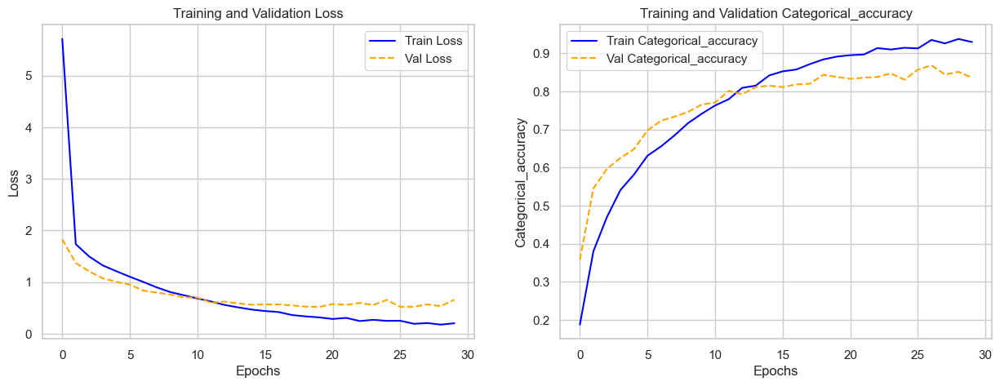

In [90]:
plot_history(history, "categorical_accuracy")

### Résultats itération 2 :


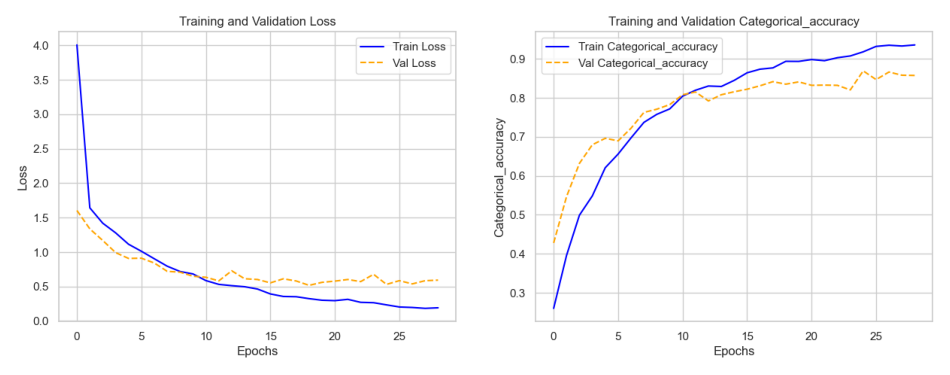

In [91]:
image = mpimg.imread("outputs/conv_02.png")
plt.figure(figsize=(12, 6))
plt.imshow(image)
plt.axis("off")
plt.show()

L'apprentissage semble accéléré.  
Le modèle s'arrête après un moins grand nombre d'epochs.  
Le score de précision sur le jeu de test atteint 0.84% ce qui est une amélioration pour un nombre moindre d'epochs.  

# Itération 3 :
Réseau avec de Grands Kernels et Batch Normalization :  
Utiliser des kernels plus grands (par exemple, (5, 5)) dans les premières couches Conv2D.  
Ajouter des couches de Batch Normalization après chaque couche Conv2D.  
=> Des kernels plus grands peuvent capturer des caractéristiques plus globales au début. La Batch Normalization peut accélérer l'entraînement et stabiliser l'apprentissage.  

In [92]:
def model_conv3(X_train):
    model = Sequential()
    input_shape = X_train[0].shape
    model.add(Conv2D(16, (5, 5), activation="relu", input_shape=input_shape))
    model.add(BatchNormalization())
    model.add(MaxPooling2D((2, 2)))
    model.add(Conv2D(32, (5, 5), activation="relu"))
    model.add(BatchNormalization())
    model.add(MaxPooling2D((2, 2)))
    model.add(Flatten())
    model.add(Dense(64, activation="relu"))
    model.add(BatchNormalization())
    model.add(Dropout(0.5))
    model.add(Dense(10, activation="softmax"))

    model.compile(
        optimizer="adam",
        loss="categorical_crossentropy",
        metrics=["categorical_accuracy"],
    )
    return model

In [93]:
model_conv3 = model_conv3(X_train_padded)
# Résumé du modèle
model_conv3.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_5 (Conv2D)           (None, 16, 341, 16)       416       
                                                                 
 batch_normalization (Batch  (None, 16, 341, 16)       64        
 Normalization)                                                  
                                                                 
 max_pooling2d_5 (MaxPoolin  (None, 8, 170, 16)        0         
 g2D)                                                            
                                                                 
 conv2d_6 (Conv2D)           (None, 4, 166, 32)        12832     
                                                                 
 batch_normalization_1 (Bat  (None, 4, 166, 32)        128       
 chNormalization)                                                
                                                      

In [94]:
nb_epochs = 100
batch_size = 32

In [95]:
cb = [
    callbacks.EarlyStopping(
        monitor="val_loss",  # Métrique à surveiller
        patience=10,  # Nombre d'époques sans amélioration après lesquelles l'entraînement sera arrêté
        mode="min",  # La surveillance s'attend à une diminution de la métrique
        verbose=1,  # Affiche un message lorsque l'entraînement est arrêté
    ),
    callbacks.ModelCheckpoint(
        filepath="modelsav/conv3/model.{epoch:02d}-{val_loss:.2f}",  # Chemin où sauvegarder le modèle
        monitor="val_loss",  # Métrique à surveiller
        verbose=1,  # Affiche un message lors de la sauvegarde
        save_best_only=True,  # Sauvegarde uniquement le meilleur modèle
        mode="min",  # 'min' pour minimiser la métrique, 'max' pour maximiser
    ),
    # callbacks.TensorBoard("logs", histogram_freq=1),
]

In [96]:
history = model_conv3.fit(
    X_train_padded,
    y_train,
    epochs=nb_epochs,
    batch_size=batch_size,
    validation_data=(X_val_padded, y_val),
    callbacks=cb,
)

Epoch 1/100
159/160 [============================>.] - ETA: 0s - loss: 1.7177 - categorical_accuracy: 0.4505
Epoch 1: val_loss improved from inf to 1.43368, saving model to modelsav/conv3\model.01-1.43
INFO:tensorflow:Assets written to: modelsav/conv3\model.01-1.43\assets


INFO:tensorflow:Assets written to: modelsav/conv3\model.01-1.43\assets


160/160 [==============================] - 16s 93ms/step - loss: 1.7173 - categorical_accuracy: 0.4505 - val_loss: 1.4337 - val_categorical_accuracy: 0.5124
Epoch 2/100
159/160 [============================>.] - ETA: 0s - loss: 1.2853 - categorical_accuracy: 0.5790
Epoch 2: val_loss improved from 1.43368 to 1.08405, saving model to modelsav/conv3\model.02-1.08
INFO:tensorflow:Assets written to: modelsav/conv3\model.02-1.08\assets


INFO:tensorflow:Assets written to: modelsav/conv3\model.02-1.08\assets


160/160 [==============================] - 15s 91ms/step - loss: 1.2860 - categorical_accuracy: 0.5787 - val_loss: 1.0841 - val_categorical_accuracy: 0.6394
Epoch 3/100
159/160 [============================>.] - ETA: 0s - loss: 1.0573 - categorical_accuracy: 0.6541
Epoch 3: val_loss improved from 1.08405 to 0.94073, saving model to modelsav/conv3\model.03-0.94
INFO:tensorflow:Assets written to: modelsav/conv3\model.03-0.94\assets


INFO:tensorflow:Assets written to: modelsav/conv3\model.03-0.94\assets


160/160 [==============================] - 15s 92ms/step - loss: 1.0577 - categorical_accuracy: 0.6542 - val_loss: 0.9407 - val_categorical_accuracy: 0.6888
Epoch 4/100
159/160 [============================>.] - ETA: 0s - loss: 0.9115 - categorical_accuracy: 0.6930
Epoch 4: val_loss improved from 0.94073 to 0.91387, saving model to modelsav/conv3\model.04-0.91
INFO:tensorflow:Assets written to: modelsav/conv3\model.04-0.91\assets


INFO:tensorflow:Assets written to: modelsav/conv3\model.04-0.91\assets


160/160 [==============================] - 15s 92ms/step - loss: 0.9110 - categorical_accuracy: 0.6933 - val_loss: 0.9139 - val_categorical_accuracy: 0.6976
Epoch 5/100
159/160 [============================>.] - ETA: 0s - loss: 0.8617 - categorical_accuracy: 0.7182
Epoch 5: val_loss did not improve from 0.91387
160/160 [==============================] - 13s 81ms/step - loss: 0.8623 - categorical_accuracy: 0.7180 - val_loss: 1.0018 - val_categorical_accuracy: 0.6800
Epoch 6/100
159/160 [============================>.] - ETA: 0s - loss: 0.8161 - categorical_accuracy: 0.7288
Epoch 6: val_loss improved from 0.91387 to 0.70091, saving model to modelsav/conv3\model.06-0.70
INFO:tensorflow:Assets written to: modelsav/conv3\model.06-0.70\assets


INFO:tensorflow:Assets written to: modelsav/conv3\model.06-0.70\assets


160/160 [==============================] - 14s 90ms/step - loss: 0.8154 - categorical_accuracy: 0.7290 - val_loss: 0.7009 - val_categorical_accuracy: 0.7488
Epoch 7/100
159/160 [============================>.] - ETA: 0s - loss: 0.6557 - categorical_accuracy: 0.7785
Epoch 7: val_loss improved from 0.70091 to 0.63848, saving model to modelsav/conv3\model.07-0.64
INFO:tensorflow:Assets written to: modelsav/conv3\model.07-0.64\assets


INFO:tensorflow:Assets written to: modelsav/conv3\model.07-0.64\assets


160/160 [==============================] - 14s 91ms/step - loss: 0.6553 - categorical_accuracy: 0.7786 - val_loss: 0.6385 - val_categorical_accuracy: 0.7947
Epoch 8/100
159/160 [============================>.] - ETA: 0s - loss: 0.5794 - categorical_accuracy: 0.8105
Epoch 8: val_loss improved from 0.63848 to 0.60752, saving model to modelsav/conv3\model.08-0.61
INFO:tensorflow:Assets written to: modelsav/conv3\model.08-0.61\assets


INFO:tensorflow:Assets written to: modelsav/conv3\model.08-0.61\assets


160/160 [==============================] - 15s 96ms/step - loss: 0.5797 - categorical_accuracy: 0.8102 - val_loss: 0.6075 - val_categorical_accuracy: 0.7994
Epoch 9/100
159/160 [============================>.] - ETA: 0s - loss: 0.5282 - categorical_accuracy: 0.8245
Epoch 9: val_loss did not improve from 0.60752
160/160 [==============================] - 13s 78ms/step - loss: 0.5288 - categorical_accuracy: 0.8243 - val_loss: 0.7035 - val_categorical_accuracy: 0.7665
Epoch 10/100
159/160 [============================>.] - ETA: 0s - loss: 0.4713 - categorical_accuracy: 0.8518
Epoch 10: val_loss improved from 0.60752 to 0.59832, saving model to modelsav/conv3\model.10-0.60
INFO:tensorflow:Assets written to: modelsav/conv3\model.10-0.60\assets


INFO:tensorflow:Assets written to: modelsav/conv3\model.10-0.60\assets


160/160 [==============================] - 14s 90ms/step - loss: 0.4716 - categorical_accuracy: 0.8517 - val_loss: 0.5983 - val_categorical_accuracy: 0.7959
Epoch 11/100
159/160 [============================>.] - ETA: 0s - loss: 0.4361 - categorical_accuracy: 0.8607
Epoch 11: val_loss did not improve from 0.59832
160/160 [==============================] - 13s 79ms/step - loss: 0.4364 - categorical_accuracy: 0.8602 - val_loss: 0.6215 - val_categorical_accuracy: 0.7935
Epoch 12/100
159/160 [============================>.] - ETA: 0s - loss: 0.3988 - categorical_accuracy: 0.8677
Epoch 12: val_loss did not improve from 0.59832
160/160 [==============================] - 13s 81ms/step - loss: 0.3994 - categorical_accuracy: 0.8676 - val_loss: 0.6000 - val_categorical_accuracy: 0.8041
Epoch 13/100
159/160 [============================>.] - ETA: 0s - loss: 0.3663 - categorical_accuracy: 0.8781
Epoch 13: val_loss did not improve from 0.59832
160/160 [==============================] - 13s 84ms/ste

INFO:tensorflow:Assets written to: modelsav/conv3\model.14-0.60\assets


160/160 [==============================] - 15s 92ms/step - loss: 0.2880 - categorical_accuracy: 0.9029 - val_loss: 0.5962 - val_categorical_accuracy: 0.8000
Epoch 15/100
159/160 [============================>.] - ETA: 0s - loss: 0.3163 - categorical_accuracy: 0.8960
Epoch 15: val_loss did not improve from 0.59617
160/160 [==============================] - 13s 81ms/step - loss: 0.3170 - categorical_accuracy: 0.8957 - val_loss: 0.6596 - val_categorical_accuracy: 0.7871
Epoch 16/100
159/160 [============================>.] - ETA: 0s - loss: 0.2766 - categorical_accuracy: 0.9123
Epoch 16: val_loss did not improve from 0.59617
160/160 [==============================] - 13s 80ms/step - loss: 0.2773 - categorical_accuracy: 0.9119 - val_loss: 0.6027 - val_categorical_accuracy: 0.8147
Epoch 17/100
159/160 [============================>.] - ETA: 0s - loss: 0.2178 - categorical_accuracy: 0.9271
Epoch 17: val_loss did not improve from 0.59617
160/160 [==============================] - 12s 76ms/ste

In [97]:
clean_models("modelsav/conv3/")

Supprimé : modelsav/conv3\model.15-0.55\
Supprimé : modelsav/conv3\model.01-1.43\
Supprimé : modelsav/conv3\model.02-1.08\
Supprimé : modelsav/conv3\model.03-0.94\
Supprimé : modelsav/conv3\model.04-0.91\
Supprimé : modelsav/conv3\model.06-0.70\
Supprimé : modelsav/conv3\model.07-0.64\
Supprimé : modelsav/conv3\model.08-0.61\
Supprimé : modelsav/conv3\model.10-0.60\


In [98]:
model_conv3.evaluate(X_test_padded, y_test)

 1/54 [..............................] - ETA: 2s - loss: 0.8467 - categorical_accuracy: 0.7500

54/54 [==============================] - 1s 18ms/step - loss: 0.7444 - categorical_accuracy: 0.7800


[0.7443686127662659, 0.7799999713897705]

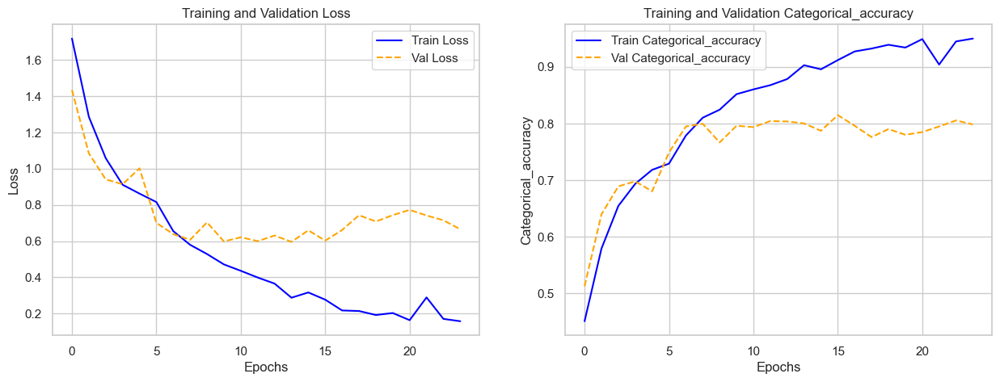

In [99]:
plot_history(history, "categorical_accuracy")

### Résultats itération 3

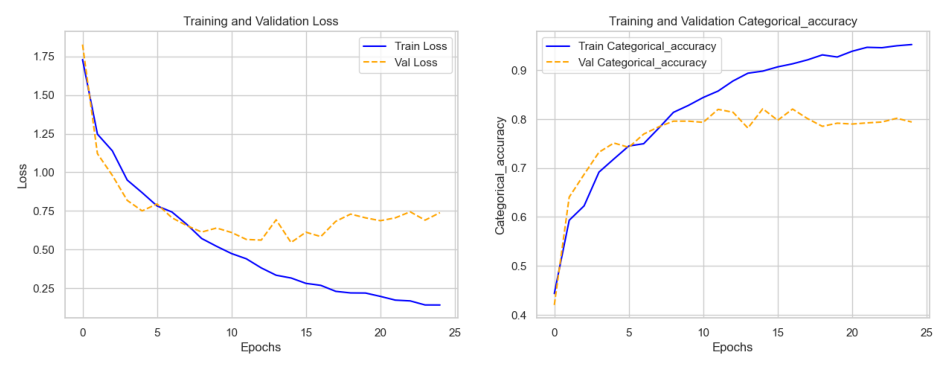

In [100]:
image = mpimg.imread("outputs/conv_03.png")
plt.figure(figsize=(12, 6))
plt.imshow(image)
plt.axis("off")
plt.show()

Le modèle arrête rapidement d'apprendre : vers la 10 epochs la perte sur la validation ne s'améliore plus, tandisque qu'elle diminue pour l'entrainement.   
Il y a de l'overfitting.

# Itération 4:
Modèle avec Pooling Global et Régularisation L2 :
Remplacer le dernier MaxPooling2D par un GlobalAveragePooling2D.
Ajouter une régularisation L2 aux couches denses.
=> Le Global Average Pooling réduit le surajustement en réduisant le nombre total de paramètres. La régularisation L2 aide à contrôler l'overfitting en pénalisant les poids trop importants.

In [101]:
def model_conv4(X_train):
    model = Sequential()
    input_shape = X_train[0].shape
    model.add(
        Conv2D(
            32,
            (3, 3),
            activation="relu",
            input_shape=input_shape,
            kernel_regularizer=l2(0.01),
        )
    )
    model.add(GlobalAveragePooling2D())
    model.add(Dense(128, activation="relu", kernel_regularizer=l2(0.01)))
    model.add(Dropout(0.5))
    model.add(Dense(10, activation="softmax"))

    model.compile(
        optimizer="RMSprop",
        loss="categorical_crossentropy",
        metrics=["categorical_accuracy"],
    )
    return model

In [102]:
model_conv4 = model_conv4(X_train_padded)
# Résumé du modèle
model_conv4.summary()

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_7 (Conv2D)           (None, 18, 343, 32)       320       
                                                                 
 global_average_pooling2d (  (None, 32)                0         
 GlobalAveragePooling2D)                                         
                                                                 
 dense_12 (Dense)            (None, 128)               4224      
                                                                 
 dropout_6 (Dropout)         (None, 128)               0         
                                                                 
 dense_13 (Dense)            (None, 10)                1290      


                                                                 
Total params: 5834 (22.79 KB)
Trainable params: 5834 (22.79 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [103]:
nb_epochs = 100
batch_size = 32

In [104]:
cb = [
    callbacks.EarlyStopping(
        monitor="val_loss",  # Métrique à surveiller
        patience=10,  # Nombre d'époques sans amélioration après lesquelles l'entraînement sera arrêté
        mode="min",  # La surveillance s'attend à une diminution de la métrique
        verbose=1,  # Affiche un message lorsque l'entraînement est arrêté
    ),
    callbacks.ModelCheckpoint(
        filepath="modelsav/conv4/model.{epoch:02d}-{val_loss:.2f}",  # Chemin où sauvegarder le modèle
        monitor="val_loss",  # Métrique à surveiller
        verbose=1,  # Affiche un message lors de la sauvegarde
        save_best_only=True,  # Sauvegarde uniquement le meilleur modèle
        mode="min",  # 'min' pour minimiser la métrique, 'max' pour maximiser
    ),
    # callbacks.TensorBoard("logs", histogram_freq=1),
]

In [105]:
history = model_conv4.fit(
    X_train_padded,
    y_train,
    epochs=nb_epochs,
    batch_size=batch_size,
    validation_data=(X_val_padded, y_val),
    callbacks=cb,
)

Epoch 1/100
159/160 [============================>.] - ETA: 0s - loss: 2.4849 - categorical_accuracy: 0.2482
Epoch 1: val_loss improved from inf to 2.12380, saving model to modelsav/conv4\model.01-2.12
INFO:tensorflow:Assets written to: modelsav/conv4\model.01-2.12\assets


INFO:tensorflow:Assets written to: modelsav/conv4\model.01-2.12\assets


160/160 [==============================] - 8s 45ms/step - loss: 2.4848 - categorical_accuracy: 0.2479 - val_loss: 2.1238 - val_categorical_accuracy: 0.3529
Epoch 2/100
159/160 [============================>.] - ETA: 0s - loss: 2.1092 - categorical_accuracy: 0.3310
Epoch 2: val_loss improved from 2.12380 to 1.95886, saving model to modelsav/conv4\model.02-1.96
INFO:tensorflow:Assets written to: modelsav/conv4\model.02-1.96\assets


INFO:tensorflow:Assets written to: modelsav/conv4\model.02-1.96\assets


160/160 [==============================] - 6s 39ms/step - loss: 2.1089 - categorical_accuracy: 0.3308 - val_loss: 1.9589 - val_categorical_accuracy: 0.3888
Epoch 3/100
159/160 [============================>.] - ETA: 0s - loss: 1.9805 - categorical_accuracy: 0.3662
Epoch 3: val_loss improved from 1.95886 to 1.90548, saving model to modelsav/conv4\model.03-1.91
INFO:tensorflow:Assets written to: modelsav/conv4\model.03-1.91\assets


INFO:tensorflow:Assets written to: modelsav/conv4\model.03-1.91\assets


160/160 [==============================] - 6s 38ms/step - loss: 1.9810 - categorical_accuracy: 0.3660 - val_loss: 1.9055 - val_categorical_accuracy: 0.3859
Epoch 4/100
159/160 [============================>.] - ETA: 0s - loss: 1.9109 - categorical_accuracy: 0.3827
Epoch 4: val_loss improved from 1.90548 to 1.86057, saving model to modelsav/conv4\model.04-1.86
INFO:tensorflow:Assets written to: modelsav/conv4\model.04-1.86\assets


INFO:tensorflow:Assets written to: modelsav/conv4\model.04-1.86\assets


160/160 [==============================] - 6s 38ms/step - loss: 1.9103 - categorical_accuracy: 0.3826 - val_loss: 1.8606 - val_categorical_accuracy: 0.3876
Epoch 5/100
159/160 [============================>.] - ETA: 0s - loss: 1.8447 - categorical_accuracy: 0.4066
Epoch 5: val_loss improved from 1.86057 to 1.76036, saving model to modelsav/conv4\model.05-1.76
INFO:tensorflow:Assets written to: modelsav/conv4\model.05-1.76\assets


INFO:tensorflow:Assets written to: modelsav/conv4\model.05-1.76\assets


160/160 [==============================] - 6s 38ms/step - loss: 1.8442 - categorical_accuracy: 0.4069 - val_loss: 1.7604 - val_categorical_accuracy: 0.4265
Epoch 6/100
159/160 [============================>.] - ETA: 0s - loss: 1.8037 - categorical_accuracy: 0.4098
Epoch 6: val_loss improved from 1.76036 to 1.73503, saving model to modelsav/conv4\model.06-1.74
INFO:tensorflow:Assets written to: modelsav/conv4\model.06-1.74\assets


INFO:tensorflow:Assets written to: modelsav/conv4\model.06-1.74\assets


160/160 [==============================] - 6s 39ms/step - loss: 1.8044 - categorical_accuracy: 0.4095 - val_loss: 1.7350 - val_categorical_accuracy: 0.4376
Epoch 7/100
159/160 [============================>.] - ETA: 0s - loss: 1.7713 - categorical_accuracy: 0.4159
Epoch 7: val_loss improved from 1.73503 to 1.68773, saving model to modelsav/conv4\model.07-1.69
INFO:tensorflow:Assets written to: modelsav/conv4\model.07-1.69\assets


INFO:tensorflow:Assets written to: modelsav/conv4\model.07-1.69\assets


160/160 [==============================] - 6s 40ms/step - loss: 1.7718 - categorical_accuracy: 0.4154 - val_loss: 1.6877 - val_categorical_accuracy: 0.4388
Epoch 8/100
159/160 [============================>.] - ETA: 0s - loss: 1.7300 - categorical_accuracy: 0.4243
Epoch 8: val_loss improved from 1.68773 to 1.66152, saving model to modelsav/conv4\model.08-1.66
INFO:tensorflow:Assets written to: modelsav/conv4\model.08-1.66\assets


INFO:tensorflow:Assets written to: modelsav/conv4\model.08-1.66\assets


160/160 [==============================] - 6s 38ms/step - loss: 1.7306 - categorical_accuracy: 0.4242 - val_loss: 1.6615 - val_categorical_accuracy: 0.4312
Epoch 9/100
159/160 [============================>.] - ETA: 0s - loss: 1.7100 - categorical_accuracy: 0.4326
Epoch 9: val_loss improved from 1.66152 to 1.63030, saving model to modelsav/conv4\model.09-1.63
INFO:tensorflow:Assets written to: modelsav/conv4\model.09-1.63\assets


INFO:tensorflow:Assets written to: modelsav/conv4\model.09-1.63\assets


160/160 [==============================] - 6s 38ms/step - loss: 1.7102 - categorical_accuracy: 0.4322 - val_loss: 1.6303 - val_categorical_accuracy: 0.4771
Epoch 10/100
159/160 [============================>.] - ETA: 0s - loss: 1.6845 - categorical_accuracy: 0.4326
Epoch 10: val_loss improved from 1.63030 to 1.62295, saving model to modelsav/conv4\model.10-1.62
INFO:tensorflow:Assets written to: modelsav/conv4\model.10-1.62\assets


INFO:tensorflow:Assets written to: modelsav/conv4\model.10-1.62\assets


160/160 [==============================] - 6s 37ms/step - loss: 1.6835 - categorical_accuracy: 0.4332 - val_loss: 1.6230 - val_categorical_accuracy: 0.4618
Epoch 11/100
159/160 [============================>.] - ETA: 0s - loss: 1.6527 - categorical_accuracy: 0.4410
Epoch 11: val_loss improved from 1.62295 to 1.58582, saving model to modelsav/conv4\model.11-1.59
INFO:tensorflow:Assets written to: modelsav/conv4\model.11-1.59\assets


INFO:tensorflow:Assets written to: modelsav/conv4\model.11-1.59\assets


160/160 [==============================] - 6s 40ms/step - loss: 1.6522 - categorical_accuracy: 0.4413 - val_loss: 1.5858 - val_categorical_accuracy: 0.4741
Epoch 12/100
159/160 [============================>.] - ETA: 0s - loss: 1.6379 - categorical_accuracy: 0.4499
Epoch 12: val_loss did not improve from 1.58582
160/160 [==============================] - 5s 34ms/step - loss: 1.6393 - categorical_accuracy: 0.4493 - val_loss: 1.6073 - val_categorical_accuracy: 0.4576
Epoch 13/100
159/160 [============================>.] - ETA: 0s - loss: 1.6161 - categorical_accuracy: 0.4593
Epoch 13: val_loss improved from 1.58582 to 1.56389, saving model to modelsav/conv4\model.13-1.56
INFO:tensorflow:Assets written to: modelsav/conv4\model.13-1.56\assets


INFO:tensorflow:Assets written to: modelsav/conv4\model.13-1.56\assets


160/160 [==============================] - 6s 37ms/step - loss: 1.6155 - categorical_accuracy: 0.4597 - val_loss: 1.5639 - val_categorical_accuracy: 0.4665
Epoch 14/100
159/160 [============================>.] - ETA: 0s - loss: 1.5929 - categorical_accuracy: 0.4538
Epoch 14: val_loss did not improve from 1.56389
160/160 [==============================] - 5s 33ms/step - loss: 1.5941 - categorical_accuracy: 0.4534 - val_loss: 1.5734 - val_categorical_accuracy: 0.4706
Epoch 15/100
159/160 [============================>.] - ETA: 0s - loss: 1.5853 - categorical_accuracy: 0.4686
Epoch 15: val_loss did not improve from 1.56389
160/160 [==============================] - 5s 33ms/step - loss: 1.5860 - categorical_accuracy: 0.4685 - val_loss: 1.5643 - val_categorical_accuracy: 0.4712
Epoch 16/100
159/160 [============================>.] - ETA: 0s - loss: 1.5802 - categorical_accuracy: 0.4668
Epoch 16: val_loss improved from 1.56389 to 1.52884, saving model to modelsav/conv4\model.16-1.53
INFO:ten

INFO:tensorflow:Assets written to: modelsav/conv4\model.16-1.53\assets


160/160 [==============================] - 6s 37ms/step - loss: 1.5803 - categorical_accuracy: 0.4664 - val_loss: 1.5288 - val_categorical_accuracy: 0.5024
Epoch 17/100
159/160 [============================>.] - ETA: 0s - loss: 1.5566 - categorical_accuracy: 0.4674
Epoch 17: val_loss improved from 1.52884 to 1.52096, saving model to modelsav/conv4\model.17-1.52
INFO:tensorflow:Assets written to: modelsav/conv4\model.17-1.52\assets


INFO:tensorflow:Assets written to: modelsav/conv4\model.17-1.52\assets


160/160 [==============================] - 6s 38ms/step - loss: 1.5587 - categorical_accuracy: 0.4673 - val_loss: 1.5210 - val_categorical_accuracy: 0.4935
Epoch 18/100
159/160 [============================>.] - ETA: 0s - loss: 1.5508 - categorical_accuracy: 0.4727
Epoch 18: val_loss improved from 1.52096 to 1.49419, saving model to modelsav/conv4\model.18-1.49
INFO:tensorflow:Assets written to: modelsav/conv4\model.18-1.49\assets


INFO:tensorflow:Assets written to: modelsav/conv4\model.18-1.49\assets


160/160 [==============================] - 6s 38ms/step - loss: 1.5513 - categorical_accuracy: 0.4722 - val_loss: 1.4942 - val_categorical_accuracy: 0.5018
Epoch 19/100
159/160 [============================>.] - ETA: 0s - loss: 1.5407 - categorical_accuracy: 0.4723
Epoch 19: val_loss did not improve from 1.49419
160/160 [==============================] - 5s 32ms/step - loss: 1.5416 - categorical_accuracy: 0.4719 - val_loss: 1.5042 - val_categorical_accuracy: 0.5135
Epoch 20/100
159/160 [============================>.] - ETA: 0s - loss: 1.5300 - categorical_accuracy: 0.4858
Epoch 20: val_loss improved from 1.49419 to 1.47999, saving model to modelsav/conv4\model.20-1.48
INFO:tensorflow:Assets written to: modelsav/conv4\model.20-1.48\assets


INFO:tensorflow:Assets written to: modelsav/conv4\model.20-1.48\assets


160/160 [==============================] - 6s 38ms/step - loss: 1.5300 - categorical_accuracy: 0.4860 - val_loss: 1.4800 - val_categorical_accuracy: 0.4941
Epoch 21/100
159/160 [============================>.] - ETA: 0s - loss: 1.5212 - categorical_accuracy: 0.4855
Epoch 21: val_loss improved from 1.47999 to 1.47050, saving model to modelsav/conv4\model.21-1.47
INFO:tensorflow:Assets written to: modelsav/conv4\model.21-1.47\assets


INFO:tensorflow:Assets written to: modelsav/conv4\model.21-1.47\assets


160/160 [==============================] - 6s 38ms/step - loss: 1.5205 - categorical_accuracy: 0.4858 - val_loss: 1.4705 - val_categorical_accuracy: 0.5106
Epoch 22/100
159/160 [============================>.] - ETA: 0s - loss: 1.5264 - categorical_accuracy: 0.4809
Epoch 22: val_loss did not improve from 1.47050
160/160 [==============================] - 5s 34ms/step - loss: 1.5260 - categorical_accuracy: 0.4809 - val_loss: 1.4732 - val_categorical_accuracy: 0.5071
Epoch 23/100
159/160 [============================>.] - ETA: 0s - loss: 1.5010 - categorical_accuracy: 0.4927
Epoch 23: val_loss improved from 1.47050 to 1.43589, saving model to modelsav/conv4\model.23-1.44
INFO:tensorflow:Assets written to: modelsav/conv4\model.23-1.44\assets


INFO:tensorflow:Assets written to: modelsav/conv4\model.23-1.44\assets


160/160 [==============================] - 6s 37ms/step - loss: 1.5006 - categorical_accuracy: 0.4930 - val_loss: 1.4359 - val_categorical_accuracy: 0.5247
Epoch 24/100
159/160 [============================>.] - ETA: 0s - loss: 1.5055 - categorical_accuracy: 0.4935
Epoch 24: val_loss did not improve from 1.43589
160/160 [==============================] - 5s 32ms/step - loss: 1.5057 - categorical_accuracy: 0.4932 - val_loss: 1.4860 - val_categorical_accuracy: 0.4824
Epoch 25/100
159/160 [============================>.] - ETA: 0s - loss: 1.4905 - categorical_accuracy: 0.4919
Epoch 25: val_loss improved from 1.43589 to 1.43165, saving model to modelsav/conv4\model.25-1.43
INFO:tensorflow:Assets written to: modelsav/conv4\model.25-1.43\assets


INFO:tensorflow:Assets written to: modelsav/conv4\model.25-1.43\assets


160/160 [==============================] - 6s 37ms/step - loss: 1.4907 - categorical_accuracy: 0.4915 - val_loss: 1.4316 - val_categorical_accuracy: 0.5206
Epoch 26/100
159/160 [============================>.] - ETA: 0s - loss: 1.4829 - categorical_accuracy: 0.5033
Epoch 26: val_loss did not improve from 1.43165
160/160 [==============================] - 5s 32ms/step - loss: 1.4842 - categorical_accuracy: 0.5030 - val_loss: 1.4448 - val_categorical_accuracy: 0.5376
Epoch 27/100
159/160 [============================>.] - ETA: 0s - loss: 1.4755 - categorical_accuracy: 0.5083
Epoch 27: val_loss improved from 1.43165 to 1.42030, saving model to modelsav/conv4\model.27-1.42
INFO:tensorflow:Assets written to: modelsav/conv4\model.27-1.42\assets


INFO:tensorflow:Assets written to: modelsav/conv4\model.27-1.42\assets


160/160 [==============================] - 6s 37ms/step - loss: 1.4750 - categorical_accuracy: 0.5089 - val_loss: 1.4203 - val_categorical_accuracy: 0.5441
Epoch 28/100
159/160 [============================>.] - ETA: 0s - loss: 1.4802 - categorical_accuracy: 0.4974
Epoch 28: val_loss did not improve from 1.42030
160/160 [==============================] - 5s 32ms/step - loss: 1.4803 - categorical_accuracy: 0.4974 - val_loss: 1.4880 - val_categorical_accuracy: 0.5171
Epoch 29/100
159/160 [============================>.] - ETA: 0s - loss: 1.4814 - categorical_accuracy: 0.5081
Epoch 29: val_loss did not improve from 1.42030
160/160 [==============================] - 5s 32ms/step - loss: 1.4813 - categorical_accuracy: 0.5077 - val_loss: 1.4488 - val_categorical_accuracy: 0.5353
Epoch 30/100
159/160 [============================>.] - ETA: 0s - loss: 1.4672 - categorical_accuracy: 0.5120
Epoch 30: val_loss improved from 1.42030 to 1.40433, saving model to modelsav/conv4\model.30-1.40
INFO:ten

INFO:tensorflow:Assets written to: modelsav/conv4\model.30-1.40\assets


160/160 [==============================] - 6s 39ms/step - loss: 1.4670 - categorical_accuracy: 0.5119 - val_loss: 1.4043 - val_categorical_accuracy: 0.5471
Epoch 31/100
159/160 [============================>.] - ETA: 0s - loss: 1.4534 - categorical_accuracy: 0.5130
Epoch 31: val_loss did not improve from 1.40433
160/160 [==============================] - 5s 34ms/step - loss: 1.4531 - categorical_accuracy: 0.5130 - val_loss: 1.4057 - val_categorical_accuracy: 0.5400
Epoch 32/100
159/160 [============================>.] - ETA: 0s - loss: 1.4536 - categorical_accuracy: 0.5147
Epoch 32: val_loss did not improve from 1.40433
160/160 [==============================] - 5s 33ms/step - loss: 1.4543 - categorical_accuracy: 0.5146 - val_loss: 1.4265 - val_categorical_accuracy: 0.5229
Epoch 33/100
159/160 [============================>.] - ETA: 0s - loss: 1.4588 - categorical_accuracy: 0.5130
Epoch 33: val_loss did not improve from 1.40433
160/160 [==============================] - 5s 32ms/step - 

INFO:tensorflow:Assets written to: modelsav/conv4\model.34-1.39\assets


160/160 [==============================] - 6s 38ms/step - loss: 1.4394 - categorical_accuracy: 0.5117 - val_loss: 1.3947 - val_categorical_accuracy: 0.5418
Epoch 35/100
159/160 [============================>.] - ETA: 0s - loss: 1.4382 - categorical_accuracy: 0.5242
Epoch 35: val_loss improved from 1.39468 to 1.37276, saving model to modelsav/conv4\model.35-1.37
INFO:tensorflow:Assets written to: modelsav/conv4\model.35-1.37\assets


INFO:tensorflow:Assets written to: modelsav/conv4\model.35-1.37\assets


160/160 [==============================] - 6s 37ms/step - loss: 1.4380 - categorical_accuracy: 0.5242 - val_loss: 1.3728 - val_categorical_accuracy: 0.5500
Epoch 36/100
159/160 [============================>.] - ETA: 0s - loss: 1.4345 - categorical_accuracy: 0.5222
Epoch 36: val_loss did not improve from 1.37276
160/160 [==============================] - 5s 32ms/step - loss: 1.4350 - categorical_accuracy: 0.5221 - val_loss: 1.3880 - val_categorical_accuracy: 0.5347
Epoch 37/100
159/160 [============================>.] - ETA: 0s - loss: 1.4365 - categorical_accuracy: 0.5189
Epoch 37: val_loss did not improve from 1.37276
160/160 [==============================] - 5s 33ms/step - loss: 1.4372 - categorical_accuracy: 0.5185 - val_loss: 1.3897 - val_categorical_accuracy: 0.5635
Epoch 38/100
158/160 [============================>.] - ETA: 0s - loss: 1.4278 - categorical_accuracy: 0.5281
Epoch 38: val_loss did not improve from 1.37276
160/160 [==============================] - 5s 33ms/step - 

INFO:tensorflow:Assets written to: modelsav/conv4\model.41-1.36\assets


160/160 [==============================] - 6s 37ms/step - loss: 1.4215 - categorical_accuracy: 0.5217 - val_loss: 1.3571 - val_categorical_accuracy: 0.5665
Epoch 42/100
159/160 [============================>.] - ETA: 0s - loss: 1.4164 - categorical_accuracy: 0.5316
Epoch 42: val_loss did not improve from 1.35707
160/160 [==============================] - 5s 32ms/step - loss: 1.4157 - categorical_accuracy: 0.5317 - val_loss: 1.3799 - val_categorical_accuracy: 0.5388
Epoch 43/100
159/160 [============================>.] - ETA: 0s - loss: 1.4110 - categorical_accuracy: 0.5423
Epoch 43: val_loss did not improve from 1.35707
160/160 [==============================] - 5s 33ms/step - loss: 1.4114 - categorical_accuracy: 0.5421 - val_loss: 1.4072 - val_categorical_accuracy: 0.5212
Epoch 44/100
159/160 [============================>.] - ETA: 0s - loss: 1.4025 - categorical_accuracy: 0.5330
Epoch 44: val_loss did not improve from 1.35707
160/160 [==============================] - 5s 32ms/step - 

INFO:tensorflow:Assets written to: modelsav/conv4\model.46-1.35\assets


160/160 [==============================] - 6s 39ms/step - loss: 1.3994 - categorical_accuracy: 0.5366 - val_loss: 1.3505 - val_categorical_accuracy: 0.5482
Epoch 47/100
159/160 [============================>.] - ETA: 0s - loss: 1.3967 - categorical_accuracy: 0.5324
Epoch 47: val_loss improved from 1.35053 to 1.33612, saving model to modelsav/conv4\model.47-1.34
INFO:tensorflow:Assets written to: modelsav/conv4\model.47-1.34\assets


INFO:tensorflow:Assets written to: modelsav/conv4\model.47-1.34\assets


160/160 [==============================] - 6s 37ms/step - loss: 1.3970 - categorical_accuracy: 0.5323 - val_loss: 1.3361 - val_categorical_accuracy: 0.5535
Epoch 48/100
159/160 [============================>.] - ETA: 0s - loss: 1.3886 - categorical_accuracy: 0.5413
Epoch 48: val_loss did not improve from 1.33612
160/160 [==============================] - 5s 32ms/step - loss: 1.3897 - categorical_accuracy: 0.5405 - val_loss: 1.4278 - val_categorical_accuracy: 0.5141
Epoch 49/100
158/160 [============================>.] - ETA: 0s - loss: 1.3871 - categorical_accuracy: 0.5392
Epoch 49: val_loss did not improve from 1.33612
160/160 [==============================] - 6s 35ms/step - loss: 1.3868 - categorical_accuracy: 0.5395 - val_loss: 1.3683 - val_categorical_accuracy: 0.5406
Epoch 50/100
159/160 [============================>.] - ETA: 0s - loss: 1.3940 - categorical_accuracy: 0.5397
Epoch 50: val_loss improved from 1.33612 to 1.33311, saving model to modelsav/conv4\model.50-1.33
INFO:ten

INFO:tensorflow:Assets written to: modelsav/conv4\model.50-1.33\assets


160/160 [==============================] - 6s 38ms/step - loss: 1.3943 - categorical_accuracy: 0.5399 - val_loss: 1.3331 - val_categorical_accuracy: 0.5618
Epoch 51/100
159/160 [============================>.] - ETA: 0s - loss: 1.3798 - categorical_accuracy: 0.5468
Epoch 51: val_loss did not improve from 1.33311
160/160 [==============================] - 6s 35ms/step - loss: 1.3800 - categorical_accuracy: 0.5468 - val_loss: 1.3585 - val_categorical_accuracy: 0.5324
Epoch 52/100
159/160 [============================>.] - ETA: 0s - loss: 1.3798 - categorical_accuracy: 0.5423
Epoch 52: val_loss did not improve from 1.33311
160/160 [==============================] - 5s 33ms/step - loss: 1.3792 - categorical_accuracy: 0.5423 - val_loss: 1.3393 - val_categorical_accuracy: 0.5718
Epoch 53/100
159/160 [============================>.] - ETA: 0s - loss: 1.3842 - categorical_accuracy: 0.5529
Epoch 53: val_loss did not improve from 1.33311
160/160 [==============================] - 5s 33ms/step - 

INFO:tensorflow:Assets written to: modelsav/conv4\model.54-1.32\assets


160/160 [==============================] - 6s 40ms/step - loss: 1.3733 - categorical_accuracy: 0.5495 - val_loss: 1.3228 - val_categorical_accuracy: 0.5718
Epoch 55/100
159/160 [============================>.] - ETA: 0s - loss: 1.3794 - categorical_accuracy: 0.5487
Epoch 55: val_loss did not improve from 1.32283
160/160 [==============================] - 6s 35ms/step - loss: 1.3799 - categorical_accuracy: 0.5483 - val_loss: 1.3334 - val_categorical_accuracy: 0.5706
Epoch 56/100
159/160 [============================>.] - ETA: 0s - loss: 1.3800 - categorical_accuracy: 0.5444
Epoch 56: val_loss did not improve from 1.32283
160/160 [==============================] - 5s 34ms/step - loss: 1.3797 - categorical_accuracy: 0.5442 - val_loss: 1.3460 - val_categorical_accuracy: 0.5394
Epoch 57/100
159/160 [============================>.] - ETA: 0s - loss: 1.3689 - categorical_accuracy: 0.5428
Epoch 57: val_loss did not improve from 1.32283
160/160 [==============================] - 5s 33ms/step - 

INFO:tensorflow:Assets written to: modelsav/conv4\model.58-1.32\assets


160/160 [==============================] - 6s 39ms/step - loss: 1.3599 - categorical_accuracy: 0.5530 - val_loss: 1.3192 - val_categorical_accuracy: 0.5724
Epoch 59/100
159/160 [============================>.] - ETA: 0s - loss: 1.3656 - categorical_accuracy: 0.5548
Epoch 59: val_loss improved from 1.31918 to 1.28275, saving model to modelsav/conv4\model.59-1.28
INFO:tensorflow:Assets written to: modelsav/conv4\model.59-1.28\assets


INFO:tensorflow:Assets written to: modelsav/conv4\model.59-1.28\assets


160/160 [==============================] - 6s 39ms/step - loss: 1.3657 - categorical_accuracy: 0.5544 - val_loss: 1.2828 - val_categorical_accuracy: 0.5871
Epoch 60/100
158/160 [============================>.] - ETA: 0s - loss: 1.3610 - categorical_accuracy: 0.5479
Epoch 60: val_loss did not improve from 1.28275
160/160 [==============================] - 6s 35ms/step - loss: 1.3618 - categorical_accuracy: 0.5474 - val_loss: 1.3323 - val_categorical_accuracy: 0.5765
Epoch 61/100
159/160 [============================>.] - ETA: 0s - loss: 1.3672 - categorical_accuracy: 0.5458
Epoch 61: val_loss did not improve from 1.28275
160/160 [==============================] - 6s 36ms/step - loss: 1.3692 - categorical_accuracy: 0.5452 - val_loss: 1.3116 - val_categorical_accuracy: 0.5653
Epoch 62/100
159/160 [============================>.] - ETA: 0s - loss: 1.3626 - categorical_accuracy: 0.5472
Epoch 62: val_loss did not improve from 1.28275
160/160 [==============================] - 6s 35ms/step - 

In [106]:
clean_models("modelsav/conv4/")

Supprimé : modelsav/conv4\model.97-1.22\
Supprimé : modelsav/conv4\model.01-2.12\
Supprimé : modelsav/conv4\model.02-1.96\
Supprimé : modelsav/conv4\model.03-1.91\
Supprimé : modelsav/conv4\model.04-1.86\
Supprimé : modelsav/conv4\model.05-1.76\
Supprimé : modelsav/conv4\model.06-1.74\
Supprimé : modelsav/conv4\model.07-1.69\
Supprimé : modelsav/conv4\model.08-1.66\
Supprimé : modelsav/conv4\model.09-1.63\
Supprimé : modelsav/conv4\model.10-1.62\
Supprimé : modelsav/conv4\model.11-1.59\
Supprimé : modelsav/conv4\model.13-1.56\
Supprimé : modelsav/conv4\model.16-1.53\
Supprimé : modelsav/conv4\model.17-1.52\
Supprimé : modelsav/conv4\model.18-1.49\
Supprimé : modelsav/conv4\model.20-1.48\
Supprimé : modelsav/conv4\model.21-1.47\
Supprimé : modelsav/conv4\model.23-1.44\
Supprimé : modelsav/conv4\model.25-1.43\
Supprimé : modelsav/conv4\model.27-1.42\
Supprimé : modelsav/conv4\model.30-1.40\
Supprimé : modelsav/conv4\model.34-1.39\
Supprimé : modelsav/conv4\model.35-1.37\
Supprimé : model

In [107]:
model_conv4.evaluate(X_test_padded, y_test)

54/54 [==============================] - 1s 12ms/step - loss: 1.3635 - categorical_accuracy: 0.5741


[1.363548994064331, 0.5741176605224609]

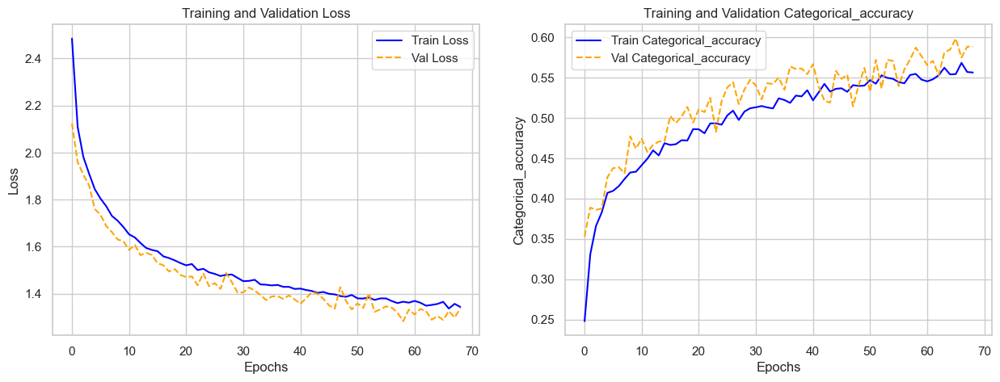

In [108]:
plot_history(history, "categorical_accuracy")

### Résultats itérations 4 :

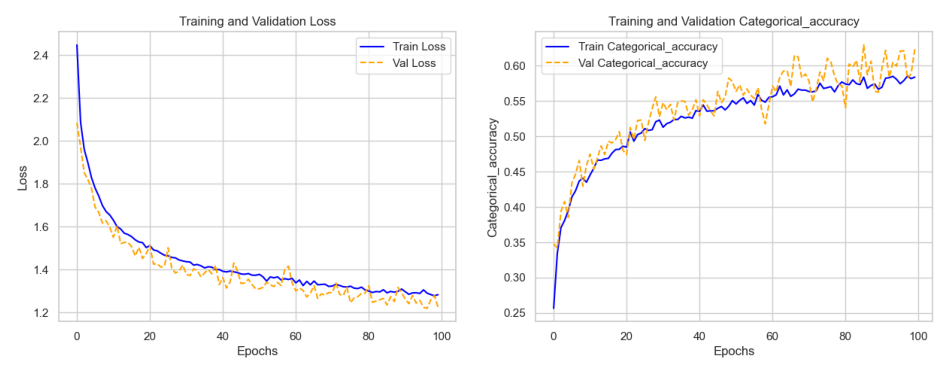

In [109]:
image = mpimg.imread("outputs/conv_04.png")
plt.figure(figsize=(12, 6))
plt.imshow(image)
plt.axis("off")
plt.show()

Les courbes de perte d'entrainement et de validation se suivent et n'atteignent pas de plateau.  
Le modèle semble donc ne pas avoir terminé d'apprendre au bout des 100 epochs définies comme limite d'apprentissage.  
Il pourrait être envisagée d'augmenter le nombre d'épochs si aucune autre approche n'apporte de résultats plus rapides.  
Cependant après 100 epochs le score sur le jeu de test est à 0.63% ce qui est une nette diminution de la performance par rapport aux approches précédentes.

# Gridsearch
A partir des modèles précédents on sélectionne les élèments ayant apportés des améliorations pour la préparation d'une gridsearch pour rechercher les meilleurs hyperparamètres du modèle.

* BatchNormalization() :  
Elle permet d'accélérer la phase d'apprentissage en normalisant l'entrée de chaque couche. Cela aide à éviter le problème de "disparition du gradient".
En normalisant les entrées, elle rend le réseau plus stable.
La normalisation réduit le risque que des taux d'apprentissage élevés déstabilisent le processus d'apprentissage.
Elle rend le modèle moins sensible aux choix des initialisations de poids.
* kernel_regularizer=l2(0.01) :  
La régularisation L2 a pour effet de pénaliser les grandes valeurs des poids du modèle pendant l'entraînement, ce qui aide à prévenir l'overfitting. Cela encourage le modèle à apprendre des poids plus petits, ce qui peut mener à un modèle plus simple et plus généralisable.
* Dropout :  
Cela force le réseau à ne pas dépendre fortement d'aucun ensemble spécifique de neurones, encourageant ainsi une meilleure généralisation et réduisant le risque de surajustement aux données d'entraînement.
* MaxPooling2D, réduit la dimension :  
Moins de paramètres sont nécessaires dans les couches suivantes, ce qui réduit la charge computationnelle.
Il aide à rendre le modèle plus résistant aux petites variations dans la position des features dans le signal d'entrée. En réduisant le nombre de paramètres d'apprentissage, il aide à prévenir l'overfitting.
Avec (2,2) on réduit la taille de moitié sans perdre trop d'information spatiale.
* Architecture croissante des filtres des couches de convolution (32,64,128) :  
On tente de capter des informations de plus en plus complexes à chaque étape. Les premières couches se concentrent sur les signaux forts tandisque que les suivantes tentent de discerner des différences dans les informations plus complexes.  
* L'ajout de padding='same' :  
Dans les couches Conv2D cela est nécessaire pour maintenir la dimension spatiale de la sortie similaire à celle de l'entrée. Sans cela, la taille des données réduites par les couches convolutives et MaxPooling  devient trop petite pour les couches suivantes, menant à des erreurs.


In [110]:
# def grid_model(
#     optimizer="adam",
#     n_filters_1=32,
#     kernel_size_1=(3, 3),
#     n_filters_2=64,
#     kernel_size_2=(3, 3),
#     n_filters_3=128,
#     kernel_size_3=(3, 3),
#     dense_size=128,
#     dense_dropout_rate=0.5,
# ):
#     model = Sequential()
#     input_shape = X_train_padded[0].shape
#     # 1
#     model.add(
#         Conv2D(
#             n_filters_1,
#             kernel_size_1,
#             activation="relu",
#             input_shape=input_shape,
#         )
#     )
#     model.add(BatchNormalization())
#     model.add(MaxPooling2D((2, 2)))
#     model.add(Dropout(0.25))
#     # 2
#     model.add(Conv2D(n_filters_2, kernel_size_2, activation="relu", padding="same"))
#     model.add(BatchNormalization())
#     model.add(MaxPooling2D((2, 2)))
#     model.add(Dropout(0.25))
#     # 3
#     model.add(Conv2D(n_filters_3, kernel_size_3, activation="relu", padding="same"))
#     model.add(BatchNormalization())
#     model.add(MaxPooling2D((2, 2)))
#     model.add(Dropout(0.25))
#     # Dense
#     model.add(Flatten())
#     model.add(Dense(dense_size, activation="relu", kernel_regularizer=l2(0.01)))
#     model.add(Dropout(dense_dropout_rate))
#     model.add(Dense(10, activation="softmax"))

#     model.compile(
#         optimizer=optimizer,
#         loss="categorical_crossentropy",
#         metrics=["categorical_accuracy"],
#     )
#     return model

In [111]:
# nb_epochs = 60
# batch_size = 32

Un batch_size trop grand peut conduire à une convergence prématurée, tandis qu'un batch_size trop petit peut rendre l'entraînement instable.  
 Ce paramètre a un fort impact sur les performances des modèles mais aussi sur la rapidité d'éxécution.

In [112]:
# param_grid = {
#     "model__optimizer": ["adam"],  # ["adam", "sgd", "rmsprop"],
#     "model__n_filters_1": [32],
#     "model__kernel_size_1": [(3, 3)], # [(3,3),(5,5)],
#     "model__n_filters_2": [64],
#     "model__kernel_size_2": [(3, 3)],
#     "model__n_filters_3": [64],
#     "model__kernel_size_3": [(3, 3)],
#     "model__dense_size": [128],
#     "model__dense_dropout_rate": [0.3, 0.5],
# }

In [113]:
# cb = [
#     callbacks.EarlyStopping(
#         monitor="val_loss",
#         patience=5,  # Nombre d'époques sans amélioration après lesquelles l'entraînement sera arrêté
#         mode="min",  # La surveillance s'attend à une diminution de la métrique
#         verbose=1,
#         restore_best_weights=True,
#     ),
#     # callbacks.ModelCheckpoint(
#     #     filepath="modelsav/convgrid/model.{epoch:02d}-{val_loss:.2f}",
#     #     monitor="val_loss",
#     #     verbose=1,
#     #     save_best_only=True,  # Sauvegarde uniquement le meilleur modèle
#     #     mode="min",  # 'min' pour minimiser la métrique, 'max' pour maximiser
#     # ),
#     # callbacks.TensorBoard("logs", histogram_freq=1),
# ]

In [114]:
# # Créer l'instance KerasClassifier
# grid_model_cls = KerasClassifier(
#     model=grid_model,
#     verbose=1,
# )

In [115]:
# grid_model_cls.get_params()

In [116]:
# # Configuration de GridSearchCV
# grid = GridSearchCV(
#     estimator=grid_model_cls,
#     param_grid=param_grid,
#     cv=2,
#     verbose=1,
# )
# history = grid.fit(
#     X_train_padded,
#     y_train,
#     epochs=nb_epochs,
#     batch_size=batch_size,
#     validation_data=(X_val_padded, y_val),
#     callbacks=cb,
# )

In [117]:
# history

In [118]:
# print("Meilleur: %f en utilisant %s" % (history.best_score_, history.best_params_))

Meilleur: 0.836833 en utilisant {'model__dense_dropout_rate': 0.3, 'model__dense_size': 128, 'model__kernel_size_1': (3, 3), 'model__kernel_size_2': (3, 3), 'model__kernel_size_3': (3, 3), 'model__n_filters_1': 32, 'model__n_filters_2': 64, 'model__n_filters_3': 64, 'model__optimizer': 'adam'}

# Best model

In [119]:
def create_best_model(X_train):
    model = Sequential()
    input_shape = X_train[0].shape
    # 1
    model.add(
        Conv2D(
            32,
            (3, 3),
            activation="relu",
            input_shape=input_shape,
        )
    )
    model.add(BatchNormalization())
    model.add(MaxPooling2D((2, 2)))
    model.add(Dropout(0.25))
    # 2
    model.add(Conv2D(64, (3, 3), activation="relu", padding="same"))
    model.add(BatchNormalization())
    model.add(MaxPooling2D((2, 2)))
    model.add(Dropout(0.25))
    # 3
    model.add(Conv2D(128, (3, 3), activation="relu", padding="same"))
    model.add(BatchNormalization())
    model.add(MaxPooling2D((2, 2)))
    model.add(Dropout(0.25))
    # Dense
    model.add(Flatten())
    model.add(Dense(128, activation="relu", kernel_regularizer=l2(0.01)))
    model.add(Dropout(0.3))
    model.add(Dense(10, activation="softmax"))

    model.compile(
        optimizer="adam",
        loss="categorical_crossentropy",
        metrics=["categorical_accuracy"],
    )
    return model

In [120]:
nb_epochs = 200
batch_size = 32

In [121]:
cb = [
    callbacks.EarlyStopping(
        monitor="val_loss",
        patience=10,  # Nombre d'époques sans amélioration après lesquelles l'entraînement sera arrêté
        mode="min",  # La surveillance s'attend à une diminution de la métrique
        verbose=1,
        restore_best_weights=True,
    ),
    callbacks.ModelCheckpoint(
        filepath="modelsav/best/model.{epoch:02d}-{val_loss:.2f}-{val_categorical_accuracy:.2f}",
        monitor="val_loss",
        verbose=1,
        save_best_only=True,  # Sauvegarde uniquement le meilleur modèle
        mode="min",  # 'min' pour minimiser la métrique, 'max' pour maximiser
    ),
    # callbacks.TensorBoard("logs", histogram_freq=1),
]

In [122]:
best_model = create_best_model(X_train_padded)
best_model.summary()

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_8 (Conv2D)           (None, 18, 343, 32)       320       
                                                                 
 batch_normalization_3 (Bat  (None, 18, 343, 32)       128       
 chNormalization)                                                
                                                                 
 max_pooling2d_7 (MaxPoolin  (None, 9, 171, 32)        0         
 g2D)                                                            
                                                                 
 dropout_7 (Dropout)         (None, 9, 171, 32)        0         
                                                                 
 conv2d_9 (Conv2D)           (None, 9, 171, 64)        18496     
                                                                 
 batch_normalization_4 (Bat  (None, 9, 171, 64)       

In [123]:
history = best_model.fit(
    X_train_padded,
    y_train,
    epochs=nb_epochs,
    batch_size=batch_size,
    validation_data=(X_val_padded, y_val),
    callbacks=cb,
)

Epoch 1/200
160/160 [==============================] - ETA: 0s - loss: 4.1725 - categorical_accuracy: 0.2587
Epoch 1: val_loss improved from inf to 2.73036, saving model to modelsav/best\model.01-2.73-0.42
INFO:tensorflow:Assets written to: modelsav/best\model.01-2.73-0.42\assets


INFO:tensorflow:Assets written to: modelsav/best\model.01-2.73-0.42\assets


160/160 [==============================] - 41s 242ms/step - loss: 4.1725 - categorical_accuracy: 0.2587 - val_loss: 2.7304 - val_categorical_accuracy: 0.4247
Epoch 2/200
160/160 [==============================] - ETA: 0s - loss: 2.5184 - categorical_accuracy: 0.3640
Epoch 2: val_loss improved from 2.73036 to 2.38858, saving model to modelsav/best\model.02-2.39-0.45
INFO:tensorflow:Assets written to: modelsav/best\model.02-2.39-0.45\assets


INFO:tensorflow:Assets written to: modelsav/best\model.02-2.39-0.45\assets


160/160 [==============================] - 42s 262ms/step - loss: 2.5184 - categorical_accuracy: 0.3640 - val_loss: 2.3886 - val_categorical_accuracy: 0.4459
Epoch 3/200
160/160 [==============================] - ETA: 0s - loss: 2.1575 - categorical_accuracy: 0.4152
Epoch 3: val_loss improved from 2.38858 to 2.34744, saving model to modelsav/best\model.03-2.35-0.48
INFO:tensorflow:Assets written to: modelsav/best\model.03-2.35-0.48\assets


INFO:tensorflow:Assets written to: modelsav/best\model.03-2.35-0.48\assets


160/160 [==============================] - 40s 252ms/step - loss: 2.1575 - categorical_accuracy: 0.4152 - val_loss: 2.3474 - val_categorical_accuracy: 0.4835
Epoch 4/200
160/160 [==============================] - ETA: 0s - loss: 1.9668 - categorical_accuracy: 0.4903
Epoch 4: val_loss improved from 2.34744 to 1.62809, saving model to modelsav/best\model.04-1.63-0.62
INFO:tensorflow:Assets written to: modelsav/best\model.04-1.63-0.62\assets


INFO:tensorflow:Assets written to: modelsav/best\model.04-1.63-0.62\assets


160/160 [==============================] - 38s 236ms/step - loss: 1.9668 - categorical_accuracy: 0.4903 - val_loss: 1.6281 - val_categorical_accuracy: 0.6171
Epoch 5/200
160/160 [==============================] - ETA: 0s - loss: 1.7712 - categorical_accuracy: 0.5446
Epoch 5: val_loss did not improve from 1.62809
160/160 [==============================] - 36s 223ms/step - loss: 1.7712 - categorical_accuracy: 0.5446 - val_loss: 1.8262 - val_categorical_accuracy: 0.5859
Epoch 6/200
160/160 [==============================] - ETA: 0s - loss: 1.7009 - categorical_accuracy: 0.6076
Epoch 6: val_loss did not improve from 1.62809
160/160 [==============================] - 37s 230ms/step - loss: 1.7009 - categorical_accuracy: 0.6076 - val_loss: 1.9087 - val_categorical_accuracy: 0.6653
Epoch 7/200
160/160 [==============================] - ETA: 0s - loss: 1.7099 - categorical_accuracy: 0.6458
Epoch 7: val_loss improved from 1.62809 to 1.43568, saving model to modelsav/best\model.07-1.44-0.74
INFO

INFO:tensorflow:Assets written to: modelsav/best\model.07-1.44-0.74\assets


160/160 [==============================] - 39s 244ms/step - loss: 1.7099 - categorical_accuracy: 0.6458 - val_loss: 1.4357 - val_categorical_accuracy: 0.7388
Epoch 8/200
160/160 [==============================] - ETA: 0s - loss: 1.6042 - categorical_accuracy: 0.6944
Epoch 8: val_loss did not improve from 1.43568
160/160 [==============================] - 38s 240ms/step - loss: 1.6042 - categorical_accuracy: 0.6944 - val_loss: 1.5128 - val_categorical_accuracy: 0.7512
Epoch 9/200
160/160 [==============================] - ETA: 0s - loss: 1.6203 - categorical_accuracy: 0.7264
Epoch 9: val_loss did not improve from 1.43568
160/160 [==============================] - 39s 242ms/step - loss: 1.6203 - categorical_accuracy: 0.7264 - val_loss: 1.5860 - val_categorical_accuracy: 0.7765
Epoch 10/200
160/160 [==============================] - ETA: 0s - loss: 1.6649 - categorical_accuracy: 0.7480
Epoch 10: val_loss did not improve from 1.43568
160/160 [==============================] - 36s 227ms/ste

In [124]:
clean_models("modelsav/best/")

Supprimé : modelsav/best\model.01-2.73-0.42\
Supprimé : modelsav/best\model.02-2.39-0.45\
Supprimé : modelsav/best\model.03-2.35-0.48\
Supprimé : modelsav/best\model.04-1.63-0.62\


In [125]:
best_model.evaluate(X_test_padded, y_test)

54/54 [==============================] - 3s 52ms/step - loss: 1.5769 - categorical_accuracy: 0.7212


[1.5768588781356812, 0.7211764454841614]

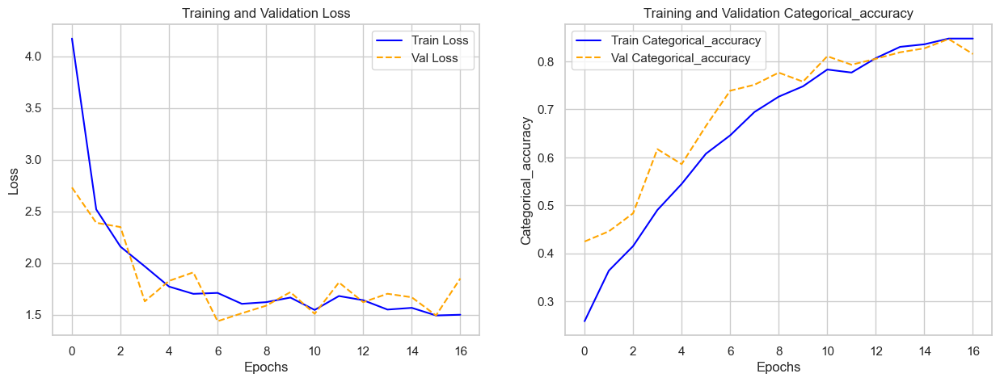

In [126]:
plot_history(history, "categorical_accuracy")

### Résultats best model

In [22]:
best_model_loaded = load_model("modelsav/best_sav/model.41-1.13-0.90")
best_model_loaded.summary()

Model: "sequential_17"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_41 (Conv2D)          (None, 18, 343, 32)       320       
                                                                 
 batch_normalization_36 (Ba  (None, 18, 343, 32)       128       
 tchNormalization)                                               
                                                                 
 max_pooling2d_40 (MaxPooli  (None, 9, 171, 32)        0         
 ng2D)                                                           
                                                                 
 dropout_43 (Dropout)        (None, 9, 171, 32)        0         
                                                                 
 conv2d_42 (Conv2D)          (None, 9, 171, 64)        18496     
                                                                 
 batch_normalization_37 (Ba  (None, 9, 171, 64)      

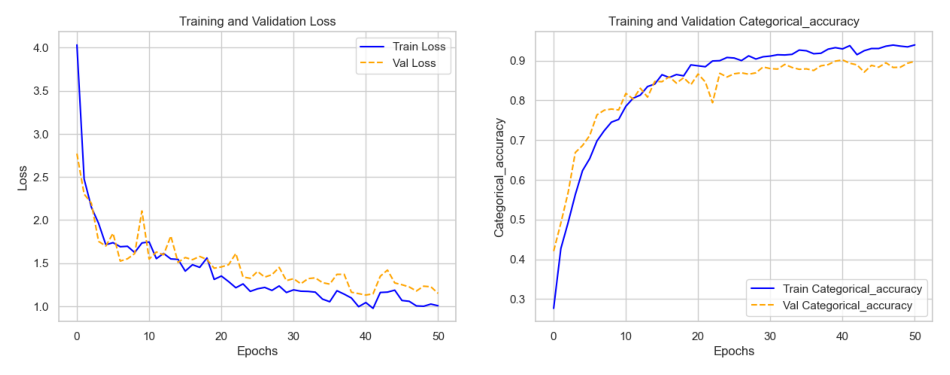

In [128]:
image = mpimg.imread("outputs/best_01.png")
plt.figure(figsize=(12, 6))
plt.imshow(image)
plt.axis("off")
plt.show()

Les courbes de perte sur l'entrainement et la validation se suivent.  
Il ne semble pas y avoir paticulièrement d'overfitting bien que la courbe de validation se détache légèrement de la courbe d'entrainement.  
Le modèle apprends donc suffisament correctement.  
On voit que le paramètre d'arrêt s'est déclenché car la perte ne diminiuait plus cependant il pourrait être envisagé de relancer ce modèle sur d'avantage d'epochs.  
**Actuellement une 50aine d'epochs on obtiens un score amélioré sur le jeu de test avec 0.89% de précision.**  

Il est intéressant de noter que la première approche avec le dataset ayant mes MFCC moyennés et un réseau de neuronnes dense semble compétitif avec un temps d'exécution bien inférieur.

# Tester avec de nouveaux sons
    Sauvegarder votre meilleur modèle.
    Utiliser votre meilleur modèle avec vos propres sons et avec des sons téléchargés. 

Un exemple des différents types de son a été téléchargé depuis : https://freesound.org/

In [25]:
def afficher_graphiques_et_sons(base_path):
    files = os.listdir(base_path)

    wav_files = [file for file in files if file.endswith(".wav")]

    for filename in wav_files:
        file_path = f"{base_path}/{filename}"
        y, sr = librosa.load(file_path)

        print(f"Fichier: {filename}")

        # Afficher le graphique
        plt.figure(figsize=(10, 4))
        librosa.display.waveshow(y, sr=sr)
        plt.xlabel("Temps (s)")
        plt.ylabel("Amplitude")
        plt.show()

        # Jouer l'audio
        display(ipd.Audio(file_path))

Fichier: 146254__ferdinger__jack_hammer_1.wav


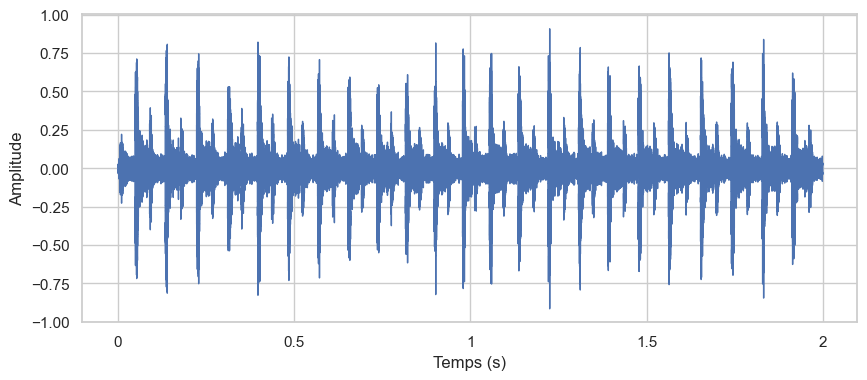

Fichier: 156200__lau7__children_1.wav


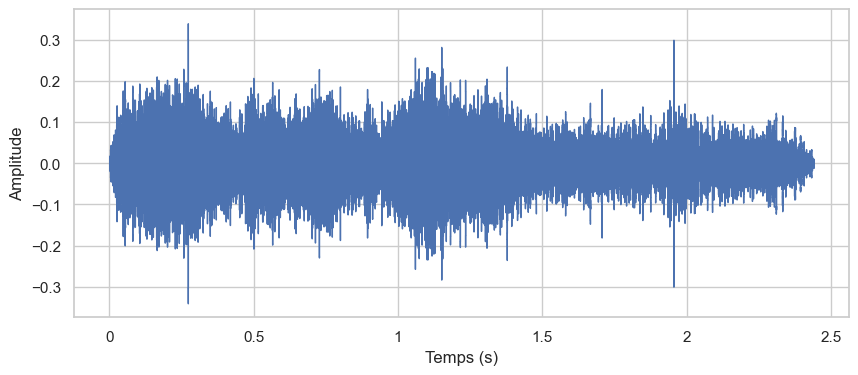

Fichier: 163459__littlebigsounds__lbs_fx-dog-small-alert-bark001.wav


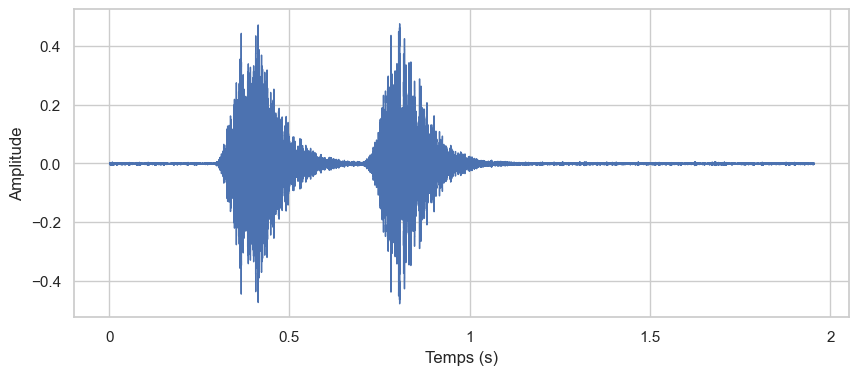

Fichier: 170245__beatsbycasper__air-conditioner.wav


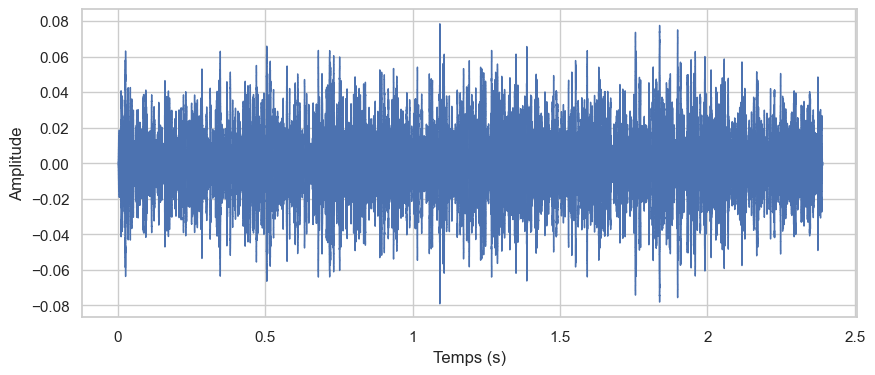

Fichier: 417345__inspectorj__gunshot-distant-a.wav


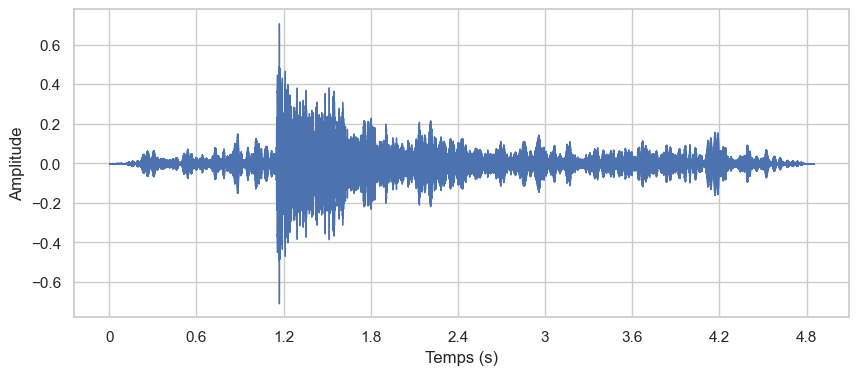

Fichier: 419698__14fvaltrovat__short-horn.wav


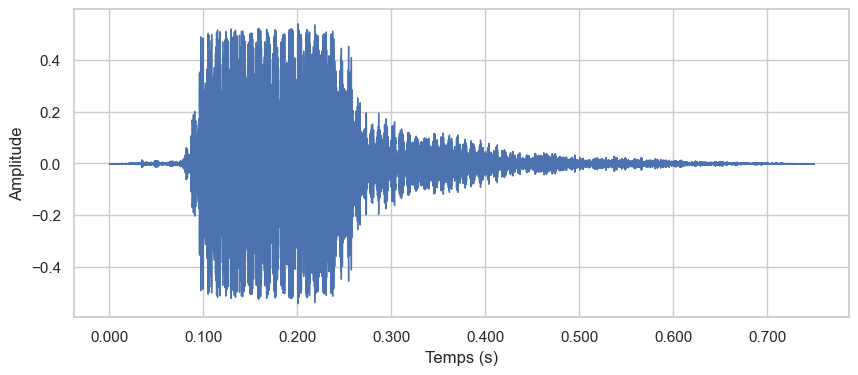

Fichier: 564878__sieuamthanh__nhip-nhat-0.wav


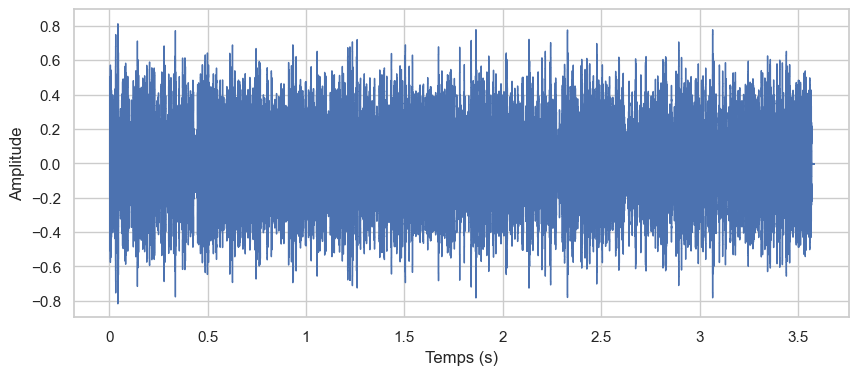

Fichier: 70938__guitarguy1985__police2.wav


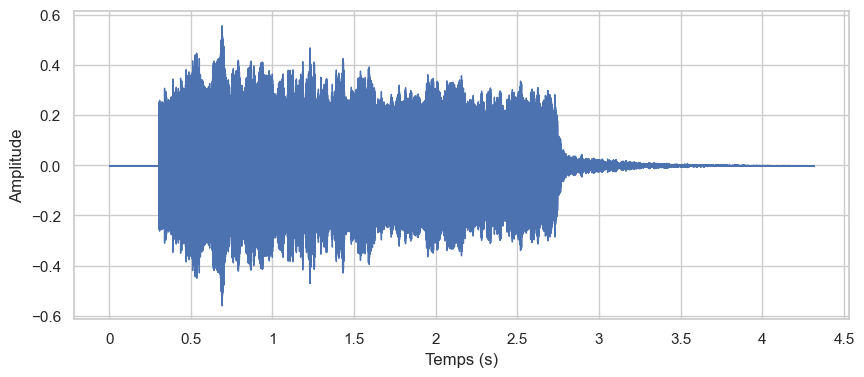

Fichier: 714062__lauri_lehtonen__motorcycle_20.wav


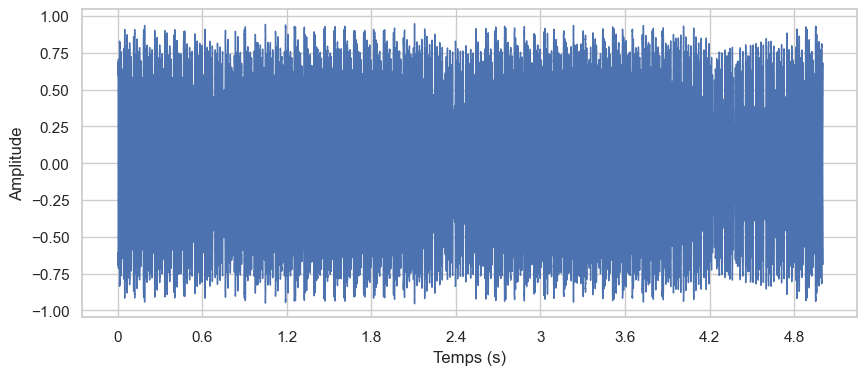

In [28]:
afficher_graphiques_et_sons("datas/audio_new")

In [ ]:
def creer_dataframes_mfcc(base_folder):
    mfcc_data_full = []

    for filename in os.listdir(base_folder):
        if filename.endswith(".wav"):
            file_path = os.path.join(base_folder, filename)
            y, sr = librosa.load(file_path, sr=44100, mono=True) # Même traitement que pour le modèle
            mfcc = librosa.feature.mfcc(y=y, sr=sr)

            # Le label est le nom du fichier sans l'extension
            class_id = filename.split(".")[0]

            mfcc_data_full.append([mfcc, class_id])

    mfcc_full = pd.DataFrame(mfcc_data_full, columns=["MFCC", "Label"])

    return mfcc_full


# Exemple d'utilisation
base_folder = "datas/audio_new"
mfcc_full_new = creer_dataframes_mfcc(base_folder)

In [31]:
mfcc_full_new

,MFCC,Label
0,"[[-128.68228, -100.15413, -139.69933, -94.8655...",146254__ferdinger__jack_hammer_1
1,"[[-361.5074, -285.90204, -242.38246, -225.4405...",156200__lau7__children_1
2,"[[-571.78174, -553.7025, -550.17834, -548.4034...",163459__littlebigsounds__lbs_fx-dog-small-aler...
3,"[[-471.4617, -409.29272, -374.0576, -389.42825...",170245__beatsbycasper__air-conditioner
4,"[[-609.2308, -603.65247, -597.1172, -591.8291,...",417345__inspectorj__gunshot-distant-a
5,"[[-617.9276, -597.4562, -506.67917, -451.4443,...",419698__14fvaltrovat__short-horn
6,"[[-133.37865, -131.35632, -149.21521, -140.523...",564878__sieuamthanh__nhip-nhat-0
7,"[[-565.778, -565.778, -565.778, -565.778, -565...",70938__guitarguy1985__police2
8,"[[-109.893364, -142.87244, -193.6669, -208.683...",714062__lauri_lehtonen__motorcycle_20


In [50]:
def predire_et_afficher_labels(df_mfcc, modele, class_dict):
    for _, row in df_mfcc.iterrows():
        mfcc = row["MFCC"]
        mfcc_padded = np.zeros((20, 345))
        # Vérifier la taille du son et tronque ou padded
        if mfcc.shape[1] > 345:
            mfcc_padded[:, :345] = mfcc[:, :345]
        else:
            mfcc_padded[:, : mfcc.shape[1]] = mfcc

        # Ajouter les dimensions supplémentaires nécessaires
        mfcc_padded = np.expand_dims(mfcc_padded, axis=0)
        mfcc_padded = np.expand_dims(mfcc_padded, axis=-1)

        # Prédiction
        prediction = modele.predict(mfcc_padded)
        predicted_class_index = np.argmax(prediction, axis=1)[
            0
        ]  # indice de la classe prédite
        predicted_class_name = class_dict[
            predicted_class_index
        ]  # nom de la classe correspondant

        # Affichage
        print(f"Fichier: {row['Label']}, Classe prédite: {predicted_class_name}")

In [40]:
best_model_loaded = load_model("modelsav/best_sav/model.41-1.13-0.90")

In [51]:
# Prédiction
predire_et_afficher_labels(mfcc_full_new, best_model_loaded, class_dict)

1/1 [==============================] - 0s 25ms/step
Fichier: 146254__ferdinger__jack_hammer_1, Classe prédite: jackhammer
1/1 [==============================] - 0s 25ms/step


Fichier: 156200__lau7__children_1, Classe prédite: car_horn
1/1 [==============================] - 0s 29ms/step
Fichier: 163459__littlebigsounds__lbs_fx-dog-small-alert-bark001, Classe prédite: dog_bark
1/1 [==============================] - 0s 28ms/step
Fichier: 170245__beatsbycasper__air-conditioner, Classe prédite: air_conditioner
1/1 [==============================] - 0s 28ms/step
Fichier: 417345__inspectorj__gunshot-distant-a, Classe prédite: dog_bark
1/1 [==============================] - 0s 31ms/step
Fichier: 419698__14fvaltrovat__short-horn, Classe prédite: car_horn
1/1 [==============================] - 0s 26ms/step
Fichier: 564878__sieuamthanh__nhip-nhat-0, Classe prédite: street_music
1/1 [==============================] - 0s 28ms/step
Fichier: 70938__guitarguy1985__police2, Classe prédite: dog_bark
1/1 [==============================] - 0s 26ms/step
Fichier: 714062__lauri_lehtonen__motorcycle_20, Classe prédite: engine_idling


On observe que pour ces extraits de sons : 6 sons sur les 9 sont correctement identifiés.

# (Bonus) Augmentation de données
    Se poser la question de l'augmentation de données : quels procédés auraient du sens ? Comment les implémenter ? Le faire concrètement avec votre meilleur modèle et regarder si cela améliore ses performances.

Il pourrait être envisager plusieurs techniques de modifications des fichiers pour obtenir des variations de sons sans altérer la capacité d'apprentissage du modèle :
* Modifier la vitesse de lecture des enregistrements.
* Ajouter du bruit de fond.
* Appliquer des décalages temporels.
* Modifier la hauteur des sons : en rendant les son plus graves ou plus aigus on ne modifie pas nécessairement leur nature.

In [ ]:
# 14h20

In [ ]:
from datetime import datetime

# Obtenir l'heure actuelle
heure_actuelle = datetime.now()

# Afficher l'heure
print("Heure de fin:", heure_actuelle.strftime("%H:%M:%S"))

Heure de fin: 15:09:46
